<a href="https://colab.research.google.com/github/ardominguezm/tda-ricci-euler-global-markets/blob/main/Revised_Paper_Ricci_Euler_RMT_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#1- Paper TDA Global Stock Market

Este es uno de los articulos derivados de la investigación doctoral. El objetivo es investigar si algunos descriptores topológicos y geométricos pueden capturar los cambios estructurales en la dinámica del mercado financiero global durante la pandemia que sirvan como potenciales indicadores de riesgo sistémico.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
# Navigate to your folder
os.chdir('/content/drive/MyDrive/Paper-TDA-GlobalStockMarket')

# List files in the folder
print(os.listdir())

['stock_indices_data', 'updated_global_stock_indices_data_final.xlsx', 'Datos-GlobalStockMarket.ipynb', 'raw_global_stock_indices_data_final.xlsx', '.ipynb_checkpoints', 'clean_global_stock_indices_data.xlsx', 'log_returns_global_stock_indices_data.xlsx', 'correlation_matrices_2017_2022.xlsx', 'community_graphs.eps', 'community_graphs.pdf', 'Paper-TDA-Global-Stocks-Market.ipynb', 'TDA-persistent-correlation-.ipynb', 'FRL-D-25-01099.pdf', 'Notebook_Paper_Ricci_Euler_RMT.ipynb']


In [3]:
import pandas as pd
import numpy as np

import pandas as pd

# Load the data from the user's uploaded file
file_path = '/content/drive/MyDrive/Paper-TDA-GlobalStockMarket/raw_global_stock_indices_data_final.xlsx'
data = pd.read_excel(file_path)

# Check the basic structure of the data
data_info = {
    "columns": data.columns.tolist(),
    "number_of_rows": len(data),
    "NA_counts_per_column": data.isna().sum().to_dict()
}

# Display initial structure information
data_info

{'columns': ['Date',
  'Singapore',
  'Japan',
  'United Kingdom',
  'Russia',
  'Jordan',
  'Switzerland',
  'Hungary',
  'Malaysia',
  'Croatia',
  'Spain',
  'Poland',
  'Germany',
  'Finland',
  'Portugal',
  'Netherlands',
  'France',
  'Indonesia',
  'Denmark',
  'Pakistan',
  'Belgium',
  'Italy',
  'Ireland',
  'Turkey',
  'Norway',
  'Qatar',
  'South Korea',
  'Austria',
  'Chile',
  'Canada',
  'Czech',
  'Australia',
  'China',
  'Romania',
  'Argentina',
  'Brazil',
  'United States',
  'Hong Kong',
  'Mexico',
  'Israel',
  'Peru',
  'New Zealand',
  'Taiwan',
  'India'],
 'number_of_rows': 1765,
 'NA_counts_per_column': {'Date': 0,
  'Singapore': 261,
  'Japan': 300,
  'United Kingdom': 251,
  'Russia': 288,
  'Jordan': 896,
  'Switzerland': 267,
  'Hungary': 633,
  'Malaysia': 301,
  'Croatia': 1092,
  'Spain': 231,
  'Poland': 626,
  'Germany': 246,
  'Finland': 263,
  'Portugal': 241,
  'Netherlands': 229,
  'France': 229,
  'Indonesia': 306,
  'Denmark': 283,
  'Paki

In [4]:
# Count the number of NA values per row to identify dates with high numbers of missing values
data['NA_Count'] = data.isna().sum(axis=1)

# Define a threshold for high NA count per row (e.g., 20% of columns with NA would mean at least 8 columns with missing values)
# Since we have 43 columns (including the Date column), 20% would be approximately 8 missing values
row_na_threshold = int(0.20 * (len(data.columns) - 1))

# Filter out rows where NA count exceeds the threshold
filtered_data = data[data['NA_Count'] <= row_na_threshold].drop(columns=['NA_Count'])

# Check the shape of the filtered data to see how many rows were removed
filtered_data_shape = filtered_data.shape
filtered_data_shape


(1139, 44)

In [5]:
data

,Date,Singapore,Japan,United Kingdom,Russia,Jordan,Switzerland,Hungary,Malaysia,Croatia,...,Brazil,United States,Hong Kong,Mexico,Israel,Peru,New Zealand,Taiwan,India,NA_Count
0,2017-01-03,2898.969971,NaN,7177.899902,2285.429932,4069.399902,8316.179688,32169.130859,1635.530029,2025.189941,...,61814.0,2257.830078,22150.400391,46123.359375,1285.439941,15827.43,NaN,9272.879883,26643.240234,2
1,2017-01-04,2921.310059,19594.160156,7189.700195,2263.899902,4065.699951,8354.809570,32649.039062,1647.469971,2022.979980,...,61589.0,2270.750000,22134.470703,46587.738281,1287.770020,15970.50,6974.310059,9286.959961,26633.130859,0
2,2017-01-05,2954.139893,19520.689453,7195.299805,2220.350098,4077.199951,8392.490234,32750.000000,1659.819946,2030.280029,...,62071.0,2269.000000,22456.689453,46719.988281,1290.660034,16036.09,6975.600098,9358.139648,26878.240234,0
3,2017-01-06,2962.629883,19454.330078,7210.100098,2213.929932,NaN,8417.459961,32855.871094,1675.489990,NaN,...,61665.0,2276.979980,22503.009766,46071.570312,NaN,15984.81,6970.660156,9372.219727,26759.230469,7
4,2017-01-09,2981.540039,NaN,7237.799805,2211.250000,4075.899902,8424.860352,32854.261719,1667.900024,2036.130005,...,61700.0,2268.899902,22558.689453,45553.511719,1284.239990,16044.74,7012.740234,9342.419922,26726.550781,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1760,2022-12-26,NaN,26405.869141,NaN,2139.209961,NaN,NaN,NaN,NaN,NaN,...,108738.0,NaN,NaN,50273.890625,1787.170044,21168.78,NaN,14285.129883,60566.421875,30
1761,2022-12-27,3266.379883,26447.869141,NaN,2150.919922,NaN,10839.219727,NaN,1474.689941,NaN,...,108347.0,3829.250000,NaN,50440.019531,1799.750000,21347.23,NaN,14328.429688,60927.429688,15
1762,2022-12-28,3266.969971,26340.500000,7497.200195,2139.770020,NaN,10812.669922,NaN,1480.109985,NaN,...,110237.0,3783.219971,19898.910156,49648.210938,1803.150024,21302.55,11567.690430,14173.099609,60910.281250,9
1763,2022-12-29,3249.239990,26093.669922,7512.700195,2147.060059,NaN,10857.349609,NaN,1491.630005,NaN,...,110031.0,3849.280029,19741.140625,49517.859375,1813.349976,21333.82,11591.929688,14085.019531,61133.878906,9


In [6]:
filtered_data

,Date,Singapore,Japan,United Kingdom,Russia,Jordan,Switzerland,Hungary,Malaysia,Croatia,...,Argentina,Brazil,United States,Hong Kong,Mexico,Israel,Peru,New Zealand,Taiwan,India
0,2017-01-03,2898.969971,NaN,7177.899902,2285.429932,4069.399902,8316.179688,32169.130859,1635.530029,2025.189941,...,17911.0,61814.0,2257.830078,22150.400391,46123.359375,1285.439941,15827.43,NaN,9272.879883,26643.240234
1,2017-01-04,2921.310059,19594.160156,7189.700195,2263.899902,4065.699951,8354.809570,32649.039062,1647.469971,2022.979980,...,18143.0,61589.0,2270.750000,22134.470703,46587.738281,1287.770020,15970.50,6974.310059,9286.959961,26633.130859
2,2017-01-05,2954.139893,19520.689453,7195.299805,2220.350098,4077.199951,8392.490234,32750.000000,1659.819946,2030.280029,...,18223.0,62071.0,2269.000000,22456.689453,46719.988281,1290.660034,16036.09,6975.600098,9358.139648,26878.240234
3,2017-01-06,2962.629883,19454.330078,7210.100098,2213.929932,NaN,8417.459961,32855.871094,1675.489990,NaN,...,18284.0,61665.0,2276.979980,22503.009766,46071.570312,NaN,15984.81,6970.660156,9372.219727,26759.230469
4,2017-01-09,2981.540039,NaN,7237.799805,2211.250000,4075.899902,8424.860352,32854.261719,1667.900024,2036.130005,...,18510.0,61700.0,2268.899902,22558.689453,45553.511719,1284.239990,16044.74,7012.740234,9342.419922,26726.550781
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1361,2021-08-31,3055.050049,28089.539062,7119.700195,3918.959961,4024.840088,12411.110352,51969.671875,NaN,NaN,...,76452.0,118781.0,4522.680176,25878.990234,53304.738281,1818.530029,17653.54,13218.830078,17490.289062,57552.390625
1362,2021-09-01,3087.840088,28451.019531,7149.799805,3971.020020,4012.060059,12432.790039,51946.960938,1586.890015,NaN,...,75233.0,119396.0,4524.089844,26028.289062,52215.539062,1827.260010,17572.35,13243.490234,17473.990234,57338.210938
1363,2021-09-02,3088.840088,28543.509766,7163.899902,3990.770020,4026.239990,12432.459961,51830.238281,1582.189941,NaN,...,75115.0,116677.0,4536.950195,26090.429688,52087.468750,1824.109985,17508.38,13280.469727,17319.759766,57852.539062
1364,2021-09-03,3083.850098,29128.109375,7138.399902,4001.699951,NaN,12351.839844,52255.109375,1589.189941,NaN,...,74735.0,116933.0,4535.430176,25901.990234,51835.089844,NaN,17678.74,13288.870117,17516.919922,58129.949219


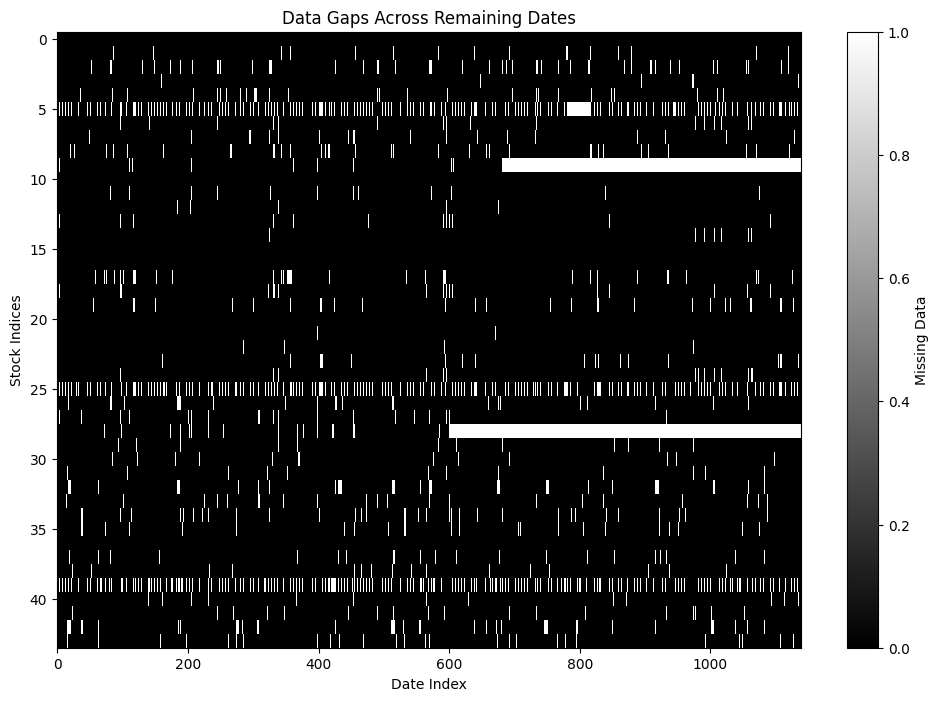

In [7]:
import matplotlib.pyplot as plt

# Create a visualization of the data gaps across remaining dates
plt.figure(figsize=(12, 8))
plt.imshow(filtered_data.isna().T, aspect='auto', cmap='gray', interpolation='none')
plt.colorbar(label='Missing Data')
plt.xlabel("Date Index")
plt.ylabel("Stock Indices")
plt.title("Data Gaps Across Remaining Dates")
plt.show()


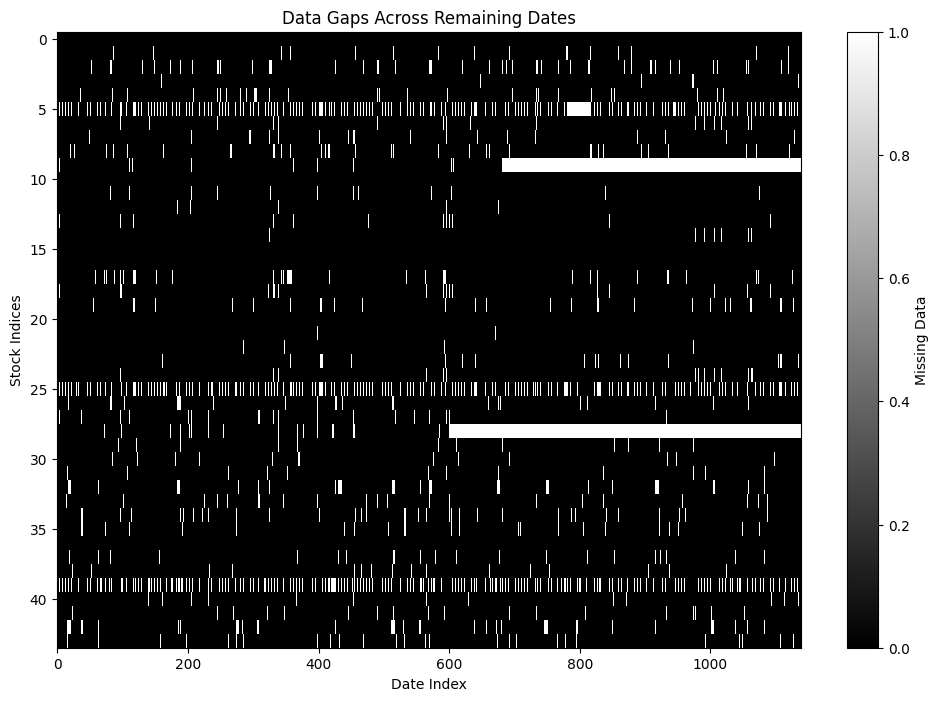

In [8]:
import matplotlib.pyplot as plt

# Create a visualization of the data gaps across remaining dates
plt.figure(figsize=(12, 8))
plt.imshow(filtered_data.isna().T, aspect='auto', cmap='gray', interpolation='none')
plt.colorbar(label='Missing Data')
plt.xlabel("Date Index")
plt.ylabel("Stock Indices")
plt.title("Data Gaps Across Remaining Dates")
plt.show()

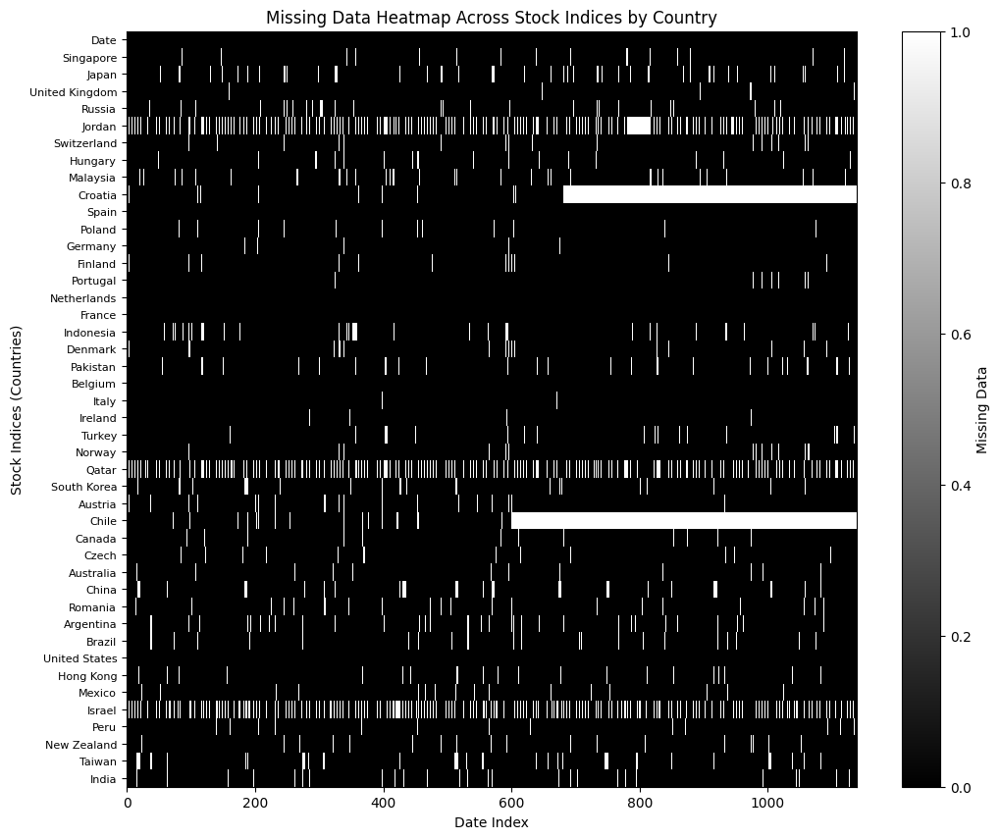

In [9]:
# Generate a heatmap of missing values with country names on the y-axis
plt.figure(figsize=(12, 10))
plt.imshow(filtered_data.isna().T, aspect='auto', cmap='gray', interpolation='none')
plt.colorbar(label='Missing Data')
plt.xlabel("Date Index")
plt.ylabel("Stock Indices (Countries)")
plt.yticks(ticks=range(len(filtered_data.columns)), labels=filtered_data.columns, fontsize=8)
plt.title("Missing Data Heatmap Across Stock Indices by Country")
plt.show()

In [10]:
!pip install openpyxl


<Figure size 1600x1000 with 0 Axes>

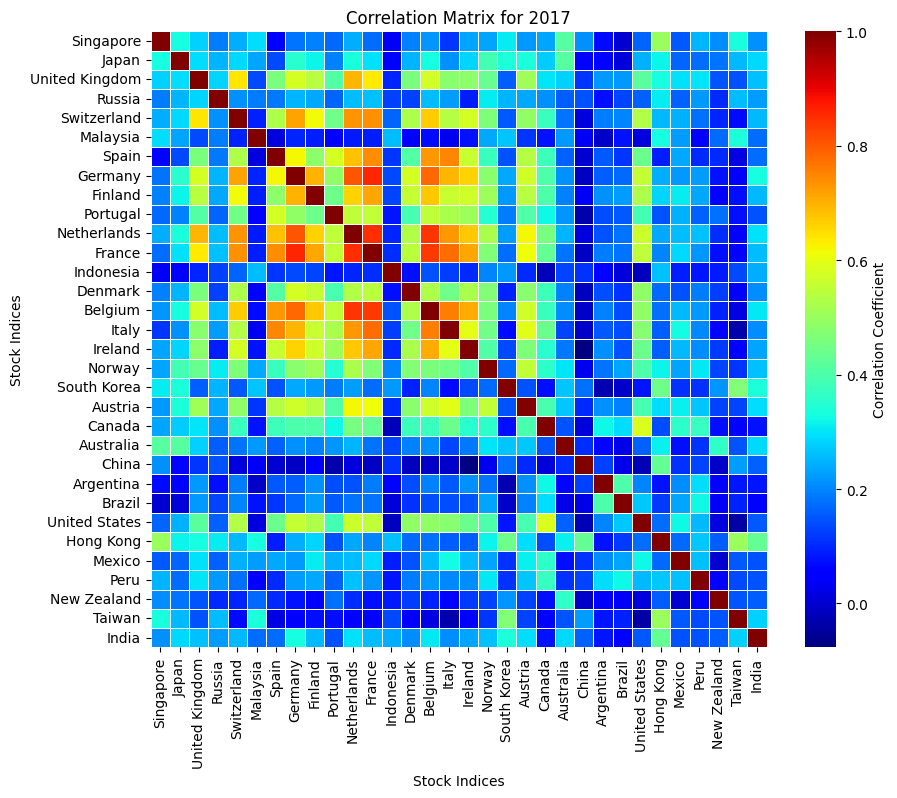

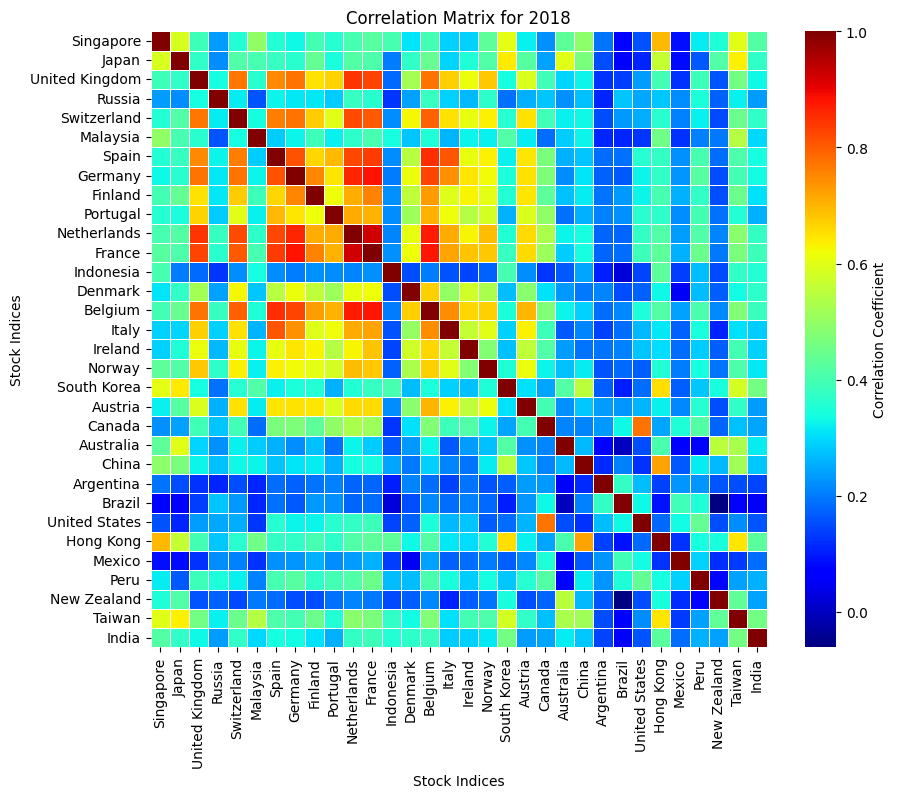

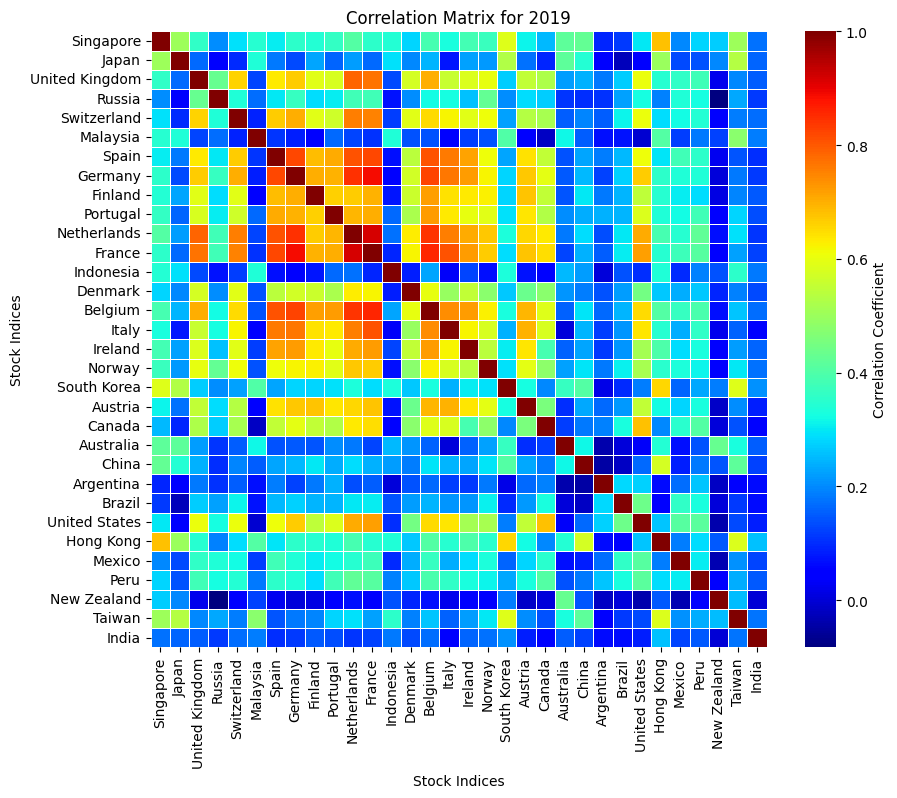

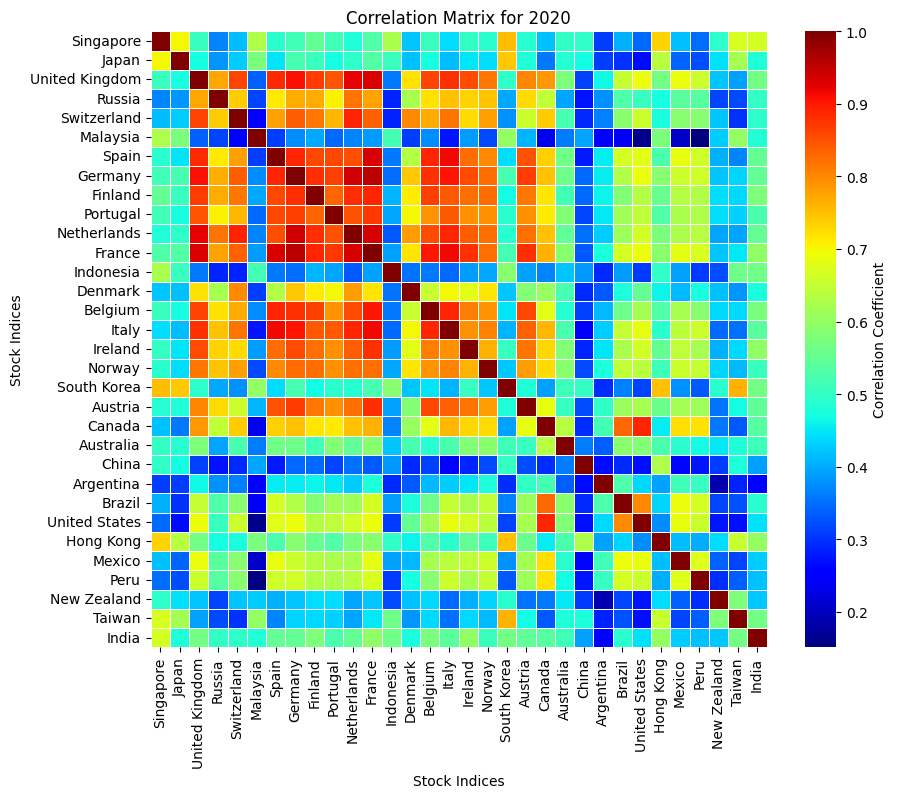

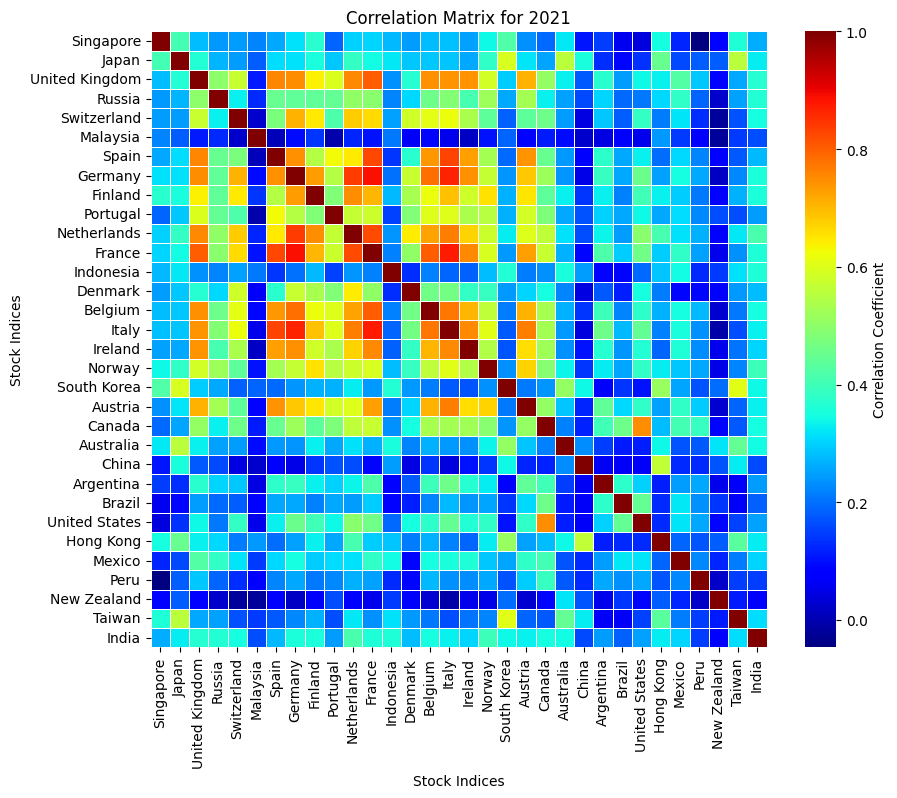

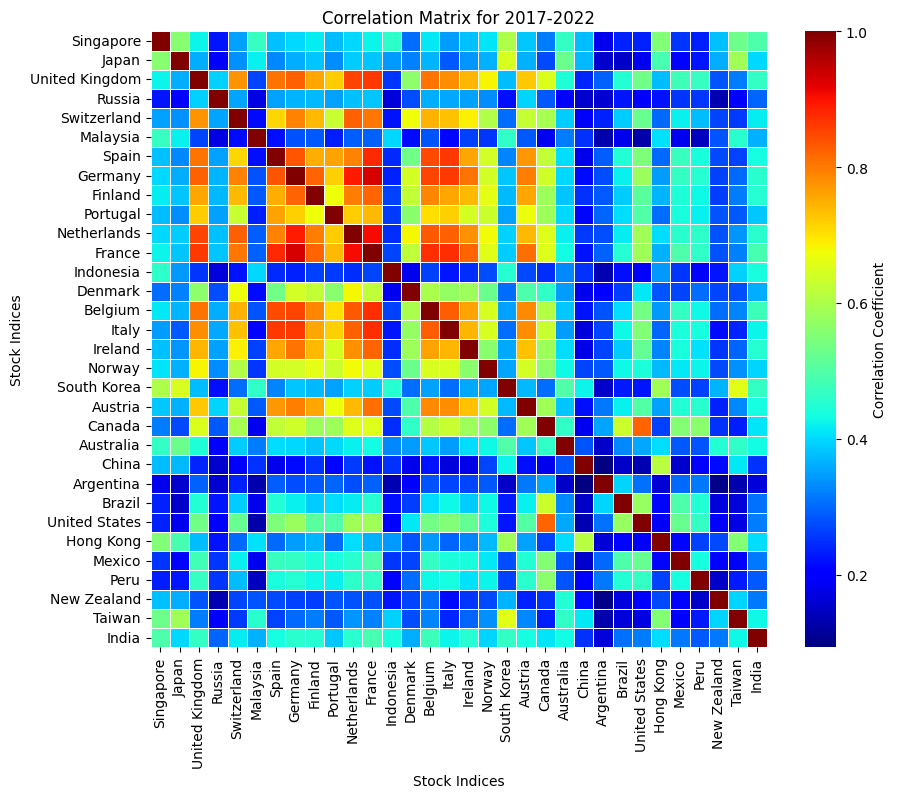

In [14]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import openpyxl

file_path = '/content/drive/MyDrive/Paper-TDA-GlobalStockMarket/correlation_matrices_2017_2022.xlsx'  # Update the path if necessary
years_of_interest = list(range(2017, 2022))

# Set up a color map and parameters for consistent visual style
cmap = 'jet'
plt.figure(figsize=(16, 10))

# Plot each yearly correlation matrix and the full period correlation matrix
for year in years_of_interest + ['2017-2022']:
    # Read the data for the current year from the corresponding sheet
    if year == '2017-2022':
        # Assume '2017-2022' is a separate sheet name for the full period
        correlation_matrix = pd.read_excel(file_path, sheet_name=year, index_col=0)  # Set the first column as index
    else:
        correlation_matrix = pd.read_excel(file_path, sheet_name=str(year), index_col=0)  # Set the first column as index

    # Remove any non-numeric columns or rows if they exist
    correlation_matrix = correlation_matrix.select_dtypes(include=['number'])

    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, cmap=cmap, annot=False, square=True, cbar=True,
                cbar_kws={'label': 'Correlation Coefficient'}, linewidths=0.5)
    plt.title(f'Correlation Matrix for {year}')
    plt.xlabel('Stock Indices')
    plt.ylabel('Stock Indices')
    plt.show()

#Paises ordenados por Regiones

<Figure size 1600x1000 with 0 Axes>

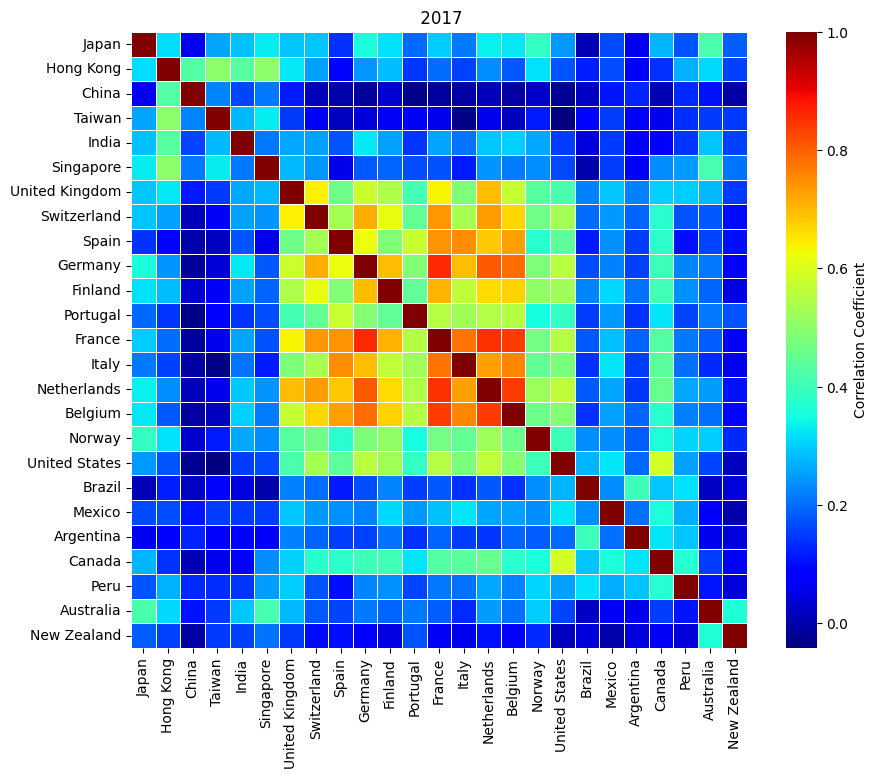

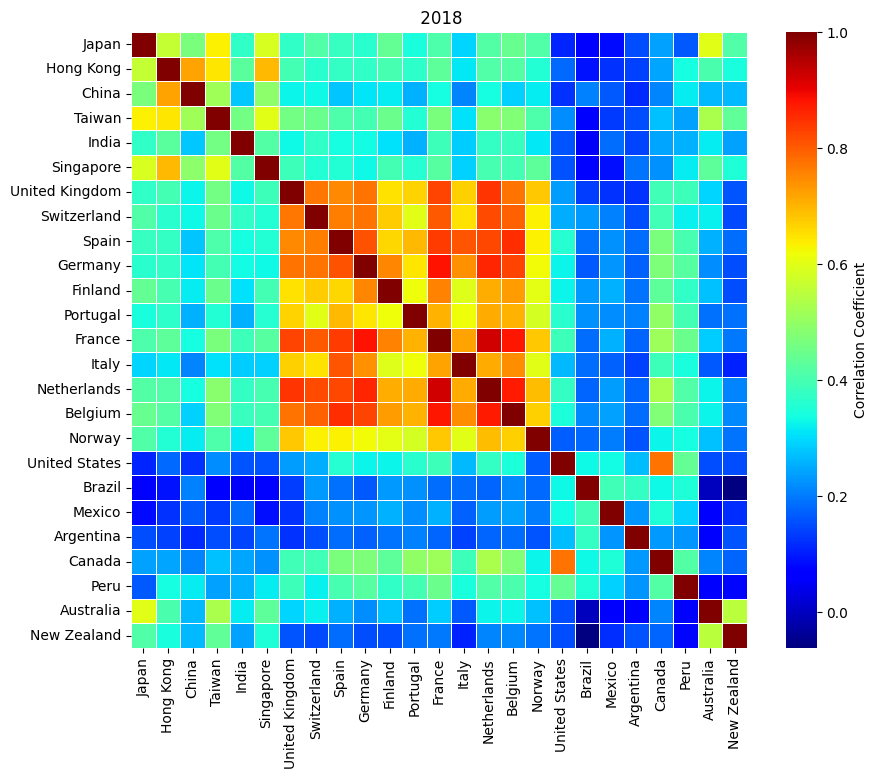

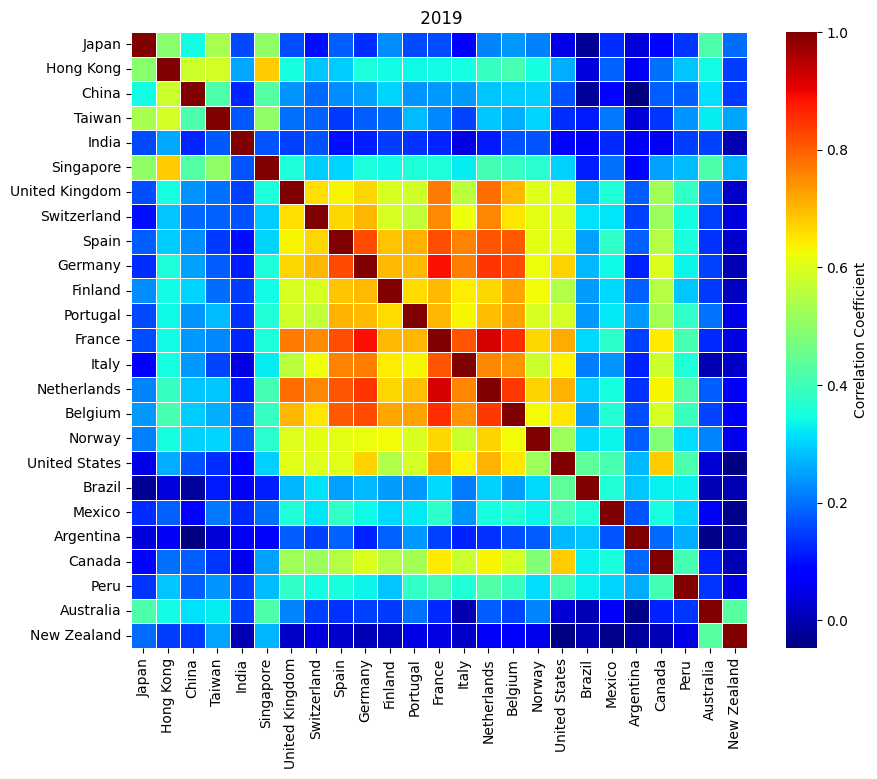

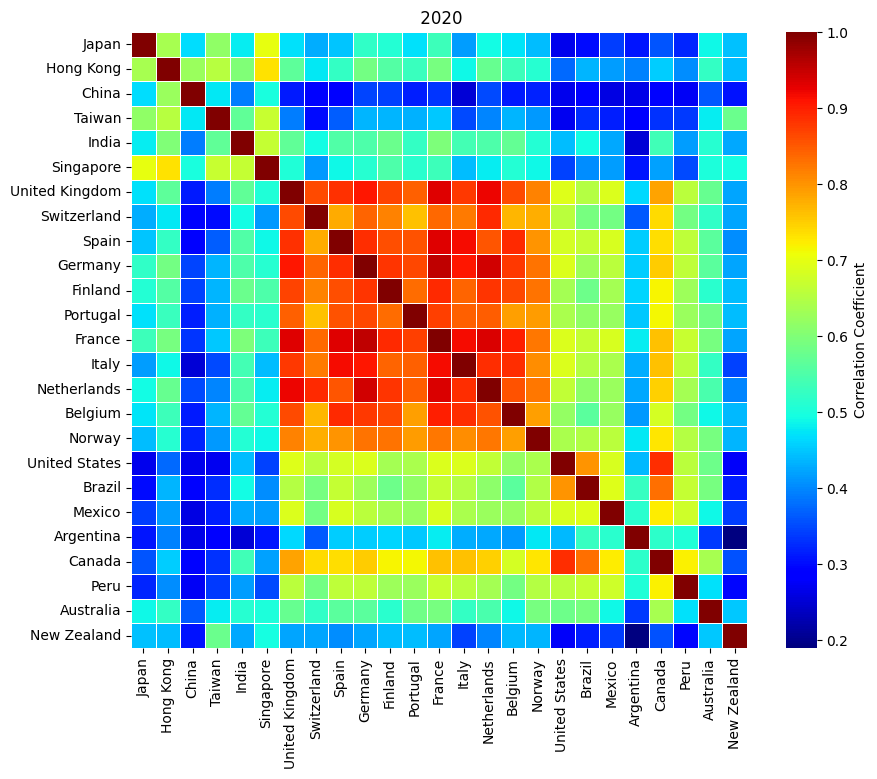

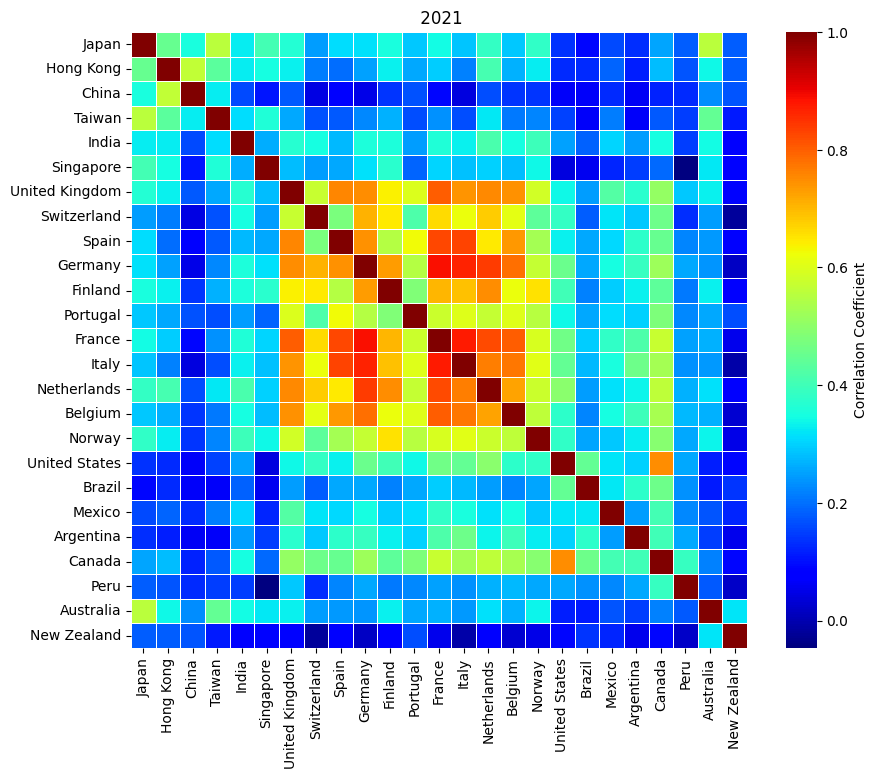

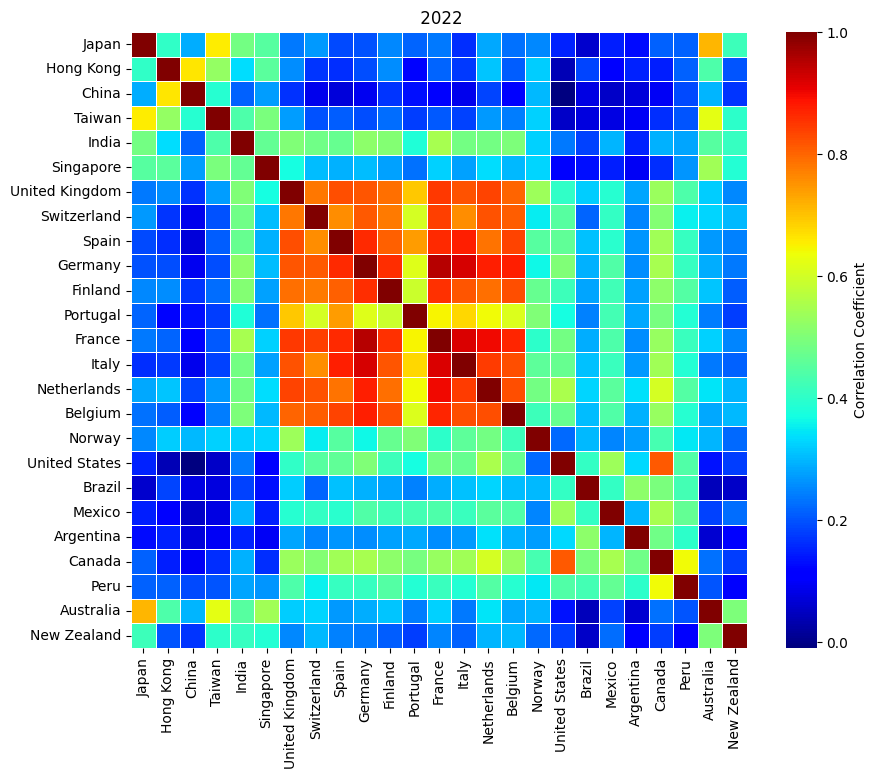

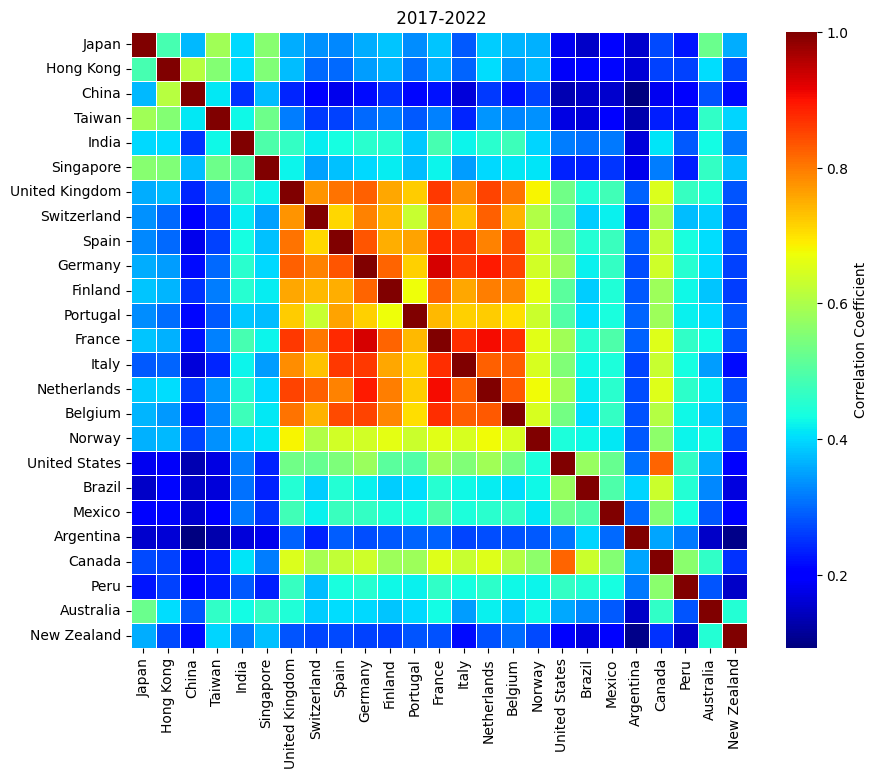

In [16]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import openpyxl

file_path = '/content/drive/MyDrive/Paper-TDA-GlobalStockMarket/correlation_matrices_2017_2022.xlsx'  # Actualiza la ruta si es necesario
years_of_interest = list(range(2017, 2023))

# Definir grupos de países basados en regiones geográficas
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# Combina las listas de cada región para obtener un orden completo
ordered_countries = []
for region, countries in regions.items():
    ordered_countries.extend(countries)

# Configurar el mapa de colores y los parámetros de visualización
cmap = 'jet'
plt.figure(figsize=(16, 10))

# Visualizar cada matriz de correlación anual y la del período completo
for year in years_of_interest + ['2017-2022']:
    # Leer los datos para el año actual desde la hoja correspondiente
    correlation_matrix = pd.read_excel(file_path, sheet_name=str(year), index_col=0)

    # Filtra los países en la matriz para mantener solo los países de la lista ordenada
    available_countries = [country for country in ordered_countries if country in correlation_matrix.columns]
    correlation_matrix = correlation_matrix.reindex(index=available_countries, columns=available_countries)

    # Crear el mapa de calor con la agrupación por región
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, cmap=cmap, annot=False, square=True, cbar=True,
                cbar_kws={'label': 'Correlation Coefficient'}, linewidths=0.5)
    plt.title(f' {year}')
    #plt.xlabel('Stock Indices')
    #plt.ylabel('Stock Indices')
    plt.show()


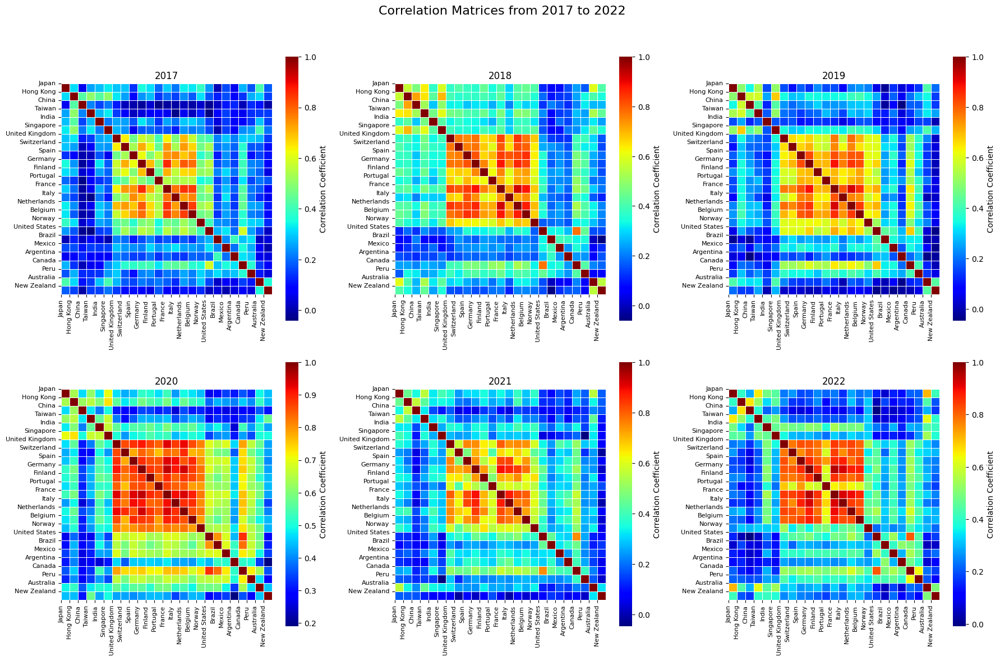

In [ ]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Ruta del archivo de Excel con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'  # Asegúrate de que la ruta sea correcta

# Lista de años de interés (excluyendo el periodo global)
years_of_interest = list(range(2017, 2023))

# Definir grupos de países basados en regiones geográficas
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# Ordenar países según las regiones
ordered_countries = []
for region, countries in regions.items():
    ordered_countries.extend(countries)

# Configuración del mapa de colores para los heatmaps
cmap = 'jet'

# Crear una figura con subplots para las seis matrices
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
fig.suptitle("Correlation Matrices from 2017 to 2022", fontsize=16)

# Visualización de cada matriz de correlación anual
for idx, year in enumerate(years_of_interest):
    # Leer los datos para el año actual desde la hoja correspondiente
    correlation_matrix = pd.read_excel(file_path, sheet_name=str(year), index_col=0)

    # Filtrar y ordenar los países en la matriz
    available_countries = [country for country in ordered_countries if country in correlation_matrix.columns]
    correlation_matrix = correlation_matrix.reindex(index=available_countries, columns=available_countries)

    # Seleccionar el subplot correspondiente
    ax = axes[idx // 3, idx % 3]
    sns.heatmap(correlation_matrix, cmap=cmap, annot=False, square=True, cbar=True,
                cbar_kws={'label': 'Correlation Coefficient'}, linewidths=0.5, ax=ax)
    ax.set_title(f'{year}', fontsize=12)

    # Configurar las etiquetas de ticks en los ejes x e y para que coincidan con los nombres de los países
    ax.set_xticks(range(len(correlation_matrix.columns)))
    ax.set_xticklabels(correlation_matrix.columns, rotation=90, fontsize=8)
    ax.set_yticks(range(len(correlation_matrix.index)))
    ax.set_yticklabels(correlation_matrix.index, rotation=0, fontsize=8)

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


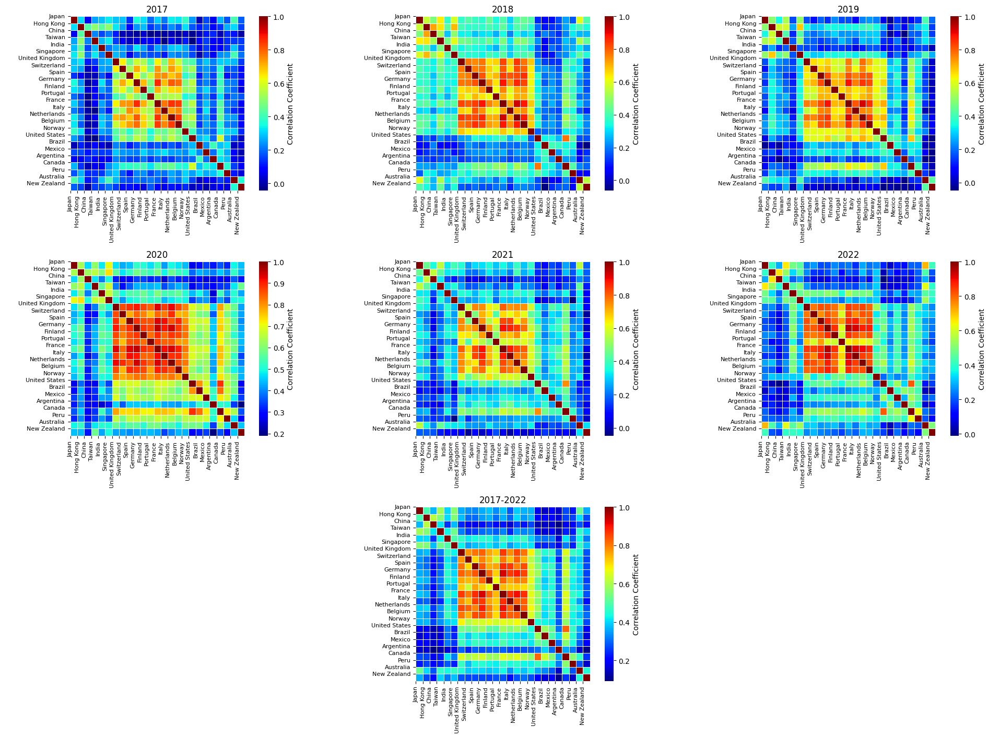

In [17]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Ruta del archivo de Excel con las matrices de correlación
file_path = '/content/drive/MyDrive/Paper-TDA-GlobalStockMarket/correlation_matrices_2017_2022.xlsx'

# Lista de años de interés, incluida la matriz para el periodo global
years_of_interest = list(range(2017, 2023)) + ['2017-2022']

# Definir grupos de países basados en regiones geográficas
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# Ordenar países según las regiones
ordered_countries = []
for region, countries in regions.items():
    ordered_countries.extend(countries)

# Configuración del mapa de colores para los heatmaps
cmap = 'jet'

# Crear una figura con subplots para seis matrices en una cuadrícula de 2x3 y una central para 2017-2022
fig, axes = plt.subplots(3, 3, figsize=(20, 15))
#fig.suptitle("Correlation Matrices from 2017 to 2022 and Global Period (2017-2022)", fontsize=16)

# Visualización de cada matriz de correlación anual
for idx, year in enumerate(years_of_interest):
    # Leer los datos para el año actual desde la hoja correspondiente
    correlation_matrix = pd.read_excel(file_path, sheet_name=str(year), index_col=0)

    # Filtrar y ordenar los países en la matriz
    available_countries = [country for country in ordered_countries if country in correlation_matrix.columns]
    correlation_matrix = correlation_matrix.reindex(index=available_countries, columns=available_countries)

    # Ubicar la matriz de 2017-2022 en el centro
    if year == '2017-2022':
        ax = axes[2, 1]  # Ubicación central inferior
    else:
        ax = axes[idx // 3, idx % 3]

    sns.heatmap(correlation_matrix, cmap=cmap, annot=False, square=True, cbar=True,
                cbar_kws={'label': 'Correlation Coefficient'}, linewidths=0.5, ax=ax)
    ax.set_title(f'{year}', fontsize=12)

    # Configurar las etiquetas de ticks en los ejes x e y para que coincidan con los nombres de los países
    ax.set_xticks(range(len(correlation_matrix.columns)))
    ax.set_xticklabels(correlation_matrix.columns, rotation=90, fontsize=8)
    ax.set_yticks(range(len(correlation_matrix.index)))
    ax.set_yticklabels(correlation_matrix.index, rotation=0, fontsize=8)

# Ocultar los ejes vacíos en los subplots
axes[2, 0].axis('off')
axes[2, 2].axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


# TDA ANALISIS

1. **Paso 1: Generación de Matrices de Distancia**


In [ ]:
import pandas as pd
import numpy as np
import openpyxl

# Ruta de las matrices de correlación agrupadas
file_path = '/content/correlation_matrices_2017_2022.xlsx'
years_of_interest = list(range(2017, 2022))

# Crear diccionario para almacenar matrices de distancia por año
distance_matrices = {}

# Definir la fórmula para calcular la distancia a partir de la correlación
def correlation_to_distance(correlation_matrix):
    return np.sqrt(2 * (1 - correlation_matrix))

# Generar las matrices de distancia para cada año
for year in years_of_interest + ['2017-2022']:
    # Leer la matriz de correlación
    correlation_matrix = pd.read_excel(file_path, sheet_name=str(year), index_col=0)

    # Aplicar la fórmula para convertir a matriz de distancia
    distance_matrix = correlation_to_distance(correlation_matrix)

    # Almacenar la matriz de distancia en el diccionario
    distance_matrices[year] = pd.DataFrame(distance_matrix, index=correlation_matrix.index, columns=correlation_matrix.columns)


FileNotFoundError: [Errno 2] No such file or directory: '/content/correlation_matrices_2017_2022.xlsx'

**Paso 2: Implementar TDA para Homología Persistente**


In [ ]:
!pip install --upgrade gudhi

In [ ]:
import numpy as np

def calculate_persistence_entropy(persistence_diagram):
    """
    Calcula la entropía de persistencia a partir de un diagrama de persistencia.
    :param persistence_diagram: Diagrama de persistencia en formato [(birth, death), ...]
    :return: Entropía de persistencia
    """
    lifetimes = [death - birth for birth, death in persistence_diagram if death > birth]
    total_lifetime = sum(lifetimes)
    if total_lifetime == 0:
        return 0

    probabilities = [lt / total_lifetime for lt in lifetimes]
    entropy = -sum(p * np.log(p) for p in probabilities if p > 0)
    return entropy


In [ ]:
import gudhi
from gudhi import RipsComplex
import matplotlib.pyplot as plt

# Calcular la homología persistente y obtener los diagramas de persistencia
persistence_diagrams = {}
persistence_entropies = {}
betti_numbers = {}

for year, distance_matrix in distance_matrices.items():
    # Construir el complejo de Rips desde la matriz de distancia
    rips = RipsComplex(distance_matrix=distance_matrix.values, max_edge_length=1.0)
    simplex_tree = rips.create_simplex_tree(max_dimension=2)

    # Calcular la homología persistente
    persistence = simplex_tree.persistence()
    persistence_diagrams[year] = simplex_tree.persistence_intervals_in_dimension(1)

    # Visualizar el diagrama de persistencia
    gudhi.plot_persistence_diagram(persistence)
    plt.title(f"Persistence Diagram for {year}")
    plt.show()

    # Calcular la entropía de persistencia manualmente
    entropy = calculate_persistence_entropy(persistence_diagrams[year])
    persistence_entropies[year] = entropy

    # Calcular el número de Betti en cada dimensión
    betti_numbers[year] = simplex_tree.betti_numbers()

    print(persistence_entropies)
    print(betti_numbers)



## 3. **Paso 3: Análisis Geométrico (Curvatura de Ricci y Característica de Euler)**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import os
# Navigate to your folder
os.chdir('/content/drive/MyDrive/Paper-TDA-GlobalStockMarket')

# List files in the folder
print(os.listdir())

['stock_indices_data', 'updated_global_stock_indices_data_final.xlsx', 'Datos-GlobalStockMarket.ipynb', 'raw_global_stock_indices_data_final.xlsx', '.ipynb_checkpoints', 'clean_global_stock_indices_data.xlsx', 'log_returns_global_stock_indices_data.xlsx', 'Paper-TDA-Global-Stocks-Market.ipynb']


In [ ]:
# # colab setting
!pip install GraphRicciCurvature
!pip install scikit-learn


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.7/13.7 MB 75.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 865.6/865.6 kB 38.0 MB/s eta 0:00:00


In [ ]:

import networkx as nx
import numpy as np
import math
import importlib

# matplotlib setting
%matplotlib inline
import matplotlib.pyplot as plt

# to print logs in jupyter notebook
import logging
logging.basicConfig(format='%(levelname)s:%(message)s', level=logging.ERROR)

# load GraphRicciCuravture package
from GraphRicciCurvature.OllivierRicci import OllivierRicci

# load python-louvain for modularity computation
import community as community_louvain

# for ARI computation
from sklearn import preprocessing, metrics


In [ ]:
import networkx as nx
from GraphRicciCurvature.OllivierRicci import OllivierRicci

# Parámetros de umbral
thresholds = [0.2, 0.4, 0.6, 0.8]
euler_characteristics = {}
ricci_curvatures = {}

for year, distance_matrix in distance_matrices.items():
    euler_characteristics[year] = {}
    ricci_curvatures[year] = {}

    for threshold in thresholds:
        # Crear un grafo basado en el umbral de correlación
        graph = nx.Graph()
        for i, row in distance_matrix.iterrows():
            for j, dist in row.items():
                if i != j and distance_matrix.at[i, j] < threshold:
                    graph.add_edge(i, j, weight=dist)

        # Calcular la característica de Euler
       # euler_characteristics[year][threshold] = nx.euler_characteristic(graph)

        # Calcular la curvatura de Ricci
       # orc = OllivierRicci(graph, alpha=0.5, method="OTD")
        #orc.compute_ricci_curvature()
        #ricci_curvatures[year][threshold] = orc.get_ricci_curvature()
orc = OllivierRicci(graph, alpha=0.5, verbose="TRACE")
orc.compute_ricci_curvature()
G_orc = orc.G.copy()


NameError: name 'graph' is not defined

In [ ]:
def show_results(G):
    # Print the first five results
    print("Karate Club Graph, first 5 edges: ")
    for n1,n2 in list(G.edges())[:5]:
        print("Ollivier-Ricci curvature of edge (%s,%s) is %f" % (n1 ,n2, G[n1][n2]["ricciCurvature"]))

    # Plot the histogram of Ricci curvatures
    plt.subplot(2, 1, 1)
    ricci_curvtures = nx.get_edge_attributes(G, "ricciCurvature").values()
    plt.hist(ricci_curvtures,bins=20)
    plt.xlabel('Ricci curvature')
    plt.title("Histogram of Ricci Curvatures (Global Stock Market)")

    # Plot the histogram of edge weights
    plt.subplot(2, 1, 2)
    weights = nx.get_edge_attributes(G, "weight").values()
    plt.hist(weights,bins=20)
    plt.xlabel('Edge weight')
    plt.title("Histogram of Edge weights (Global Stock Market)")

    plt.tight_layout()

show_results(G_orc)

NameError: name 'G_orc' is not defined

In [ ]:
#Start a Ricci flow with Lin-Yau's probability distribution setting with 4 process.
orf = OllivierRicci(graph, alpha=0.5, base=1, exp_power=0, proc=4, verbose="INFO")

# Do Ricci flow for 2 iterations
orf.compute_ricci_flow(iterations=2)

In [ ]:
orf.set_verbose("ERROR") # mute logs
orf.compute_ricci_flow(iterations=50)
G_rf = orf.G.copy()

In [ ]:
show_results(G_rf)


In [ ]:
import networkx as nx
from GraphRicciCurvature.OllivierRicci import OllivierRicci
import numpy as np

# Definir los umbrales
thresholds = [0.2, 0.4, 0.6, 0.8]

# Diccionarios para almacenar las características de Euler y curvaturas de Ricci para cada año y umbral
euler_characteristics = {}
ricci_curvatures = {}

for year, distance_matrix in distance_matrices.items():
    euler_characteristics[year] = {}
    ricci_curvatures[year] = {}

    for threshold in thresholds:
        # Crear el grafo para el año y umbral actual
        graph = nx.Graph()

        # Agregar aristas en función del umbral
        for i, row in distance_matrix.iterrows():
            for j, dist in row.items():
                if i != j and dist < threshold:  # Usar dist en lugar de distance_matrix.at[i, j] para evitar redundancia
                    graph.add_edge(i, j, weight=dist)

        # Comprobación de depuración: Verificar si el grafo tiene nodos y aristas
        if graph.number_of_nodes() == 0 or graph.number_of_edges() == 0:
            print(f"Advertencia: El grafo para el año {year} y umbral {threshold} está vacío.")
            continue  # Saltar esta iteración si el grafo está vacío

        # Calcular la característica de Euler usando la fórmula V - E
        V = graph.number_of_nodes()
        E = graph.number_of_edges()
        euler_characteristics[year][threshold] = V - E

        # Calcular la curvatura de Ricci para el grafo
        orc = OllivierRicci(graph, alpha=0.5, method="OTD", verbose="TRACE")
        orc.compute_ricci_curvature()

        # Guardar la curvatura de Ricci promedio del grafo
        ricci_curvatures[year][threshold] = orc.G

        # Mostrar los resultados para cada año y umbral
        print(f"\nCurvatura de Ricci para el año {year} con umbral {threshold}:")
        # Mostrar la curvatura de Ricci para cada arista
        for (u, v, data) in orc.G.edges(data=True):
            print(f"Curvatura entre {u} y {v}: {data['ricciCurvature']:.4f}")


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Crear un DataFrame con la curvatura de Ricci promedio para cada año y umbral
ricci_avg_df = pd.DataFrame(columns=thresholds, index=distance_matrices.keys())
for year in ricci_curvatures:
    for threshold in ricci_curvatures[year]:
        # Calcular la curvatura de Ricci promedio para el grafo
        avg_ricci = np.mean([data['ricciCurvature'] for _, _, data in ricci_curvatures[year][threshold].edges(data=True)])
        ricci_avg_df.at[year, threshold] = avg_ricci


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Asegurarse de que todos los valores en ricci_avg_df son de tipo float
ricci_avg_df = ricci_avg_df.apply(pd.to_numeric, errors='coerce').astype(float)

# Visualizar la matriz de curvatura de Ricci promedio con un heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(ricci_avg_df, annot=True, cmap="jet", fmt=".2f", mask=ricci_avg_df.isnull())
plt.title("Curvatura de Ricci Promedio por Año y Umbral")
plt.xlabel("Umbral")
plt.ylabel("Año")
plt.show()


In [ ]:
ricci_boxplot_data = {'Año': [], 'Umbral': [], 'Curvatura de Ricci': []}

for year in ricci_curvatures:
    for threshold in ricci_curvatures[year]:
        for _, _, data in ricci_curvatures[year][threshold].edges(data=True):
            ricci_boxplot_data['Año'].append(year)
            ricci_boxplot_data['Umbral'].append(threshold)
            ricci_boxplot_data['Curvatura de Ricci'].append(data['ricciCurvature'])

# Convertir a DataFrame
ricci_boxplot_df = pd.DataFrame(ricci_boxplot_data)

# Crear boxplots
plt.figure(figsize=(14, 8))
sns.boxplot(x='Umbral', y='Curvatura de Ricci', hue='Año', data=ricci_boxplot_df)
plt.title("Distribución de la Curvatura de Ricci por Umbral y Año")
plt.xlabel("Umbral")
plt.ylabel("Curvatura de Ricci")
plt.legend(title="Año", loc="upper right")
plt.show()


In [ ]:
# Gráfico de líneas para la curvatura de Ricci promedio

plt.figure(figsize=(10, 6))
for threshold in thresholds:
    plt.plot(ricci_avg_df.index, ricci_avg_df[threshold], marker='o', label=f'Umbral {threshold}')

plt.title("Curvatura de Ricci Promedio a lo Largo del Tiempo")
plt.xlabel("Año")
plt.ylabel("Curvatura de Ricci Promedio")
plt.legend(title="Umbral")
plt.grid()
plt.show()


In [ ]:
import numpy as np
import pandas as pd

# Definir las regiones y sus países
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# Crear un diccionario para almacenar la curvatura promedio por región, año y umbral
ricci_curvature_per_region = {}

for year in ricci_curvatures:
    ricci_curvature_per_region[year] = {}

    for threshold in ricci_curvatures[year]:
        # Crear un diccionario para almacenar los promedios por región
        region_averages = {}

        # Calcular la curvatura promedio para cada región
        for region, countries in regions.items():
            curvatures = []

            for u, v, data in ricci_curvatures[year][threshold].edges(data=True):
                # Incluir solo las aristas donde ambos nodos pertenecen a la región
                if u in countries and v in countries:
                    curvatures.append(data['ricciCurvature'])

            # Calcular el promedio de curvatura si existen datos para la región
            if curvatures:
                region_averages[region] = np.mean(curvatures)
            else:
                region_averages[region] = np.nan  # Si no hay aristas, asignar NaN

        # Almacenar el promedio de curvatura por región para el umbral actual
        ricci_curvature_per_region[year][threshold] = region_averages

# Convertir a un DataFrame para visualizar mejor
ricci_curvature_df = pd.DataFrame(
    {(year, threshold): pd.Series(regions_data)
     for year, thresholds_data in ricci_curvature_per_region.items()
     for threshold, regions_data in thresholds_data.items()}
).T

ricci_curvature_df.index.names = ["Año", "Umbral"]

# Mostrar la tabla de curvaturas de Ricci promedio por región, año y umbral
ricci_curvature_df


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Crear un DataFrame con la característica de Euler para cada año y umbral
euler_df = pd.DataFrame(columns=thresholds, index=distance_matrices.keys())

for year in euler_characteristics:
    for threshold in euler_characteristics[year]:
        euler_df.at[year, threshold] = euler_characteristics[year][threshold]

# Asegurarse de que los datos sean de tipo float para el mapa de calor
euler_df = euler_df.astype(float)

# Visualizar la característica de Euler en un mapa de calor
plt.figure(figsize=(10, 6))
sns.heatmap(euler_df, annot=True, cmap="YlGnBu", fmt=".1f")
plt.title("Característica de Euler por Año y Umbral")
plt.xlabel("Umbral")
plt.ylabel("Año")
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar el estilo del gráfico
sns.set(style="whitegrid")

# Iterar sobre cada región y crear un gráfico de barras para la curvatura de Ricci promedio
for region in ricci_curvature_df.columns:
    plt.figure(figsize=(12, 6))

    # Extraer los datos para la región actual
    region_data = ricci_curvature_df[region].unstack(level='Umbral')

    # Crear el gráfico de barras agrupado para cada umbral en cada año
    region_data.plot(kind='bar', figsize=(12, 6), width=0.8)

    # Configuración del gráfico
    plt.title(f"Curvatura de Ricci Promedio para la Región {region} por Año y Umbral")
    plt.xlabel("Año")
    plt.ylabel("Curvatura de Ricci Promedio")
    plt.legend(title="Umbral")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Configurar el estilo del gráfico
sns.set(style="whitegrid")

# Crear una lista para almacenar los datos en formato largo para facilitar el gráfico
ricci_data = {'Año': [], 'Umbral': [], 'Región': [], 'Curvatura de Ricci Promedio': []}

# Llenar los datos de curvatura de Ricci promedio para cada año, umbral y región
for year in ricci_curvature_per_region:
    for threshold in ricci_curvature_per_region[year]:
        for region, curvature in ricci_curvature_per_region[year][threshold].items():
            ricci_data['Año'].append(year)
            ricci_data['Umbral'].append(threshold)
            ricci_data['Región'].append(region)
            ricci_data['Curvatura de Ricci Promedio'].append(curvature)

# Convertir a DataFrame para facilitar la visualización
ricci_df = pd.DataFrame(ricci_data)

# Crear un gráfico de barras agrupado por región y umbral
plt.figure(figsize=(14, 8))
sns.barplot(data=ricci_df, x='Región', y='Curvatura de Ricci Promedio', hue='Umbral')
plt.title("Curvatura de Ricci Promedio por Región y Umbral")
plt.xlabel("Región")
plt.ylabel("Curvatura de Ricci Promedio")
plt.xticks(rotation=45)
plt.legend(title="Umbral")
plt.tight_layout()
plt.show()


In [ ]:
import networkx as nx
from GraphRicciCurvature.OllivierRicci import OllivierRicci
import numpy as np

# Actualizar los umbrales de distancia que corresponden a correlaciones de 0.1 a 0.9
thresholds = [1.3416, 1.2649, 1.1832, 1.0954, 1.0000, 0.8944, 0.7746, 0.6325, 0.4472]

# Crear un diccionario para almacenar las curvaturas de Ricci por año y umbral
ricci_curvatures_by_threshold = {}

for year, distance_matrix in distance_matrices.items():
    ricci_curvatures_by_threshold[year] = {}

    for threshold in thresholds:
        # Crear un grafo solo con aristas que tienen una distancia menor que el umbral
        graph = nx.Graph()

        for i, row in distance_matrix.iterrows():
            for j, dist in row.items():
                if i != j and dist < threshold:
                    graph.add_edge(i, j, weight=dist)

        # Verificar que el grafo no esté vacío antes de calcular la curvatura
        if graph.number_of_edges() == 0:
            print(f"No edges for year {year} and threshold {threshold}")
            ricci_curvatures_by_threshold[year][threshold] = np.nan
            continue

        # Calcular la curvatura de Ricci para el grafo
        orc = OllivierRicci(graph, alpha=0.5, method="OTD", verbose="TRACE")
        orc.compute_ricci_curvature()

        # Extraer la curvatura de Ricci para cada arista y calcular el promedio
        avg_ricci_curvature = np.mean([data['ricciCurvature'] for _, _, data in orc.G.edges(data=True)])
        ricci_curvatures_by_threshold[year][threshold] = avg_ricci_curvature

        print(f"Average Ricci curvature for year {year} with threshold {threshold}: {avg_ricci_curvature:.4f}")


In [ ]:
import matplotlib.pyplot as plt

# Convertir los umbrales de distancia a correlación
def distance_to_correlation(distance):
    return 1 - (distance**2) / 2

# Crear listas para almacenar los datos en formato adecuado para el gráfico
correlation_thresholds = []
ricci_curvatures_list = []
years_list = []

# Llenar los datos para cada año y umbral
for year in ricci_curvatures_by_threshold:
    for threshold, avg_curvature in ricci_curvatures_by_threshold[year].items():
        # Convertir el umbral de distancia a umbral de correlación
        correlation_threshold = distance_to_correlation(threshold)
        correlation_thresholds.append(correlation_threshold)
        ricci_curvatures_list.append(avg_curvature)
        years_list.append(year)

# Crear un DataFrame para facilitar la visualización
ricci_df = pd.DataFrame({
    'Año': years_list,
    'Correlación': correlation_thresholds,
    'Curvatura de Ricci Promedio': ricci_curvatures_list
})

# Graficar la curvatura de Ricci promedio para cada año a lo largo de los umbrales de correlación
plt.figure(figsize=(12, 6))
for year in ricci_df['Año'].unique():
    year_data = ricci_df[ricci_df['Año'] == year]
    plt.plot(year_data['Correlación'], year_data['Curvatura de Ricci Promedio'], marker='o', label=f'Año {year}')

# Configuración del gráfico
plt.title("Curvatura de Ricci Promedio a lo Largo de los Umbrales de Correlación")
plt.xlabel("Umbral de Correlación")
plt.ylabel("Curvatura de Ricci Promedio")
plt.legend(title="Año")
plt.grid(True)
plt.show()


## ANALISIS DE RICCI Y EULER DESDE AQUI

In [ ]:
# # colab setting
!pip install GraphRicciCurvature
!pip install scikit-learn


In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
from GraphRicciCurvature.OllivierRicci import OllivierRicci

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Crear un diccionario para almacenar las medias de correlación y la curvatura de Ricci para cada año
average_correlations = {}
ricci_curvatures_by_year = {}

# Función para convertir correlación a distancia
def correlation_to_distance(correlation):
    return np.sqrt(2 * (1 - correlation))

# Iterar sobre cada año y calcular la media de correlación, umbral de distancia, y curvatura de Ricci
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación para el año
    avg_correlation = correlation_matrix.mean().mean()  # Promedio de todos los valores en la matriz
    average_correlations[year] = avg_correlation

    # Convertir la media de correlación a un umbral de distancia
    distance_threshold = correlation_to_distance(avg_correlation)

    # Crear el grafo solo con aristas que tienen una distancia menor que el umbral
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:
                distance = correlation_to_distance(correlation)
                if distance < distance_threshold:
                    graph.add_edge(i, j, weight=distance)

    # Verificar que el grafo no esté vacío antes de calcular la curvatura
    if graph.number_of_edges() == 0:
        print(f"No edges for year {year} with threshold based on avg correlation")
        ricci_curvatures_by_year[year] = np.nan
        continue

    # Calcular la curvatura de Ricci para el grafo
    orc = OllivierRicci(graph, alpha=0.5, method="OTD", verbose="TRACE")
    orc.compute_ricci_curvature()

    # Extraer la curvatura de Ricci para cada arista y calcular el promedio
    avg_ricci_curvature = np.mean([data['ricciCurvature'] for _, _, data in orc.G.edges(data=True)])
    ricci_curvatures_by_year[year] = avg_ricci_curvature

    # Mostrar el resultado
    print(f"Año {year}: Media de Correlación = {avg_correlation:.4f}, Umbral de Distancia = {distance_threshold:.4f}, Curvatura de Ricci Promedio = {avg_ricci_curvature:.4f}")

# Resultado final de las curvaturas de Ricci promedio por año
ricci_curvatures_by_year, average_correlations


TRACE:GraphRicciCurvature:Number of nodes: 31
TRACE:GraphRicciCurvature:Number of edges: 175
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.001633 secs for all pair by NetworKit.
INFO:GraphRicciCurvature:0.117397 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 181
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.006265 secs for all pair by NetworKit.


Año 2017: Media de Correlación = 0.2868, Umbral de Distancia = 1.1943, Curvatura de Ricci Promedio = 0.3386


INFO:GraphRicciCurvature:0.122533 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 185
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.000369 secs for all pair by NetworKit.


Año 2018: Media de Correlación = 0.3843, Umbral de Distancia = 1.1097, Curvatura de Ricci Promedio = 0.3248


INFO:GraphRicciCurvature:0.121665 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 31
TRACE:GraphRicciCurvature:Number of edges: 217
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.000346 secs for all pair by NetworKit.


Año 2019: Media de Correlación = 0.3432, Umbral de Distancia = 1.1461, Curvatura de Ricci Promedio = 0.3519


INFO:GraphRicciCurvature:0.130472 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 184
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.001677 secs for all pair by NetworKit.


Año 2020: Media de Correlación = 0.5681, Umbral de Distancia = 0.9294, Curvatura de Ricci Promedio = 0.4066


INFO:GraphRicciCurvature:0.122909 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 191
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.000289 secs for all pair by NetworKit.


Año 2021: Media de Correlación = 0.3460, Umbral de Distancia = 1.1437, Curvatura de Ricci Promedio = 0.3549


INFO:GraphRicciCurvature:0.141391 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 180
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.001899 secs for all pair by NetworKit.


Año 2022: Media de Correlación = 0.3866, Umbral de Distancia = 1.1076, Curvatura de Ricci Promedio = 0.3762


INFO:GraphRicciCurvature:0.481464 secs for Ricci curvature computation.


Año 2017-2022: Media de Correlación = 0.4363, Umbral de Distancia = 1.0618, Curvatura de Ricci Promedio = 0.3770


({'2017': 0.3386072864008621,
  '2018': 0.32476770564972846,
  '2019': 0.3519135828996235,
  '2020': 0.40656358867527,
  '2021': 0.3548956089565017,
  '2022': 0.376163236994532,
  '2017-2022': 0.3770374999341949},
 {'2017': 0.2868432352225603,
  '2018': 0.38425567265792526,
  '2019': 0.3431718478227247,
  '2020': 0.5680765883190432,
  '2021': 0.34599870498294033,
  '2022': 0.3866380991535033,
  '2017-2022': 0.4362504719331074})

In [ ]:
import pandas as pd

# Convertir los resultados a un DataFrame para facilitar la visualización
results_df = pd.DataFrame({
    "Año": list(ricci_curvatures_by_year.keys()),
    "Media de Correlación": [average_correlations[year] for year in ricci_curvatures_by_year.keys()],
    "Curvatura de Ricci Promedio": list(ricci_curvatures_by_year.values())
})

# Mostrar los resultados
results_df


,Año,Media de Correlación,Curvatura de Ricci Promedio
0,2017,0.286843,0.338607
1,2018,0.384256,0.324768
2,2019,0.343172,0.351914
3,2020,0.568077,0.406564
4,2021,0.345999,0.354896
5,2022,0.386638,0.376163
6,2017-2022,0.436250,0.377037


#NETWORK ANALYSIS

Procesando año 2017 con umbral promedio de correlación: 0.2638


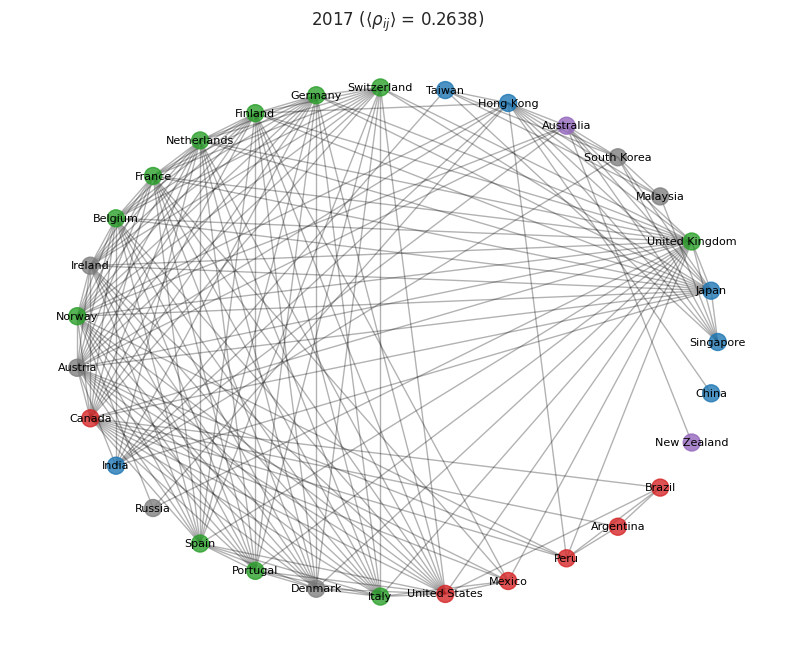

Procesando año 2018 con umbral promedio de correlación: 0.3644


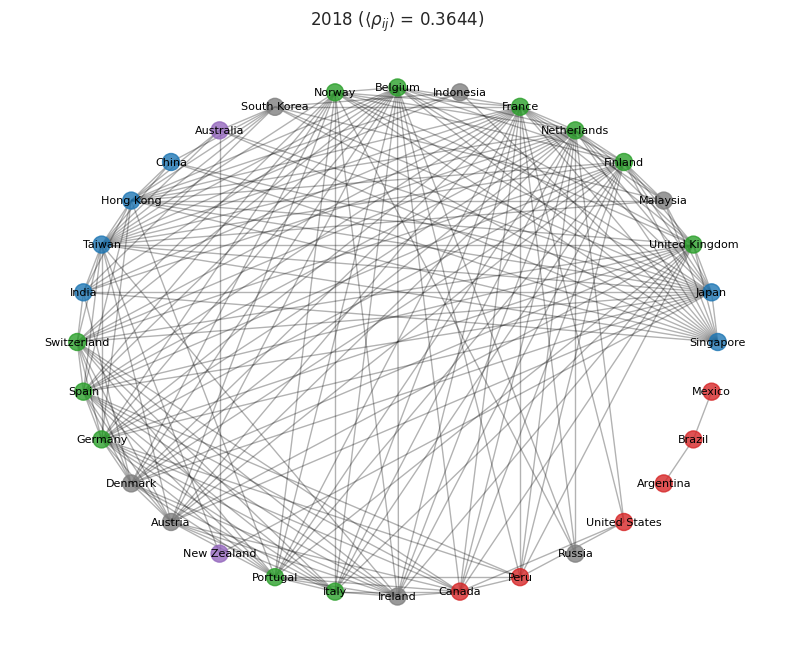

Procesando año 2019 con umbral promedio de correlación: 0.3220


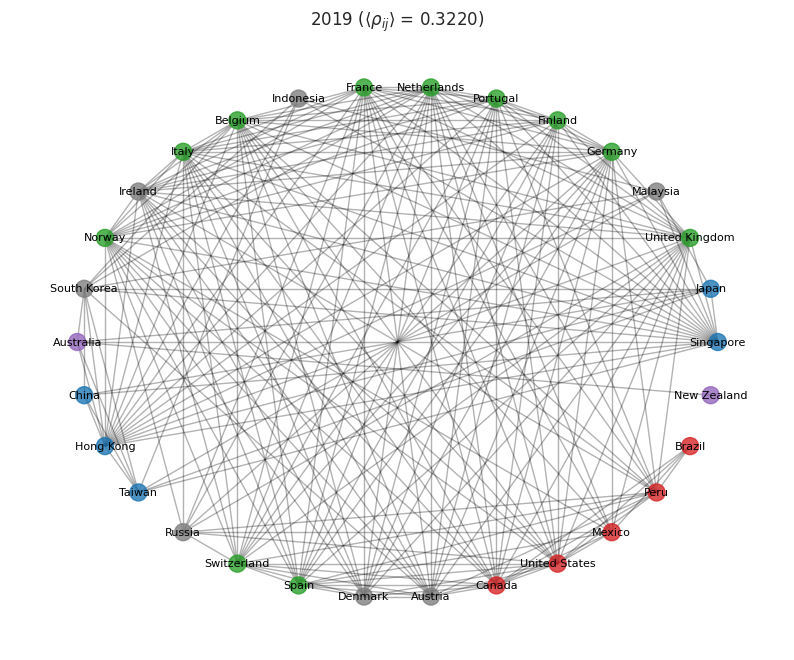

Procesando año 2020 con umbral promedio de correlación: 0.5541


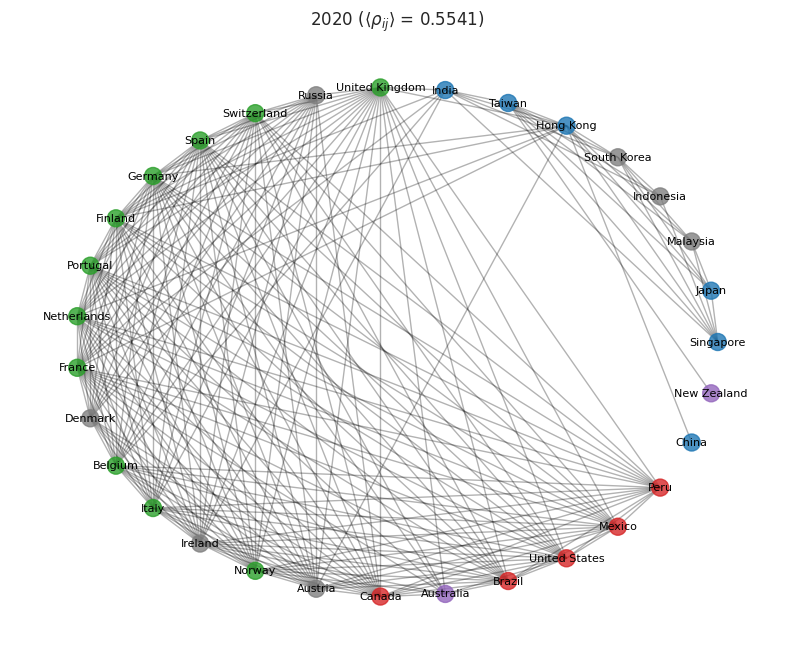

Procesando año 2021 con umbral promedio de correlación: 0.3249


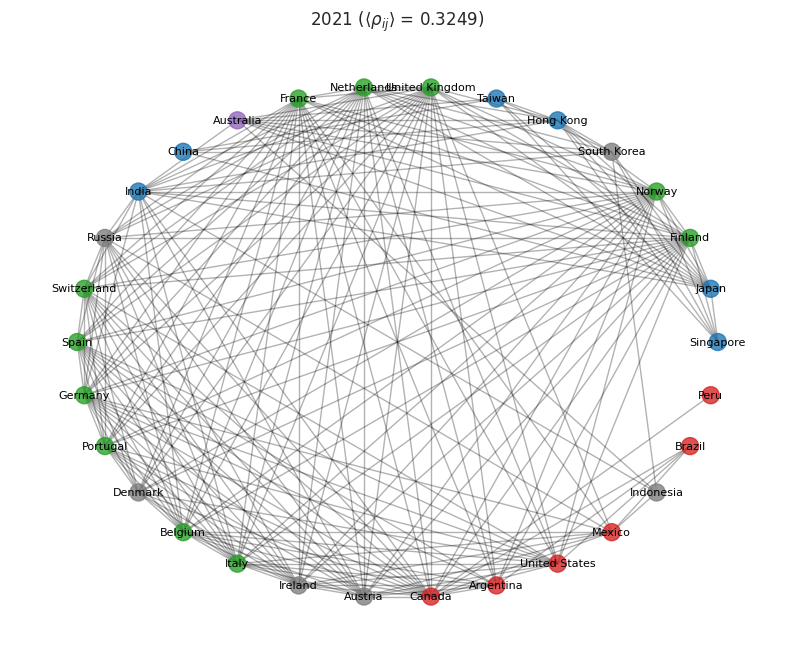

Procesando año 2022 con umbral promedio de correlación: 0.3669


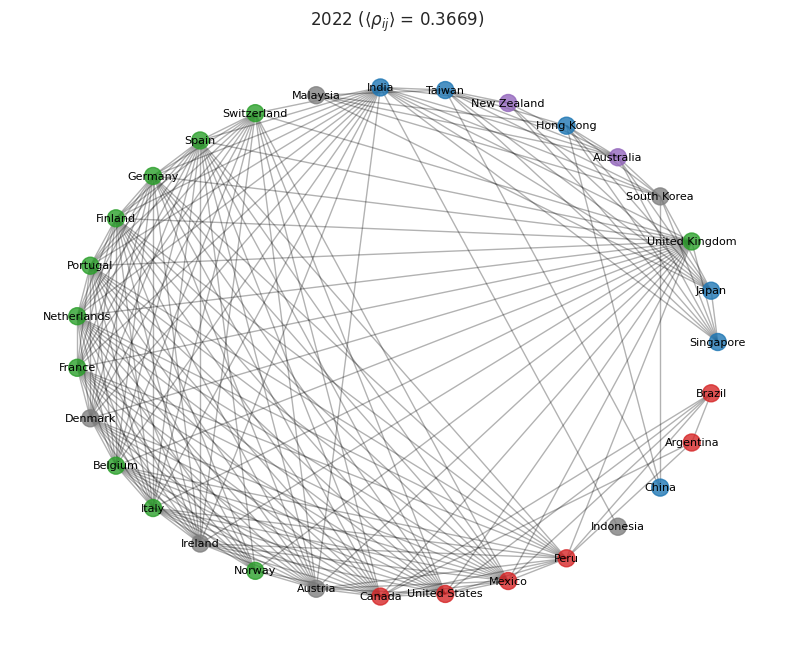

Procesando año 2017-2022 con umbral promedio de correlación: 0.4181


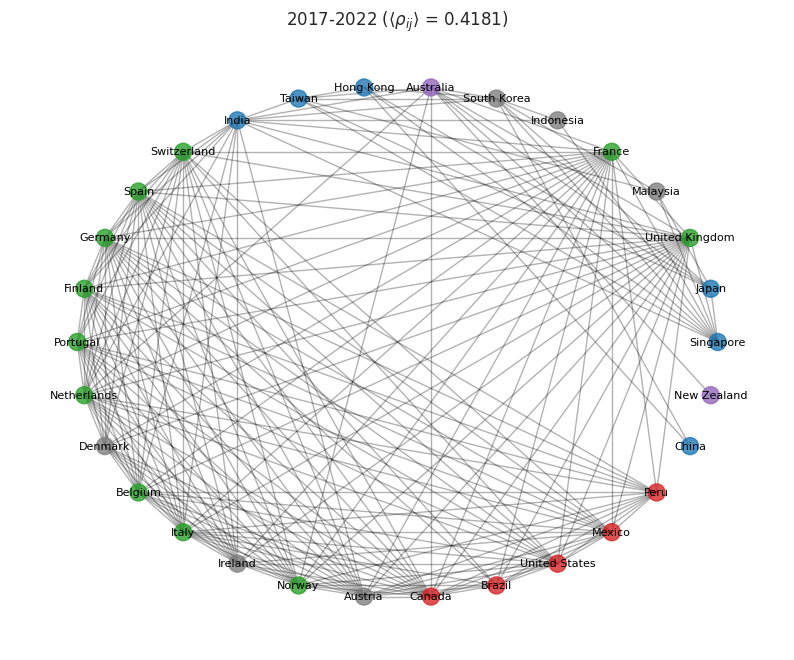

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Definir las regiones de cada país
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# Asignar un color a cada región
region_colors = {
    'Asia': 'tab:blue',
    'Europe': 'tab:green',
    'Americas': 'tab:red',
    'Oceania': 'tab:purple',
    'Middle East & Africa': 'tab:orange'
}

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Crear y visualizar el grafo para cada año, filtrado por el umbral promedio de correlación
for year, correlation_matrix in correlation_matrices.items():
    # Calcular el umbral promedio de correlación para el año
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()
    print(f"Procesando año {year} con umbral promedio de correlación: {avg_correlation:.4f}")

    # Crear el grafo solo con aristas que cumplen el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:
                graph.add_edge(i, j, weight=correlation)

    # Asignar colores a cada nodo según la región
    node_colors = []
    for node in graph.nodes():
        for region, countries in regions.items():
            if node in countries:
                node_colors.append(region_colors[region])
                break
        else:
            node_colors.append('gray')  # Color para nodos sin región definida, si los hubiera

    # Visualización del grafo
    plt.figure(figsize=(10, 8))
    pos = nx.circular_layout(graph)

    # Dibujar nodos con colores según la región
    nx.draw_networkx_nodes(graph, pos, node_color=node_colors, node_size=150, alpha=0.8)
    nx.draw_networkx_edges(graph, pos, alpha=0.3)
    nx.draw_networkx_labels(graph, pos, font_size=8)

    # Título y configuración del gráfico
    plt.title(f"{year} ($\\langle \\rho_{{ij}} \\rangle$ = {avg_correlation:.4f})")
    plt.axis("off")
    plt.show()


IndexError: index 6 is out of bounds for axis 0 with size 6

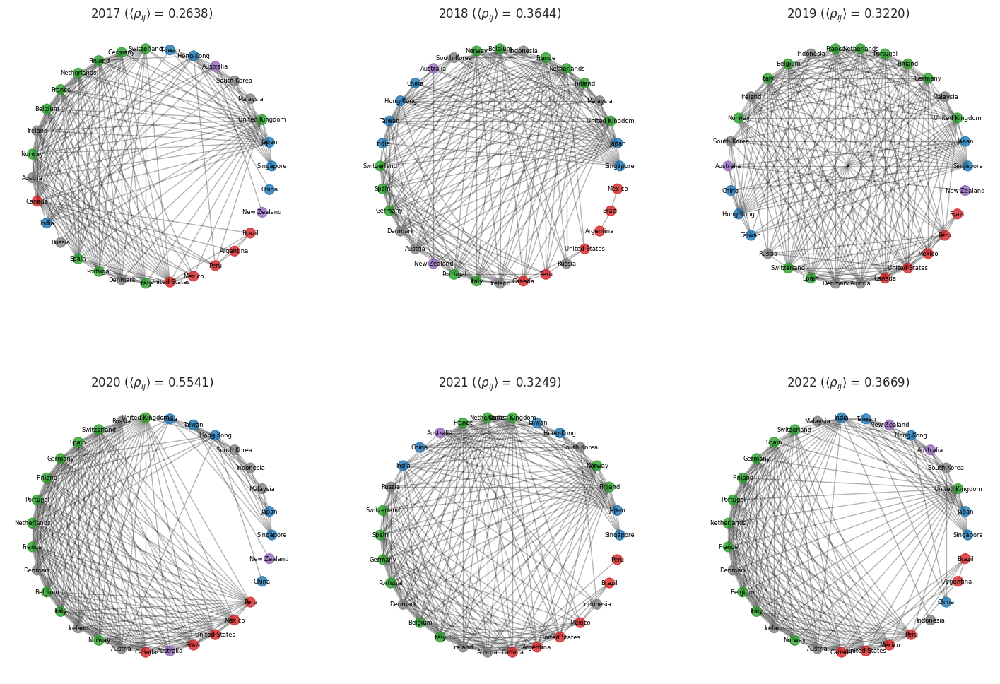

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Definir las regiones de cada país
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# Asignar un color a cada región
region_colors = {
    'Asia': 'tab:blue',
    'Europe': 'tab:green',
    'Americas': 'tab:red',
    'Oceania': 'tab:purple',
    'Middle East & Africa': 'tab:orange'
}

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Crear la figura general para todos los años en una sola hoja
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
fig.subplots_adjust(hspace=0.3)
axes = axes.flatten()

# Iterar sobre cada año y graficarlo en un subgráfico
for idx, (year, correlation_matrix) in enumerate(correlation_matrices.items()):
    # Calcular el umbral promedio de correlación para el año
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo solo con aristas que cumplen el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:
                graph.add_edge(i, j, weight=correlation)

    # Asignar colores a cada nodo según la región
    node_colors = []
    for node in graph.nodes():
        for region, countries in regions.items():
            if node in countries:
                node_colors.append(region_colors[region])
                break
        else:
            node_colors.append('gray')  # Color para nodos sin región definida

    # Configurar el subgráfico y graficar
    pos = nx.circular_layout(graph)
    nx.draw_networkx_nodes(graph, pos, node_color=node_colors, node_size=100, alpha=0.8, ax=axes[idx])
    nx.draw_networkx_edges(graph, pos, alpha=0.3, ax=axes[idx])
    nx.draw_networkx_labels(graph, pos, font_size=6, ax=axes[idx])

    # Título de cada subgráfico con el año y el umbral promedio
    axes[idx].set_title(f"{year} ($\\langle \\rho_{{ij}} \\rangle$ = {avg_correlation:.4f})")
    axes[idx].axis("off")

plt.suptitle("Graphs by Region for Each Year (Threshold: Average Correlation)", fontsize=16)
plt.show()


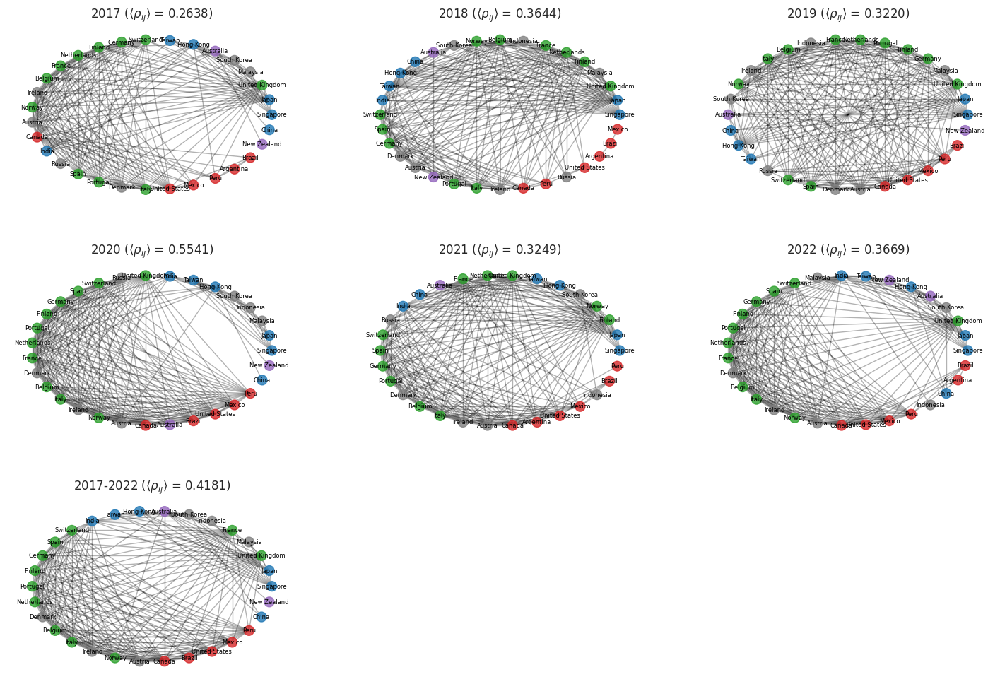

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Definir las regiones de cada país
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# Asignar un color a cada región
region_colors = {
    'Asia': 'tab:blue',
    'Europe': 'tab:green',
    'Americas': 'tab:red',
    'Oceania': 'tab:purple',
    'Middle East & Africa': 'tab:orange'
}

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Crear una cuadrícula flexible en función del número de años
n_graphs = len(correlation_matrices)
n_rows = (n_graphs + 2) // 3  # Número de filas necesarias
fig, axes = plt.subplots(n_rows, 3, figsize=(18, 4 * n_rows))
fig.subplots_adjust(hspace=0.3)
axes = axes.flatten()  # Aplanar para indexación simple

# Iterar sobre cada año y graficarlo en un subgráfico
for idx, (year, correlation_matrix) in enumerate(correlation_matrices.items()):
    # Calcular el umbral promedio de correlación para el año
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo solo con aristas que cumplen el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:
                graph.add_edge(i, j, weight=correlation)

    # Asignar colores a cada nodo según la región
    node_colors = []
    for node in graph.nodes():
        for region, countries in regions.items():
            if node in countries:
                node_colors.append(region_colors[region])
                break
        else:
            node_colors.append('gray')  # Color para nodos sin región definida

    # Configurar el subgráfico y graficar
    pos = nx.circular_layout(graph)
    nx.draw_networkx_nodes(graph, pos, node_color=node_colors, node_size=100, alpha=0.8, ax=axes[idx])
    nx.draw_networkx_edges(graph, pos, alpha=0.3, ax=axes[idx])
    nx.draw_networkx_labels(graph, pos, font_size=6, ax=axes[idx])

    # Título de cada subgráfico con el año y el umbral promedio
    axes[idx].set_title(f"{year} ($\\langle \\rho_{{ij}} \\rangle$ = {avg_correlation:.4f})")
    axes[idx].axis("off")

# Ocultar ejes adicionales en caso de que haya menos de 6 años
for ax in axes[n_graphs:]:
    ax.axis("off")

#plt.suptitle("Graphs by Region for Each Year (Threshold: Average Correlation)", fontsize=16)
plt.show()


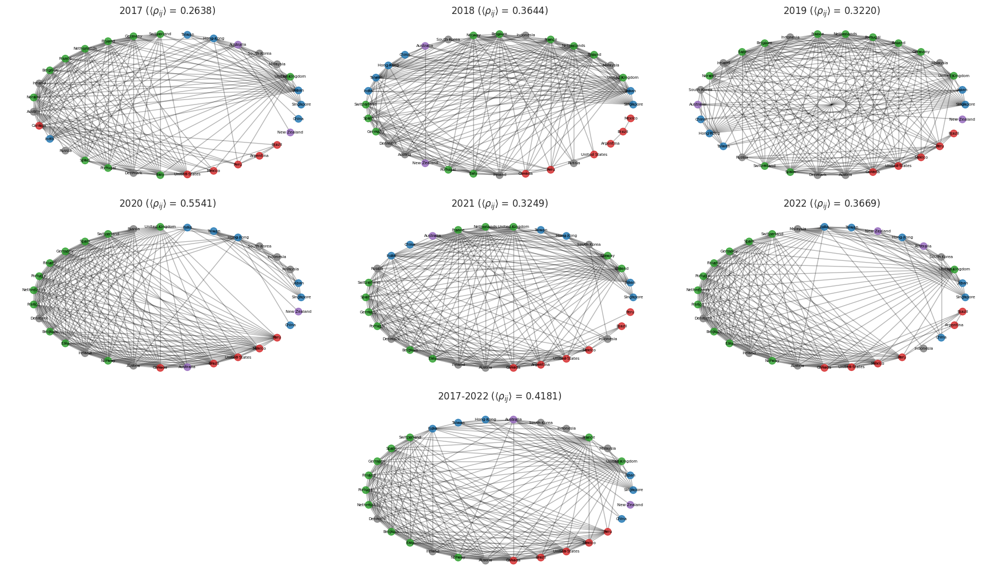

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Definir las regiones de cada país
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# Asignar un color a cada región
region_colors = {
    'Asia': 'tab:blue',
    'Europe': 'tab:green',
    'Americas': 'tab:red',
    'Oceania': 'tab:purple',
    'Middle East & Africa': 'tab:orange'
}

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Configurar una cuadrícula optimizada según el número de gráficos
n_graphs = len(correlation_matrices)
n_rows = (n_graphs + 2) // 3  # Determina el número de filas de forma flexible
fig, axes = plt.subplots(n_rows, 3, figsize=(18, 3.5 * n_rows))
fig.subplots_adjust(hspace=0.5, wspace=0.3)
axes = axes.flatten()

# Iterar sobre cada año y graficarlo en un subgráfico
for idx, (year, correlation_matrix) in enumerate(correlation_matrices.items()):
    # Calcular el umbral promedio de correlación para el año
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo solo con aristas que cumplen el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:
                graph.add_edge(i, j, weight=correlation)

    # Asignar colores a cada nodo según la región
    node_colors = []
    for node in graph.nodes():
        for region, countries in regions.items():
            if node in countries:
                node_colors.append(region_colors[region])
                break
        else:
            node_colors.append('gray')  # Color para nodos sin región definida

    # Verificar si es el último gráfico (2017-2022) y posicionarlo en el centro de la última fila
    if year == '2017-2022':
        center_idx = (n_rows - 1) * 3 + 1  # Índice para el centro de la última fila
        ax = axes[center_idx]
    else:
        ax = axes[idx]

    # Configurar el subgráfico y graficar
    pos = nx.circular_layout(graph)
    nx.draw_networkx_nodes(graph, pos, node_color=node_colors, node_size=80, alpha=0.8, ax=ax)
    nx.draw_networkx_edges(graph, pos, alpha=0.3, ax=ax)
    nx.draw_networkx_labels(graph, pos, font_size=5, ax=ax)

    # Título de cada subgráfico con el año y el umbral promedio
    ax.set_title(f"{year} ($\\langle \\rho_{{ij}} \\rangle$ = {avg_correlation:.4f})", fontsize=12)
    ax.axis("off")

# Ocultar el subgráfico vacío en la fila 3 columna 1
axes[(n_rows - 1) * 3].axis("off")
axes[(n_rows - 1) * 3+2].axis("off")


#plt.suptitle("Graphs by Region for Each Year (Threshold: Average Correlation)", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()


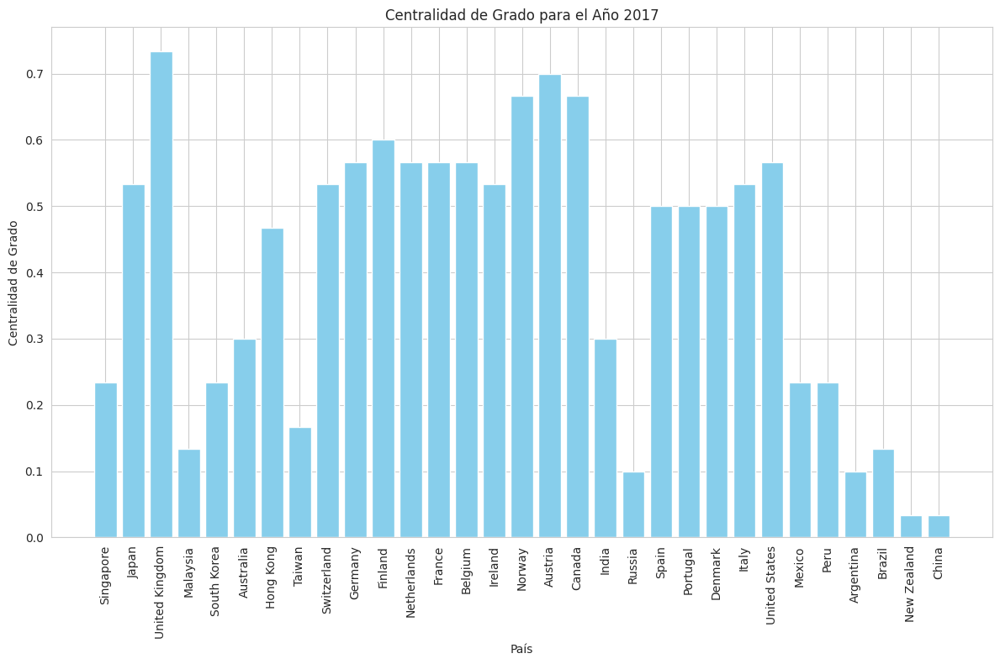

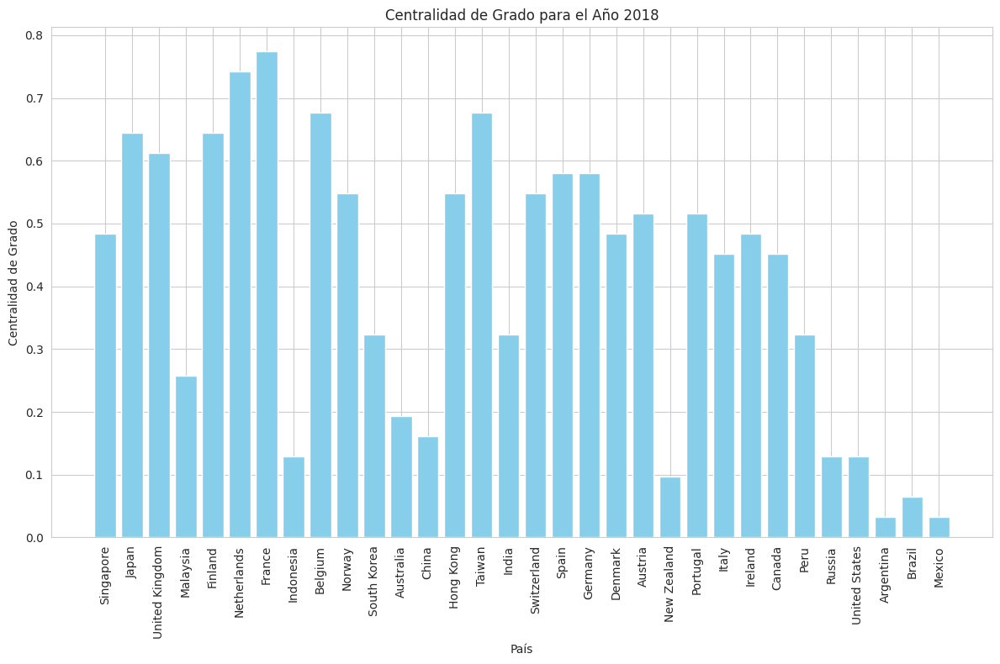

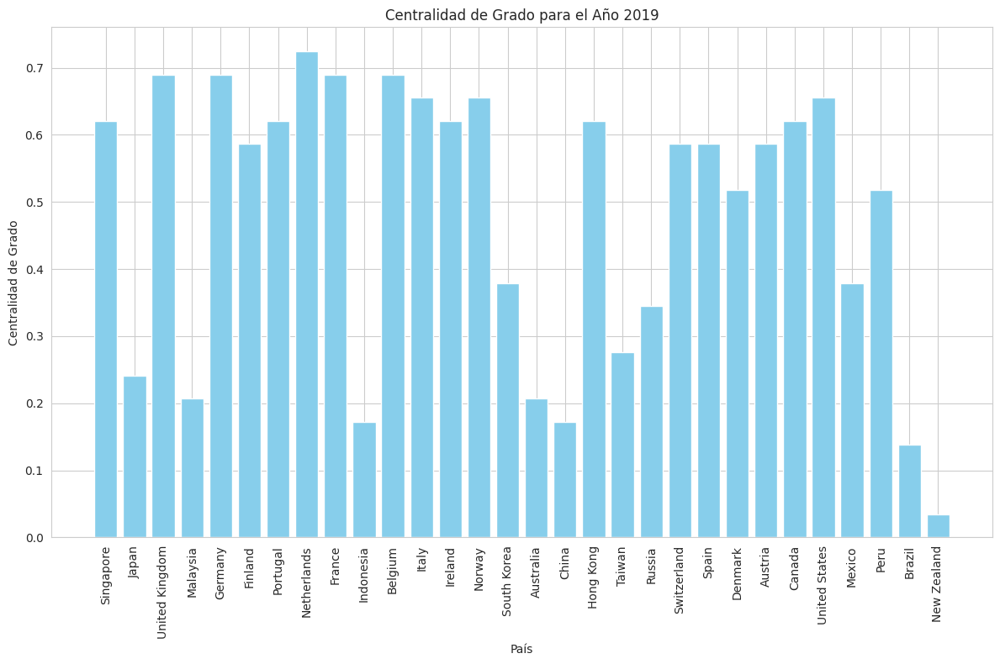

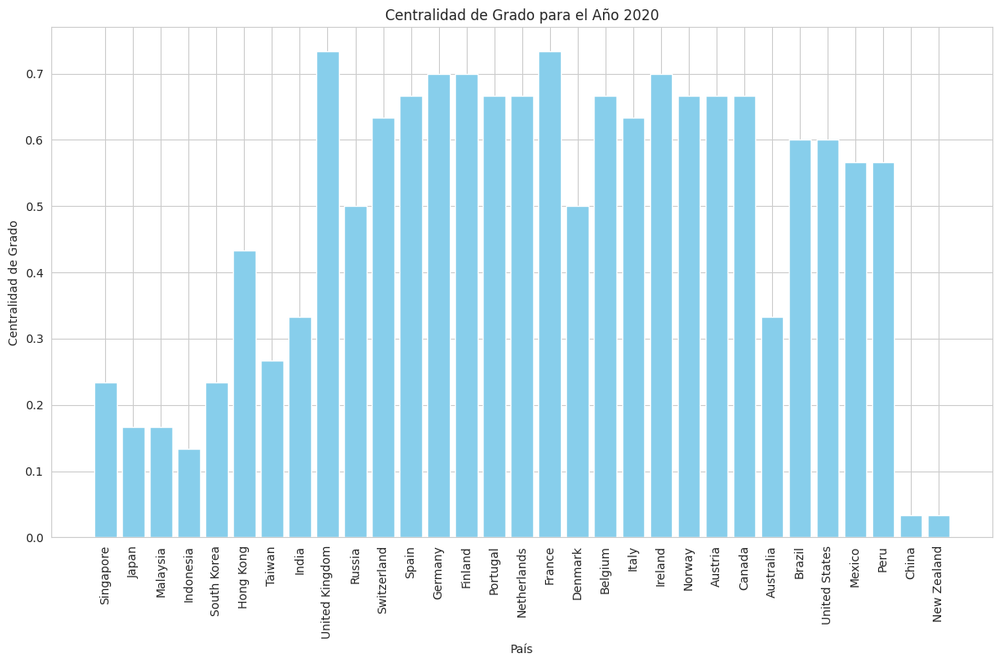

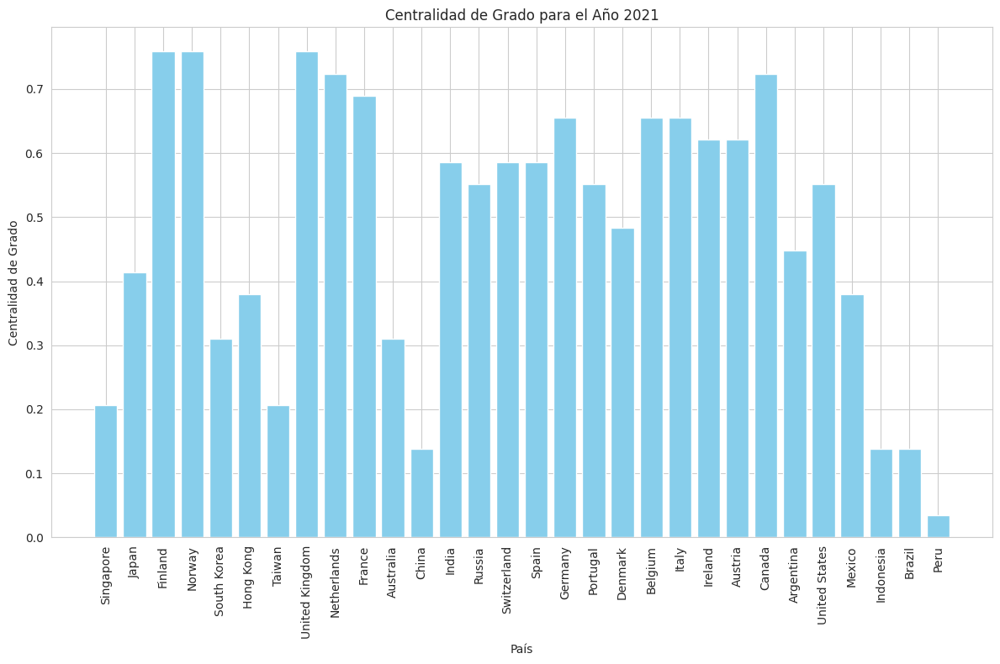

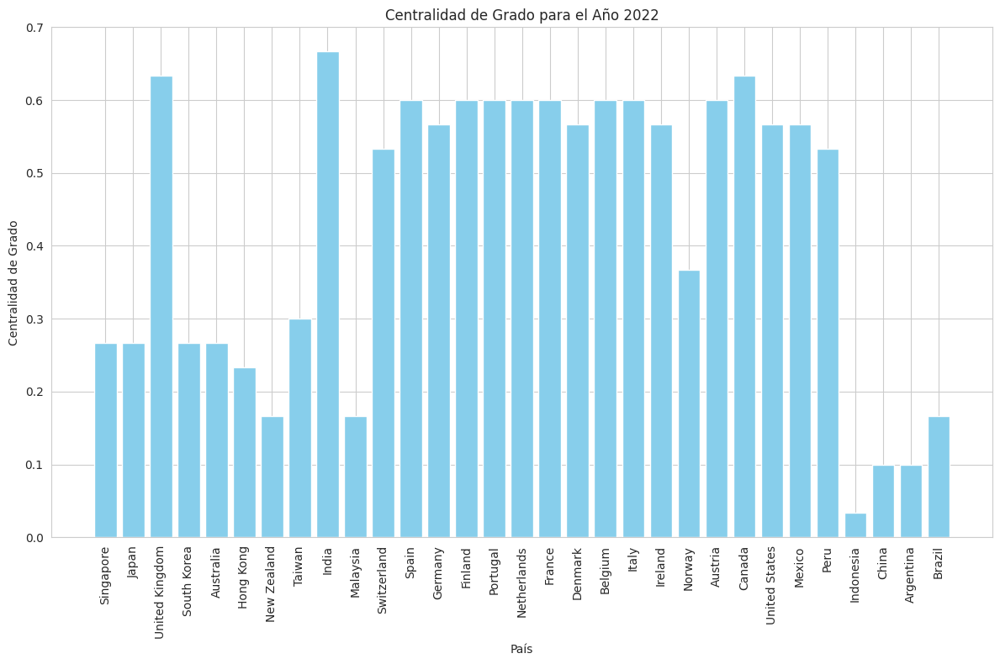

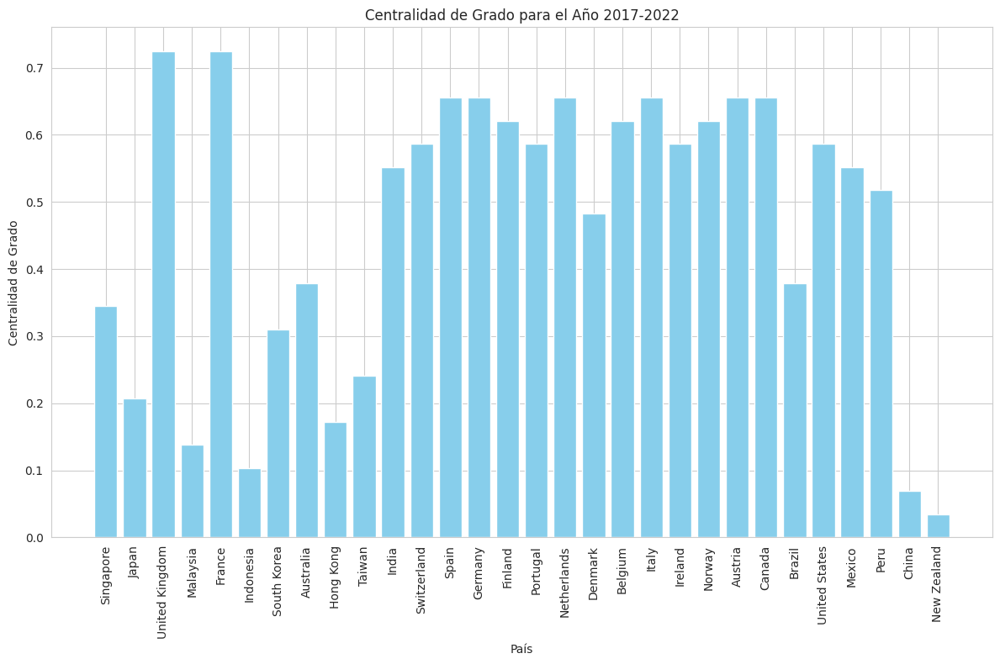

ValueError: Length mismatch: Expected axis has 3 elements, new values have 6 elements

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Función para convertir correlación a distancia
def correlation_to_distance(correlation):
    return np.sqrt(2 * (1 - correlation))

# Diccionario para almacenar las métricas de centralidad por año
centrality_metrics = {}

# Iterar sobre cada año y calcular el grafo y sus métricas de centralidad
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación y convertirla a un umbral de distancia
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()
    distance_threshold = correlation_to_distance(avg_correlation)

    # Crear el grafo solo con aristas que tienen una distancia menor que el umbral
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:
                distance = correlation_to_distance(correlation)
                if distance < distance_threshold:
                    graph.add_edge(i, j, weight=distance)

    # Verificar que el grafo no esté vacío
    if graph.number_of_edges() == 0:
        print(f"No edges for year {year} with threshold based on avg correlation")
        centrality_metrics[year] = {'degree': {}, 'betweenness': {}, 'closeness': {}, 'eigenvector': {}}
        continue

    # Calcular métricas de centralidad
    degree_centrality = nx.degree_centrality(graph)
    betweenness_centrality = nx.betweenness_centrality(graph)
    closeness_centrality = nx.closeness_centrality(graph)
    eigenvector_centrality = nx.eigenvector_centrality(graph, max_iter=1000)

    # Guardar las métricas en el diccionario
    centrality_metrics[year] = {
        'degree': degree_centrality,
        'betweenness': betweenness_centrality,
        'closeness': closeness_centrality,
        'eigenvector': eigenvector_centrality
    }

# Visualización del grado de centralidad para cada año
for year, metrics in centrality_metrics.items():
    plt.figure(figsize=(12, 8))
    plt.bar(metrics['degree'].keys(), metrics['degree'].values(), color='skyblue')
    plt.xticks(rotation=90)
    plt.title(f"Centralidad de Grado para el Año {year}")
    plt.xlabel("País")
    plt.ylabel("Centralidad de Grado")
    plt.tight_layout()
    plt.show()

# Ejemplo de tabla de centralidades por año (opcional)
centrality_df = pd.DataFrame({
    (year, 'Degree'): metrics['degree'],
    (year, 'Betweenness'): metrics['betweenness'],
    (year, 'Closeness'): metrics['closeness'],
    (year, 'Eigenvector'): metrics['eigenvector']
} for year, metrics in centrality_metrics.items()).stack(level=0).reset_index()

# Rename the columns to desired names
centrality_df.columns = ['Año', 'País', 'Centralidad de Grado', 'Centralidad de Intermediación', 'Centralidad de Cercanía', 'Centralidad de Autovector']

print(centrality_df)


In [ ]:
print(centrality_df)

    level_0                   level_1  \
0         0            (2017, Degree)   
1         0       (2017, Betweenness)   
2         0         (2017, Closeness)   
3         0       (2017, Eigenvector)   
4         1            (2018, Degree)   
5         1       (2018, Betweenness)   
6         1         (2018, Closeness)   
7         1       (2018, Eigenvector)   
8         2            (2019, Degree)   
9         2       (2019, Betweenness)   
10        2         (2019, Closeness)   
11        2       (2019, Eigenvector)   
12        3            (2020, Degree)   
13        3       (2020, Betweenness)   
14        3         (2020, Closeness)   
15        3       (2020, Eigenvector)   
16        4            (2021, Degree)   
17        4       (2021, Betweenness)   
18        4         (2021, Closeness)   
19        4       (2021, Eigenvector)   
20        5            (2022, Degree)   
21        5       (2022, Betweenness)   
22        5         (2022, Closeness)   
23        5     

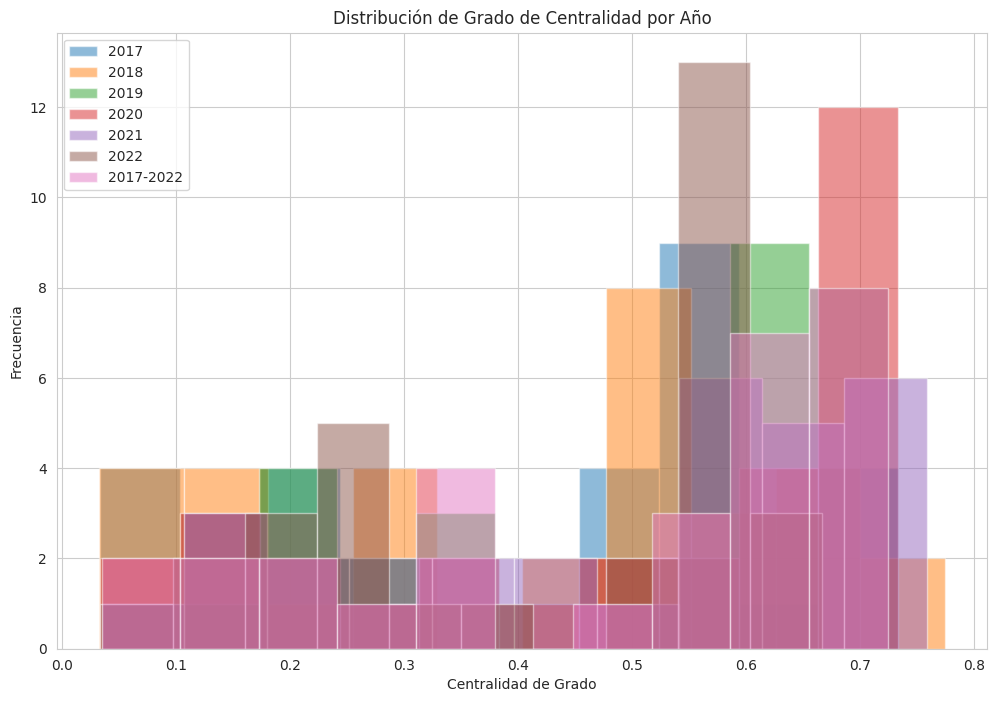

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Función para convertir correlación a distancia
def correlation_to_distance(correlation):
    return np.sqrt(2 * (1 - correlation))

# Diccionarios para almacenar resultados de centralidad
centrality_results = {}

# Iterar sobre cada año y calcular métricas de centralidad
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación para el año y convertirla a un umbral de distancia
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()
    distance_threshold = correlation_to_distance(avg_correlation)

    # Crear el grafo global usando el umbral de distancia
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:
                distance = correlation_to_distance(correlation)
                if distance < distance_threshold:
                    graph.add_edge(i, j, weight=distance)

    # Verificar que el grafo no esté vacío antes de calcular métricas de centralidad
    if graph.number_of_edges() == 0:
        print(f"No edges for year {year} with threshold based on avg correlation")
        centrality_results[year] = {}
        continue

    # Calcular métricas de centralidad
    degree_centrality = nx.degree_centrality(graph)
    closeness_centrality = nx.closeness_centrality(graph)
    betweenness_centrality = nx.betweenness_centrality(graph, weight='weight')
    eigenvector_centrality = nx.eigenvector_centrality(graph, max_iter=1000, tol=1e-06)

    # Almacenar los resultados en un diccionario
    centrality_results[year] = {
        'degree': degree_centrality,
        'closeness': closeness_centrality,
        'betweenness': betweenness_centrality,
        'eigenvector': eigenvector_centrality
    }

# Visualizar la distribución del grado de centralidad para cada año
plt.figure(figsize=(12, 8))
for year, metrics in centrality_results.items():
    if 'degree' in metrics:
        degrees = list(metrics['degree'].values())
        plt.hist(degrees, bins=10, alpha=0.5, label=str(year))

plt.title("Distribución de Grado de Centralidad por Año")
plt.xlabel("Centralidad de Grado")
plt.ylabel("Frecuencia")
plt.legend()
plt.grid(True)
plt.show()


Año 2017: Densidad de la Red = 0.4043
Año 2018: Densidad de la Red = 0.4113
Año 2019: Densidad de la Red = 0.4828
Año 2020: Densidad de la Red = 0.4903
Año 2021: Densidad de la Red = 0.4874
Año 2022: Densidad de la Red = 0.4301
Año 2017-2022: Densidad de la Red = 0.4690


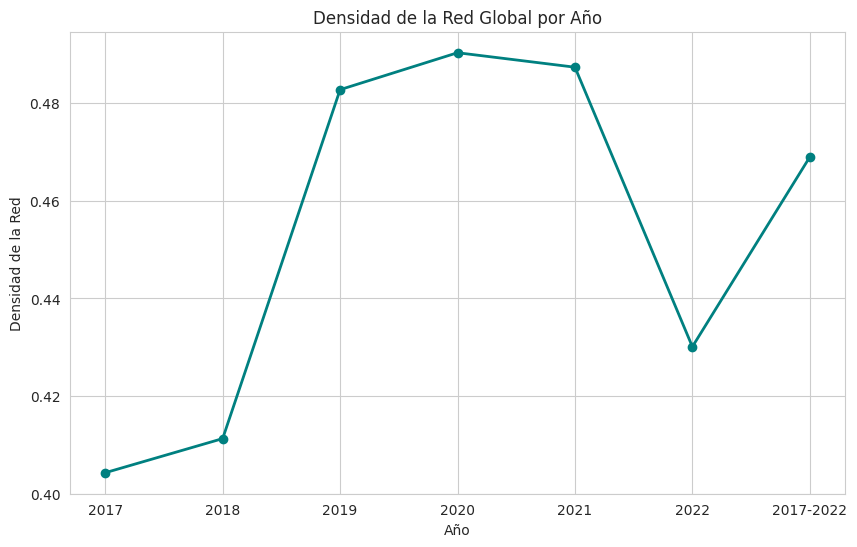

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Función para convertir correlación a distancia
def correlation_to_distance(correlation):
    return np.sqrt(2 * (1 - correlation))

# Diccionario para almacenar las densidades de cada año
network_densities = {}

# Iterar sobre cada año y calcular la densidad de la red
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación para el año y convertirla a un umbral de distancia
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()
    distance_threshold = correlation_to_distance(avg_correlation)

    # Crear el grafo global usando el umbral de distancia
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:
                distance = correlation_to_distance(correlation)
                if distance < distance_threshold:
                    graph.add_edge(i, j, weight=distance)

    # Calcular la densidad de la red y almacenar el resultado
    density = nx.density(graph)
    network_densities[year] = density

    # Mostrar el resultado
    print(f"Año {year}: Densidad de la Red = {density:.4f}")

# Visualización de la densidad de la red a lo largo de los años
years = list(network_densities.keys())
densities = list(network_densities.values())

plt.figure(figsize=(10, 6))
plt.plot(years, densities, marker='o', color='teal', linestyle='-', linewidth=2, markersize=6)
plt.title("Densidad de la Red Global por Año")
plt.xlabel("Año")
plt.ylabel("Densidad de la Red")
plt.grid(True)
plt.show()


Año 2017: Densidad de la Red = 0.4043
Año 2018: Densidad de la Red = 0.4113
Año 2019: Densidad de la Red = 0.4828
Año 2020: Densidad de la Red = 0.4903
Año 2021: Densidad de la Red = 0.4874
Año 2022: Densidad de la Red = 0.4301
Año 2017-2022: Densidad de la Red = 0.4690


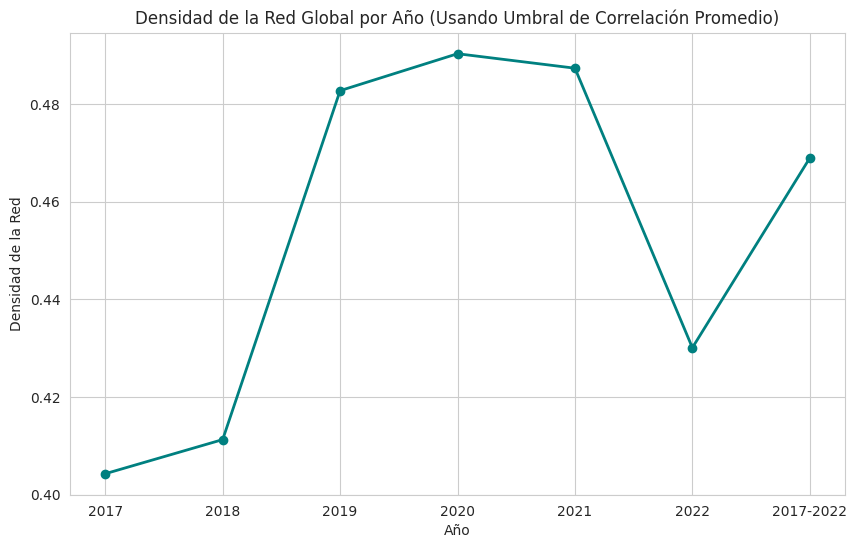

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Diccionario para almacenar las densidades de cada año
network_densities = {}

# Iterar sobre cada año y calcular la densidad de la red basada en el umbral de correlación promedio
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación para el año y usarla como umbral
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo global usando el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:  # Conectar si la correlación es mayor o igual al umbral
                graph.add_edge(i, j, weight=correlation)

    # Calcular la densidad de la red y almacenar el resultado
    density = nx.density(graph)
    network_densities[year] = density
    # Mostrar el resultado
    print(f"Año {year}: Densidad de la Red = {density:.4f}")

# Visualización de la densidad de la red a lo largo de los años
years = list(network_densities.keys())
densities = list(network_densities.values())

plt.figure(figsize=(10, 6))
plt.plot(years, densities, marker='o', color='teal', linestyle='-', linewidth=2, markersize=6)
plt.title("Densidad de la Red Global por Año (Usando Umbral de Correlación Promedio)")
plt.xlabel("Año")
plt.ylabel("Densidad de la Red")
plt.grid(True)
plt.show()





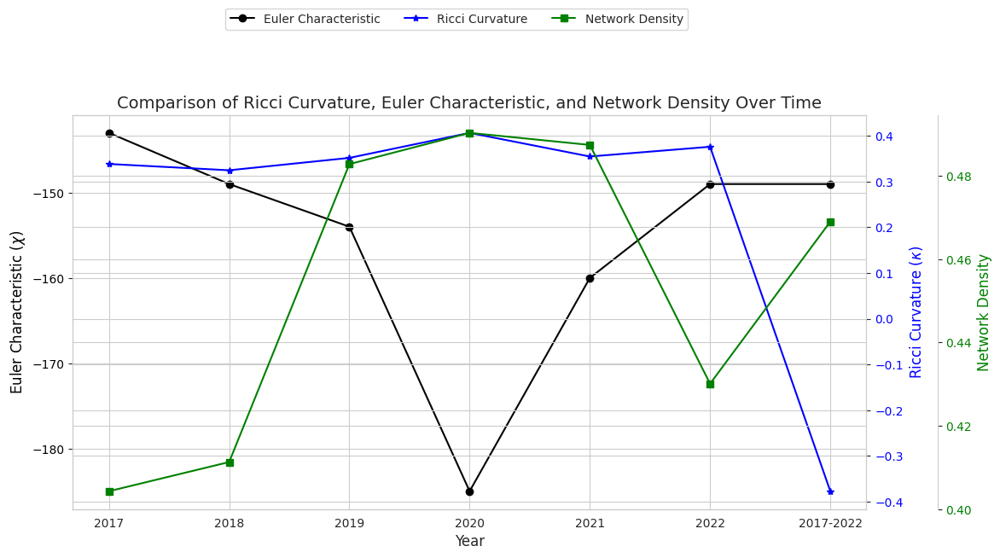

In [ ]:
import matplotlib.pyplot as plt

# Datos de características de Euler, curvatura de Ricci y densidad de la red
euler_characteristics = {2017: -143, 2018: -149, 2019: -154, 2020: -185, 2021: -160, 2022: -149, '2017-2022': -149}
ricci_curvatures_by_year = {2017: 0.3386, 2018: 0.3248, 2019: 0.3519, 2020: 0.4066, 2021: 0.3549, 2022: 0.3762, '2017-2022': -0.3770}
network_density = {2017: 0.4043, 2018: 0.4113, 2019: 0.4828, 2020: 0.4903, 2021: 0.4874, 2022: 0.4301, '2017-2022': 0.4690}

# Preparar datos para graficar
years = list(euler_characteristics.keys())
euler_values = list(euler_characteristics.values())
ricci_values = list(ricci_curvatures_by_year.values())
density_values = list(network_density.values())

# Crear la figura y los ejes con tres series
fig, ax1 = plt.subplots(figsize=(12, 6))

# Gráfico de la característica de Euler
ax1.plot(years, euler_values, marker='o', color='black', label="Euler Characteristic")
ax1.set_xlabel("Year", size=12)
ax1.set_ylabel("Euler Characteristic ($\\chi$)", color='black', size=12)
ax1.tick_params(axis='y', labelcolor='black')

# Crear el segundo eje y para la Curvatura de Ricci
ax2 = ax1.twinx()
ax2.plot(years, ricci_values, marker='*', color='blue', label="Ricci Curvature")
ax2.set_ylabel("Ricci Curvature ($\\kappa$)", size=12, color='blue')
ax2.tick_params(axis='y', labelcolor='blue')

# Crear un tercer eje y para la Densidad de la red
ax3 = ax1.twinx()
ax3.spines["right"].set_position(("outward", 60))  # Mover el tercer eje hacia la derecha
ax3.plot(years, density_values, marker='s', color='green', label="Network Density")
ax3.set_ylabel("Network Density", size=12, color='green')
ax3.tick_params(axis='y', labelcolor='green')

# Título y grilla
plt.title("Comparison of Ricci Curvature, Euler Characteristic, and Network Density Over Time", size=14)
#ax1.grid(True, linestyle='--', alpha=0.3, color='gray')

# Mostrar la leyenda combinada
fig.legend(loc="upper center", bbox_to_anchor=(0.5, 1.1), ncol=3, fontsize=10)

plt.show()


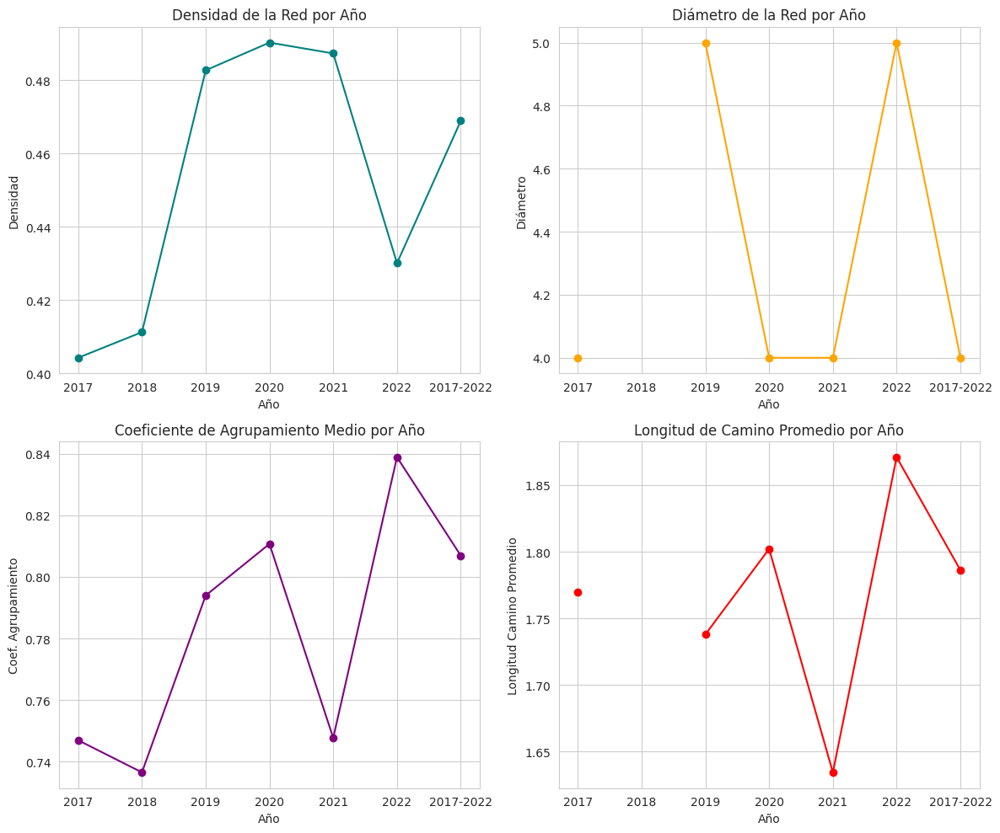

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Diccionarios para almacenar las métricas
network_densities = {}
network_diameters = {}
average_clustering_coefficients = {}
average_path_lengths = {}

# Iterar sobre cada año y calcular las métricas globales de la red
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación para el año y usarla como umbral
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo global usando el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:  # Conectar si la correlación es mayor o igual al umbral
                graph.add_edge(i, j, weight=correlation)

    # Calcular la densidad de la red
    density = nx.density(graph)
    network_densities[year] = density

    # Calcular el coeficiente de agrupamiento medio
    clustering_coefficient = nx.average_clustering(graph)
    average_clustering_coefficients[year] = clustering_coefficient

    # Calcular el diámetro de la red (solo si la red es conectada)
    if nx.is_connected(graph):
        diameter = nx.diameter(graph)
        avg_path_length = nx.average_shortest_path_length(graph)
    else:
        diameter = np.nan
        avg_path_length = np.nan

    network_diameters[year] = diameter
    average_path_lengths[year] = avg_path_length

# Visualización de las métricas a lo largo del tiempo
years = list(network_densities.keys())

# Crear subplots para cada métrica
plt.figure(figsize=(12, 10))

# Densidad de la Red
plt.subplot(2, 2, 1)
plt.plot(years, list(network_densities.values()), marker='o', color='teal')
plt.title("Densidad de la Red por Año")
plt.xlabel("Año")
plt.ylabel("Densidad")
plt.grid(True)

# Diámetro de la Red
plt.subplot(2, 2, 2)
plt.plot(years, list(network_diameters.values()), marker='o', color='orange')
plt.title("Diámetro de la Red por Año")
plt.xlabel("Año")
plt.ylabel("Diámetro")
plt.grid(True)

# Coeficiente de Agrupamiento Medio
plt.subplot(2, 2, 3)
plt.plot(years, list(average_clustering_coefficients.values()), marker='o', color='purple')
plt.title("Coeficiente de Agrupamiento Medio por Año")
plt.xlabel("Año")
plt.ylabel("Coef. Agrupamiento")
plt.grid(True)

# Longitud de Camino Promedio
plt.subplot(2, 2, 4)
plt.plot(years, list(average_path_lengths.values()), marker='o', color='red')
plt.title("Longitud de Camino Promedio por Año")
plt.xlabel("Año")
plt.ylabel("Longitud Camino Promedio")
plt.grid(True)

plt.tight_layout()
plt.show()


In [ ]:
!pip install python-louvain


Año 2017: Modularidad de la Red = 0.1831
Año 2018: Modularidad de la Red = 0.2214
Año 2019: Modularidad de la Red = 0.1945
Año 2020: Modularidad de la Red = 0.1663
Año 2021: Modularidad de la Red = 0.1594
Año 2022: Modularidad de la Red = 0.2367
Año 2017-2022: Modularidad de la Red = 0.1865


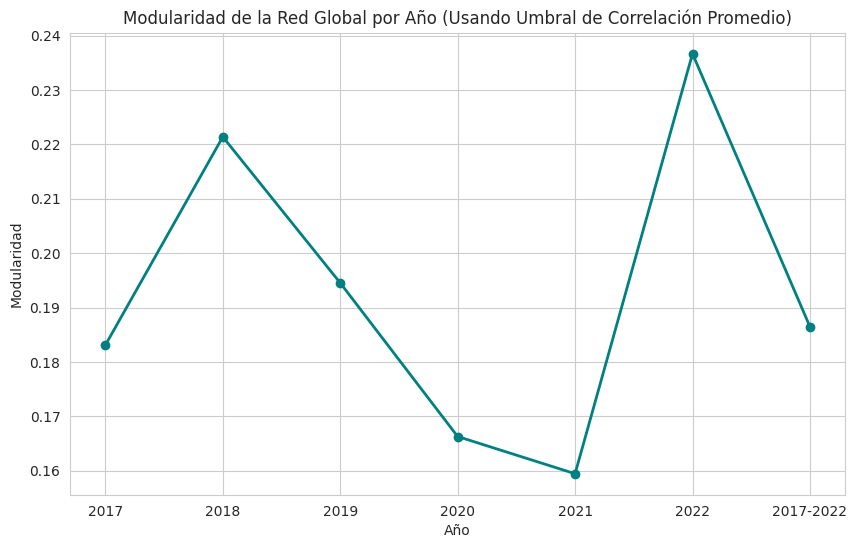

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import community.community_louvain as community_louvain  # Importación corregida para el algoritmo de Louvain

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Diccionario para almacenar la modularidad de cada año
modularity_scores = {}

# Iterar sobre cada año y calcular la modularidad
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación para el año y usarla como umbral
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo global usando el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:  # Conectar si la correlación es mayor o igual al umbral
                graph.add_edge(i, j, weight=correlation)

    # Detección de comunidades usando el algoritmo de Louvain
    partition = community_louvain.best_partition(graph, weight='weight')
    modularity = community_louvain.modularity(partition, graph, weight='weight')
    modularity_scores[year] = modularity

    # Mostrar el resultado
    print(f"Año {year}: Modularidad de la Red = {modularity:.4f}")

# Visualización de la modularidad a lo largo de los años
years = list(modularity_scores.keys())
modularity_values = list(modularity_scores.values())

plt.figure(figsize=(10, 6))
plt.plot(years, modularity_values, marker='o', color='teal', linestyle='-', linewidth=2, markersize=6)
plt.title("Modularidad de la Red Global por Año (Usando Umbral de Correlación Promedio)")
plt.xlabel("Año")
plt.ylabel("Modularidad")
plt.grid(True)
plt.show()


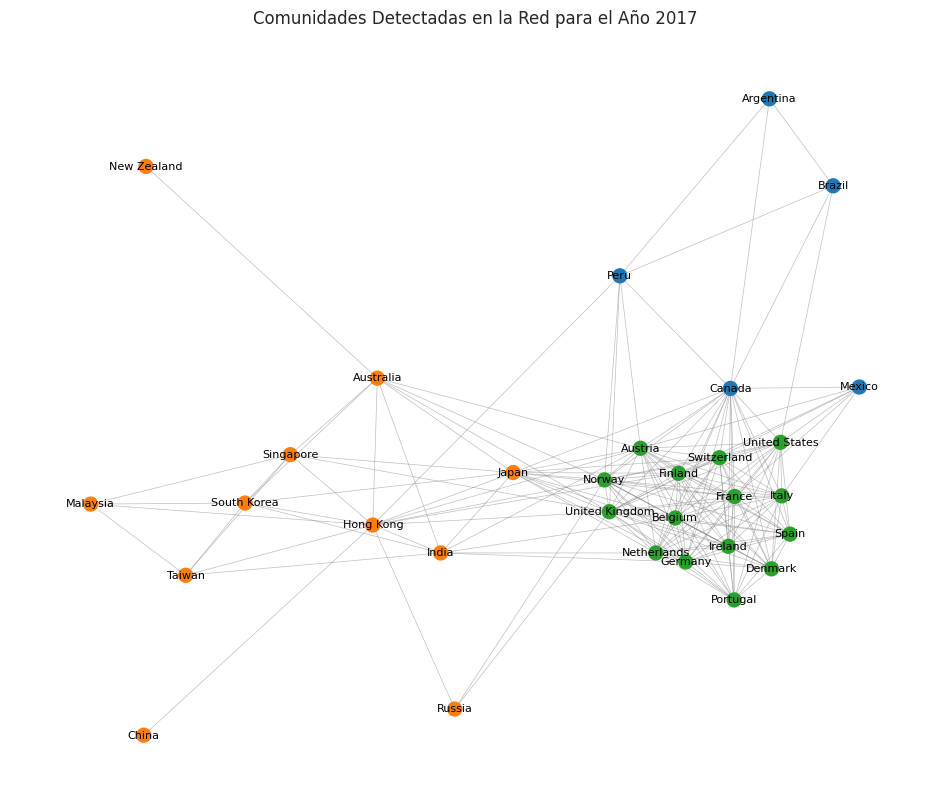

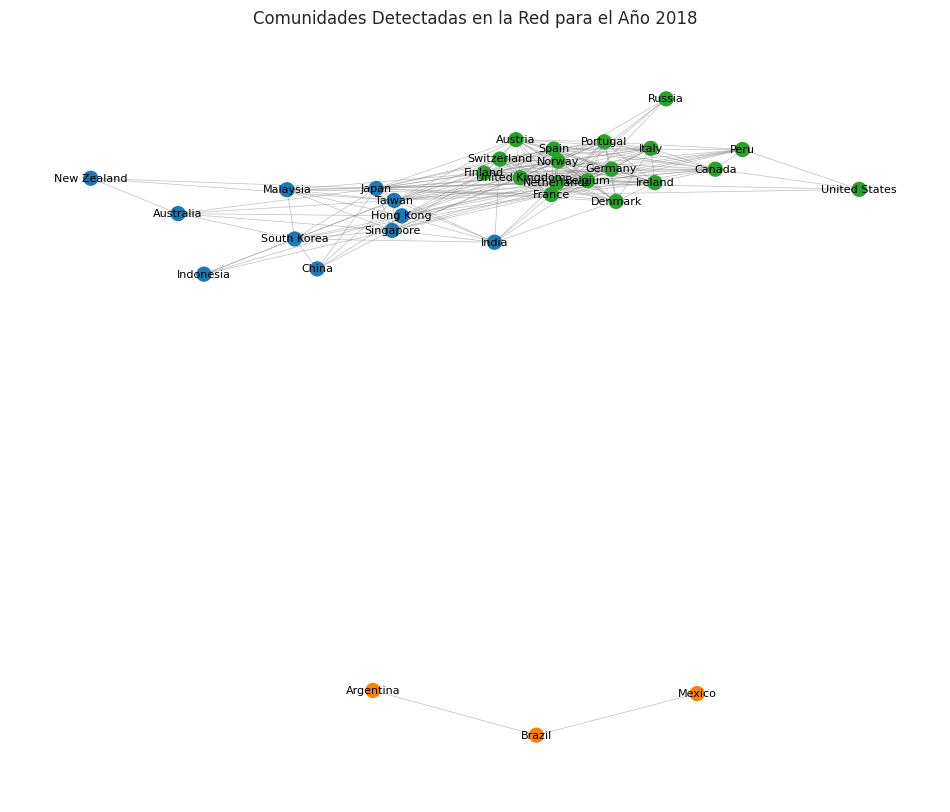

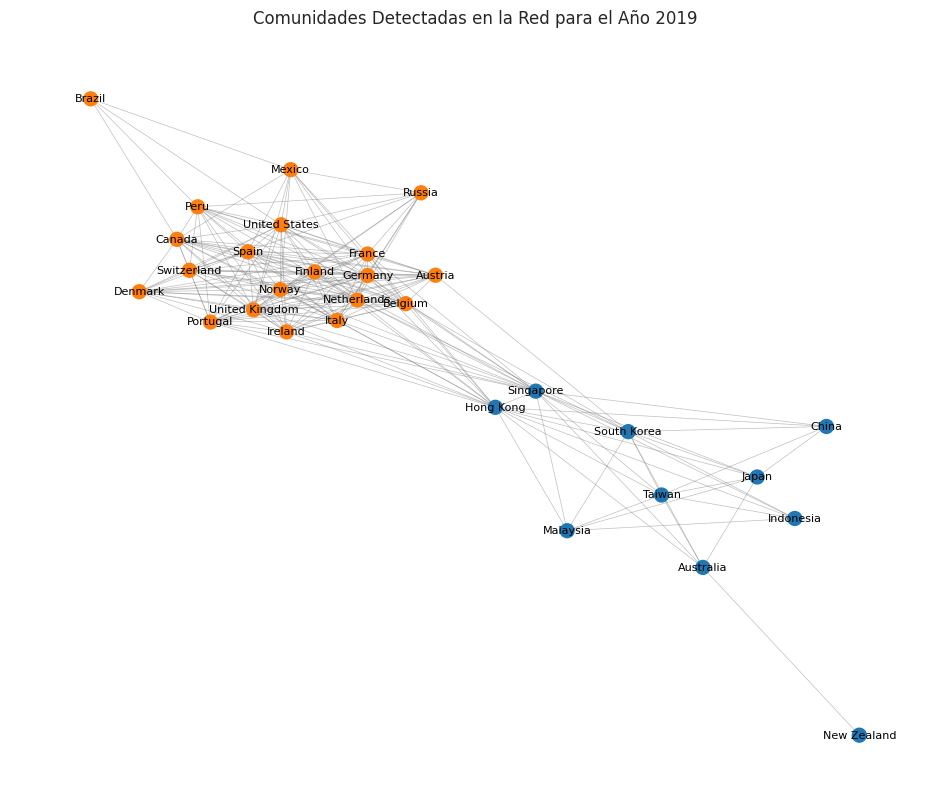

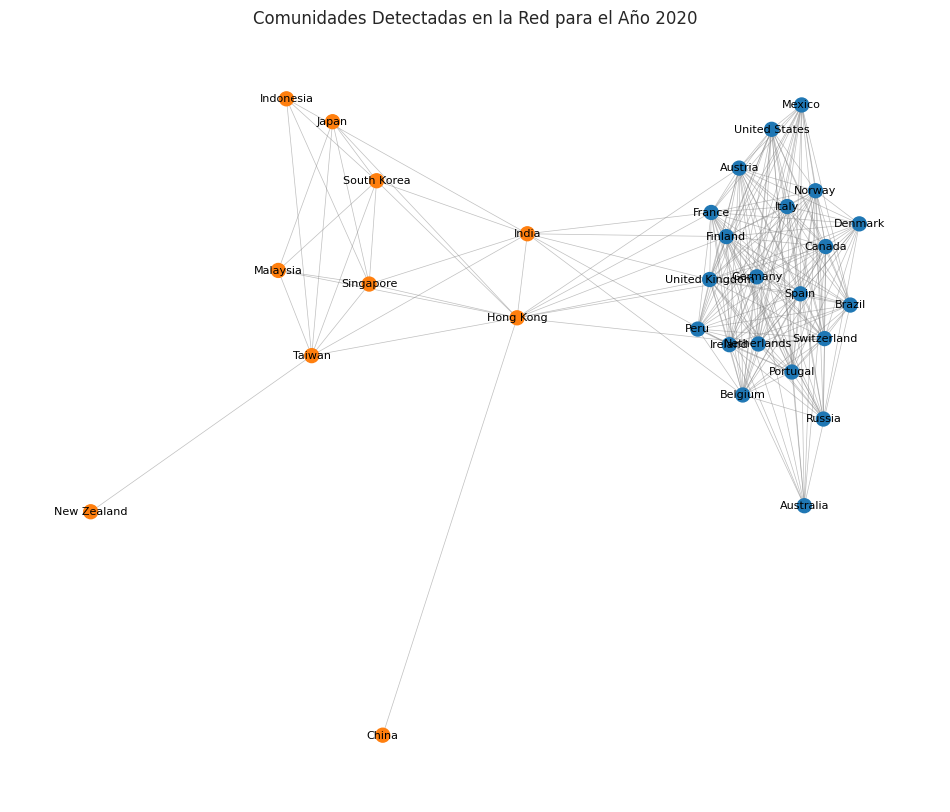

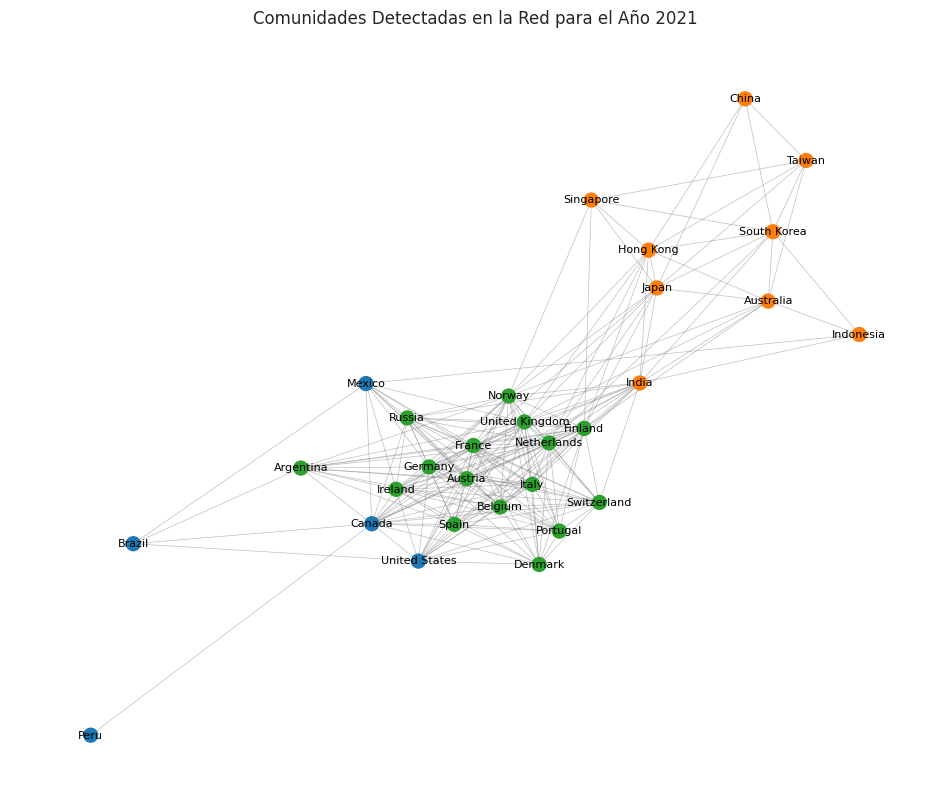

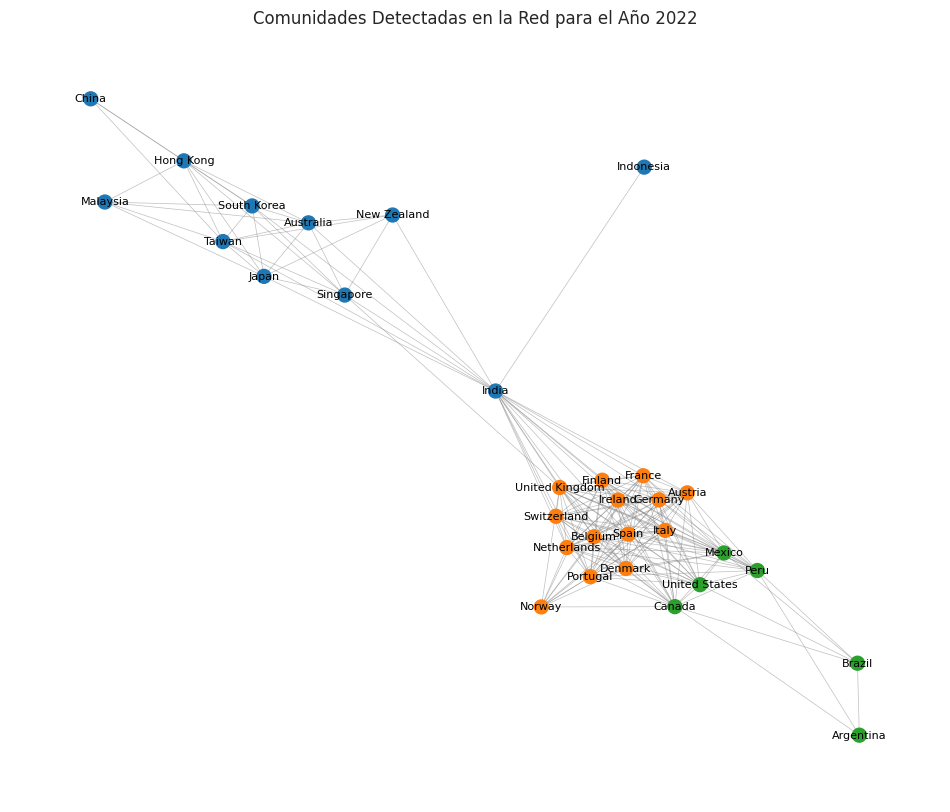

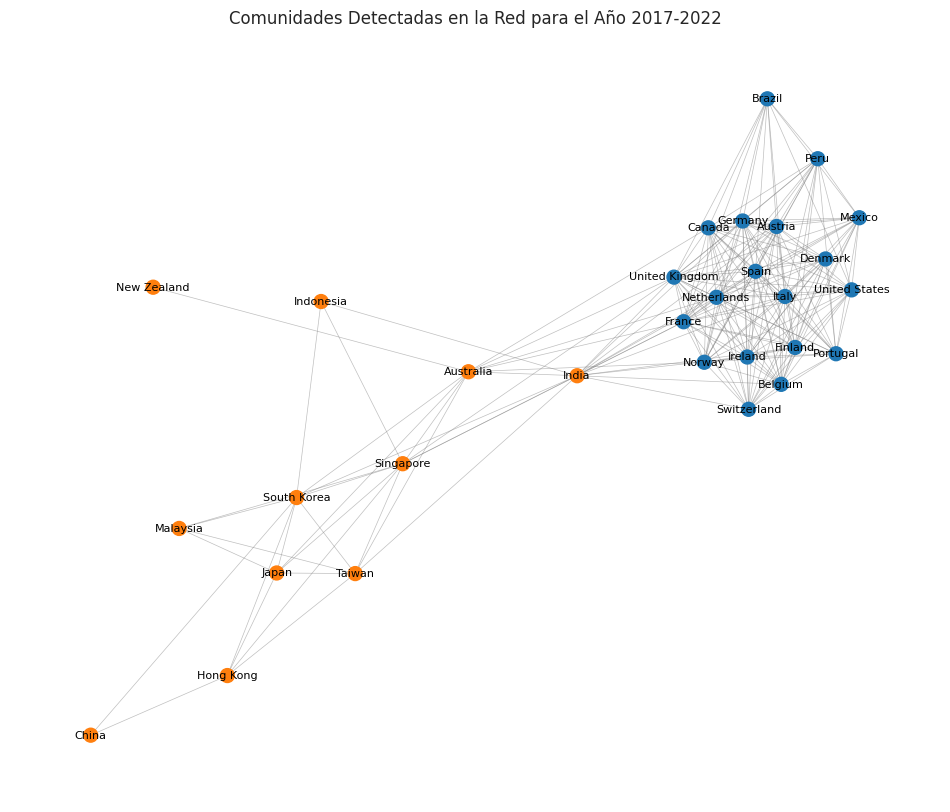

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import community.community_louvain as community_louvain  # Importación corregida para el algoritmo de Louvain
import matplotlib.colors as mcolors

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Colores para las comunidades
colors = list(mcolors.TABLEAU_COLORS.values())  # Usar colores de Tableau para las comunidades

# Visualización de las comunidades por cada año
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación para el año y usarla como umbral
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo global usando el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:  # Conectar si la correlación es mayor o igual al umbral
                graph.add_edge(i, j, weight=correlation)

    # Detección de comunidades usando el algoritmo de Louvain
    partition = community_louvain.best_partition(graph, weight='weight')

    # Asignar colores a las comunidades
    community_color_map = {node: colors[community % len(colors)] for node, community in partition.items()}

    # Posiciones de los nodos para el grafo
    pos = nx.spring_layout(graph, seed=42)  # Diseño "spring" para una mejor visualización

    # Dibujar el grafo
    plt.figure(figsize=(12, 10))
    nx.draw_networkx_nodes(graph, pos, node_size=100, node_color=[community_color_map[node] for node in graph.nodes()])
    nx.draw_networkx_edges(graph, pos, alpha=0.5, edge_color="gray", width=0.5)
    nx.draw_networkx_labels(graph, pos, font_size=8, font_color="black")

    # Configuración del gráfico
    plt.title(f"Comunidades Detectadas en la Red para el Año {year}")
    plt.axis("off")
    plt.show()


In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import community.community_louvain as community_louvain

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Diccionario para almacenar los nodos centrales por año y comunidad
central_nodes_by_year = {}

# Iterar sobre cada año para detectar comunidades y calcular métricas de centralidad
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación para el año y usarla como umbral
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo global usando el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:  # Conectar si la correlación es mayor o igual al umbral
                graph.add_edge(i, j, weight=correlation)

    # Detección de comunidades usando el algoritmo de Louvain
    partition = community_louvain.best_partition(graph, weight='weight')
    communities = {}  # Diccionario para almacenar nodos por comunidad

    # Agrupar nodos por comunidad
    for node, community in partition.items():
        if community not in communities:
            communities[community] = []
        communities[community].append(node)

    # Calcular métricas de centralidad
    degree_centrality = nx.degree_centrality(graph)
    betweenness_centrality = nx.betweenness_centrality(graph, weight='weight')
    eigenvector_centrality = nx.eigenvector_centrality(graph, max_iter=1000, tol=1e-06)

    # Identificar los nodos centrales en cada comunidad
    central_nodes_by_year[year] = {}
    for community, nodes in communities.items():
        # Filtrar métricas para los nodos de la comunidad actual
        community_degree = {node: degree_centrality[node] for node in nodes}
        community_betweenness = {node: betweenness_centrality[node] for node in nodes}
        community_eigenvector = {node: eigenvector_centrality[node] for node in nodes}

        # Identificar el nodo con la mayor centralidad en cada métrica
        central_node_degree = max(community_degree, key=community_degree.get)
        central_node_betweenness = max(community_betweenness, key=community_betweenness.get)
        central_node_eigenvector = max(community_eigenvector, key=community_eigenvector.get)

        # Guardar los nodos centrales en el diccionario
        central_nodes_by_year[year][community] = {
            'degree': (central_node_degree, community_degree[central_node_degree]),
            'betweenness': (central_node_betweenness, community_betweenness[central_node_betweenness]),
            'eigenvector': (central_node_eigenvector, community_eigenvector[central_node_eigenvector])
        }

# Mostrar los nodos centrales por cada año y comunidad
for year, communities in central_nodes_by_year.items():
    print(f"\nAño {year}:")
    for community, central_nodes in communities.items():
        print(f"  Comunidad {community}:")
        print(f"    Nodo central (Grado): {central_nodes['degree'][0]} - Valor: {central_nodes['degree'][1]:.4f}")
        print(f"    Nodo central (Intermediación): {central_nodes['betweenness'][0]} - Valor: {central_nodes['betweenness'][1]:.4f}")
        print(f"    Nodo central (Eigenvector): {central_nodes['eigenvector'][0]} - Valor: {central_nodes['eigenvector'][1]:.4f}")



Año 2017:
  Comunidad 0:
    Nodo central (Grado): Japan - Valor: 0.5333
    Nodo central (Intermediación): Japan - Valor: 0.1540
    Nodo central (Eigenvector): Japan - Valor: 0.1881
  Comunidad 1:
    Nodo central (Grado): United Kingdom - Valor: 0.7333
    Nodo central (Intermediación): United Kingdom - Valor: 0.0828
    Nodo central (Eigenvector): Austria - Valor: 0.2604
  Comunidad 2:
    Nodo central (Grado): Norway - Valor: 0.6667
    Nodo central (Intermediación): Canada - Valor: 0.1126
    Nodo central (Eigenvector): Norway - Valor: 0.2513

Año 2018:
  Comunidad 0:
    Nodo central (Grado): Taiwan - Valor: 0.6774
    Nodo central (Intermediación): Japan - Valor: 0.1226
    Nodo central (Eigenvector): Taiwan - Valor: 0.2197
  Comunidad 2:
    Nodo central (Grado): France - Valor: 0.7742
    Nodo central (Intermediación): Netherlands - Valor: 0.0366
    Nodo central (Eigenvector): France - Valor: 0.2683
  Comunidad 1:
    Nodo central (Grado): Brazil - Valor: 0.0645
    Nodo ce

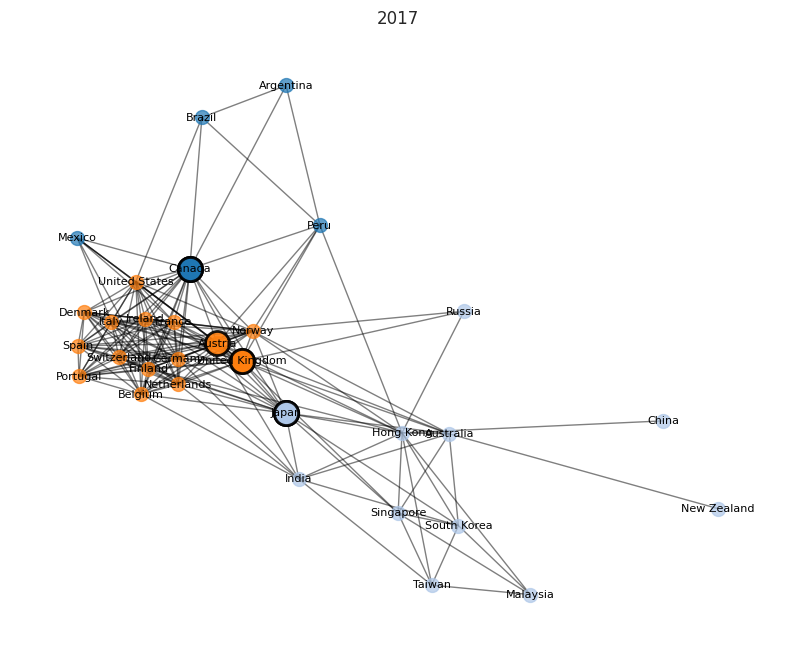

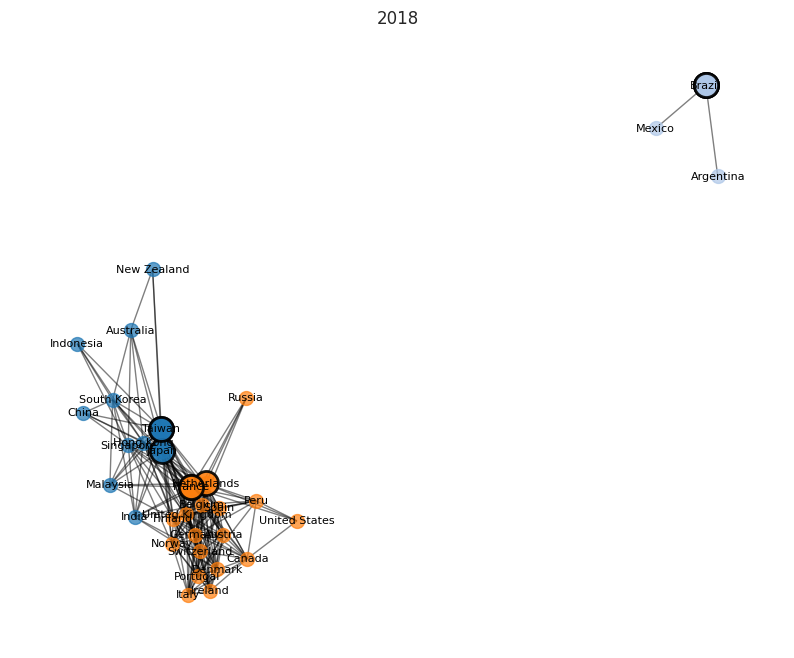

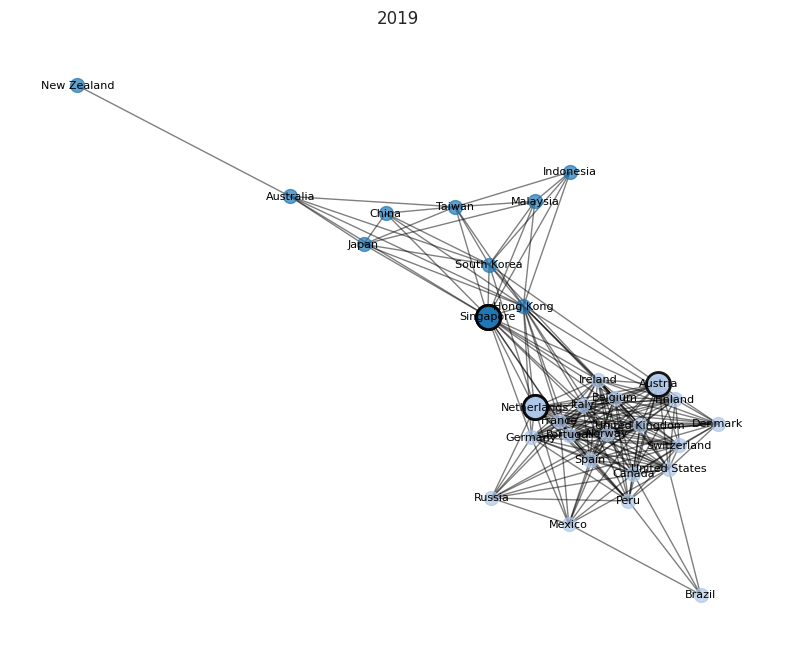

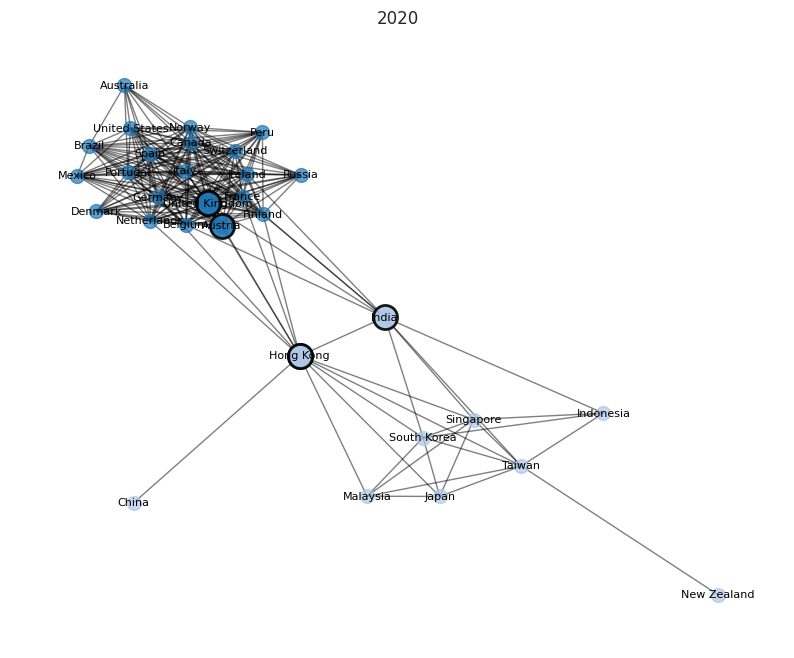

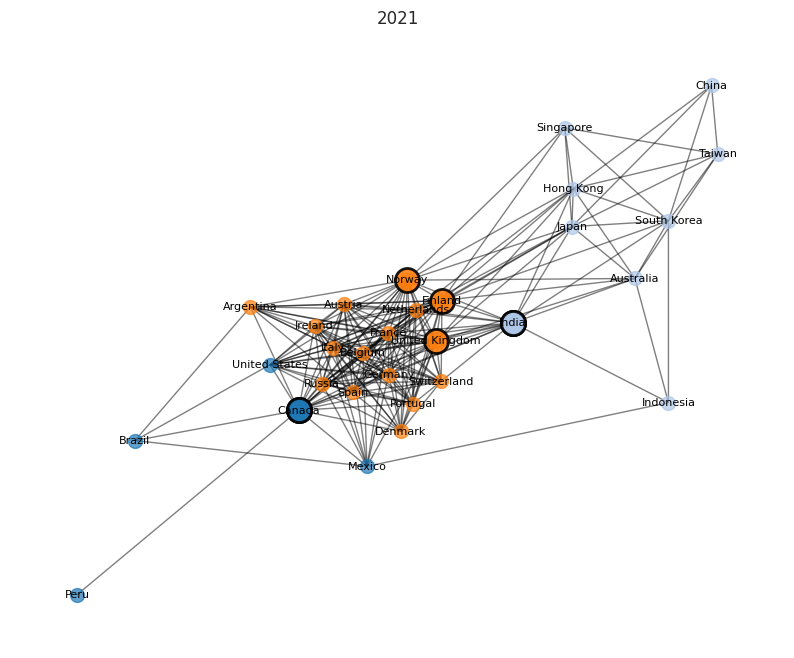

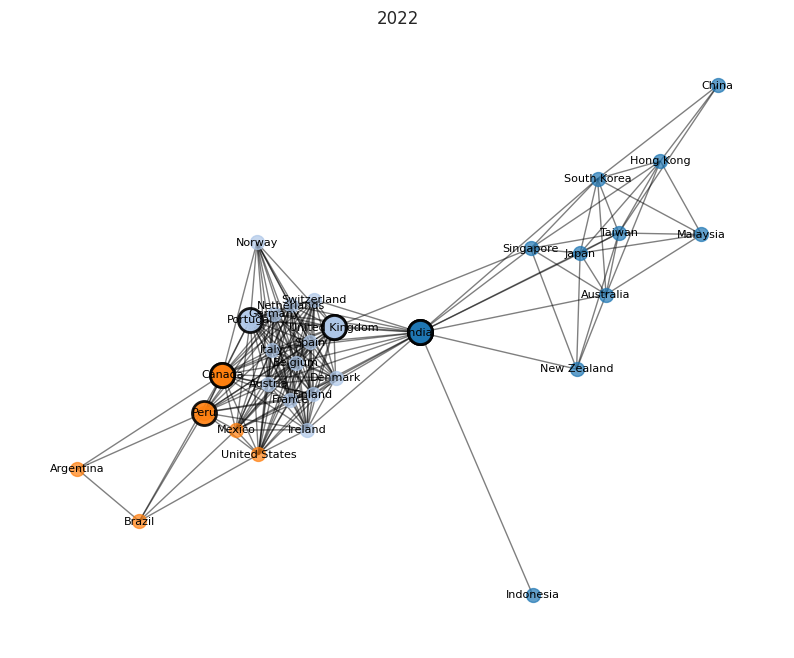

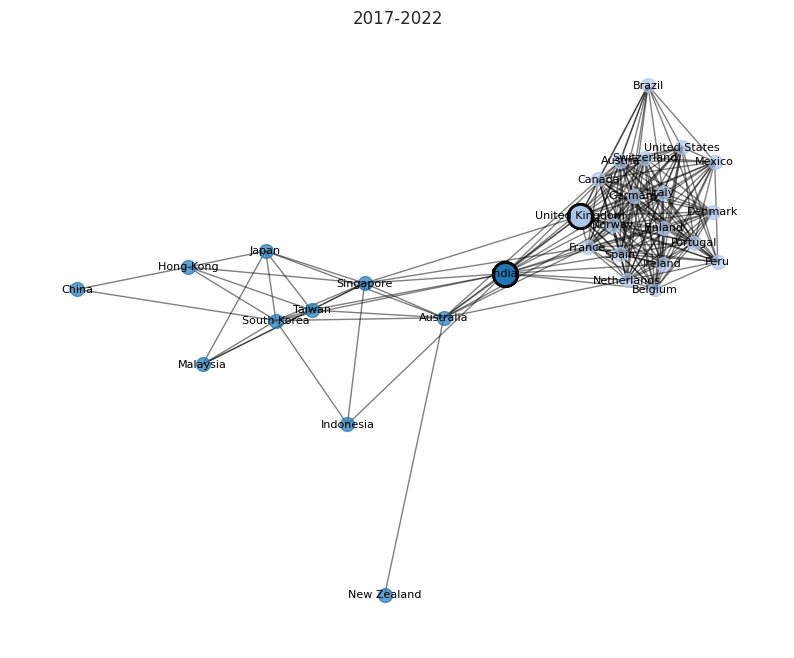

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import community.community_louvain as community_louvain

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Diccionario para almacenar los nodos centrales por año y comunidad
central_nodes_by_year = {}

# Iterar sobre cada año para detectar comunidades, calcular métricas y visualizar
for year, correlation_matrix in correlation_matrices.items():
    # Calcular la media de correlación para el año y usarla como umbral
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo global usando el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:  # Conectar si la correlación es mayor o igual al umbral
                graph.add_edge(i, j, weight=correlation)

    # Detección de comunidades usando el algoritmo de Louvain
    partition = community_louvain.best_partition(graph, weight='weight')
    communities = {}  # Diccionario para almacenar nodos por comunidad

    # Agrupar nodos por comunidad
    for node, community in partition.items():
        if community not in communities:
            communities[community] = []
        communities[community].append(node)

    # Calcular métricas de centralidad
    degree_centrality = nx.degree_centrality(graph)
    betweenness_centrality = nx.betweenness_centrality(graph, weight='weight')
    eigenvector_centrality = nx.eigenvector_centrality(graph, max_iter=1000, tol=1e-06)

    # Identificar los nodos centrales en cada comunidad
    central_nodes_by_year[year] = {}
    for community, nodes in communities.items():
        # Filtrar métricas para los nodos de la comunidad actual
        community_degree = {node: degree_centrality[node] for node in nodes}
        community_betweenness = {node: betweenness_centrality[node] for node in nodes}
        community_eigenvector = {node: eigenvector_centrality[node] for node in nodes}

        # Identificar el nodo con la mayor centralidad en cada métrica
        central_node_degree = max(community_degree, key=community_degree.get)
        central_node_betweenness = max(community_betweenness, key=community_betweenness.get)
        central_node_eigenvector = max(community_eigenvector, key=community_eigenvector.get)

        # Guardar los nodos centrales en el diccionario
        central_nodes_by_year[year][community] = {
            'degree': (central_node_degree, community_degree[central_node_degree]),
            'betweenness': (central_node_betweenness, community_betweenness[central_node_betweenness]),
            'eigenvector': (central_node_eigenvector, community_eigenvector[central_node_eigenvector])
        }

    # Visualización del grafo con hubs resaltados
    pos = nx.spring_layout(graph)  # Posición de los nodos

    # Colores para cada comunidad
    community_colors = {community: plt.cm.tab20(community) for community in communities.keys()}
    plt.figure(figsize=(10, 8))

    # Dibujar los nodos, coloreados por comunidad
    for community, nodes in communities.items():
        nx.draw_networkx_nodes(graph, pos, nodelist=nodes, node_color=[community_colors[community]],
                               node_size=100, alpha=0.7)

    # Resaltar los hubs de cada comunidad
    for community, central_nodes in central_nodes_by_year[year].items():
        hub_nodes = [central_nodes['degree'][0], central_nodes['betweenness'][0], central_nodes['eigenvector'][0]]
        nx.draw_networkx_nodes(graph, pos, nodelist=hub_nodes, node_color=[community_colors[community]],
                               node_size=300, edgecolors='black', linewidths=2, alpha=0.9)

    # Dibujar aristas y etiquetas
    nx.draw_networkx_edges(graph, pos, alpha=0.5)
    nx.draw_networkx_labels(graph, pos, font_size=8)

    # Configuración del título y mostrar el gráfico
    plt.title(f"{year}")
    plt.axis("off")
    plt.show()


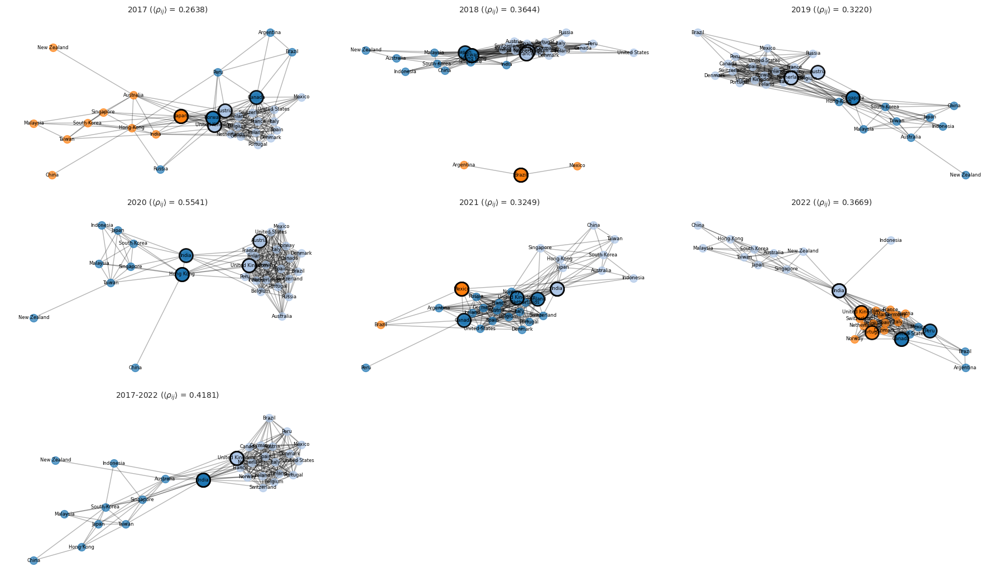

In [ ]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import community.community_louvain as community_louvain

# Ruta del archivo con las matrices de correlación
file_path = '/content/correlation_matrices_2017_2022.xlsx'

# Leer todas las hojas del archivo de Excel en un diccionario
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# Configurar una cuadrícula optimizada según el número de gráficos
n_graphs = len(correlation_matrices)
n_rows = (n_graphs + 2) // 3  # Determina el número de filas de forma flexible
fig, axes = plt.subplots(n_rows, 3, figsize=(18, 3.5 * n_rows))
fig.subplots_adjust(hspace=0.5, wspace=0.3)
axes = axes.flatten()

# Iterar sobre cada año para detectar comunidades, calcular métricas y visualizar
for idx, (year, correlation_matrix) in enumerate(correlation_matrices.items()):
    # Calcular la media de correlación para el año y usarla como umbral
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Crear el grafo global usando el umbral de correlación promedio
    graph = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, correlation in row.items():
            if i != j and correlation >= avg_correlation:  # Conectar si la correlación es mayor o igual al umbral
                graph.add_edge(i, j, weight=correlation)

    # Detección de comunidades usando el algoritmo de Louvain
    partition = community_louvain.best_partition(graph, weight='weight')
    communities = {}  # Diccionario para almacenar nodos por comunidad

    # Agrupar nodos por comunidad
    for node, community in partition.items():
        if community not in communities:
            communities[community] = []
        communities[community].append(node)

    # Calcular métricas de centralidad
    degree_centrality = nx.degree_centrality(graph)
    betweenness_centrality = nx.betweenness_centrality(graph, weight='weight')
    eigenvector_centrality = nx.eigenvector_centrality(graph, max_iter=1000, tol=1e-06)

    # Identificar los nodos centrales en cada comunidad
    central_nodes_by_year = {}
    for community, nodes in communities.items():
        community_degree = {node: degree_centrality[node] for node in nodes}
        community_betweenness = {node: betweenness_centrality[node] for node in nodes}
        community_eigenvector = {node: eigenvector_centrality[node] for node in nodes}

        # Identificar el nodo con la mayor centralidad en cada métrica
        central_node_degree = max(community_degree, key=community_degree.get)
        central_node_betweenness = max(community_betweenness, key=community_betweenness.get)
        central_node_eigenvector = max(community_eigenvector, key=community_eigenvector.get)

        central_nodes_by_year[community] = {
            'degree': central_node_degree,
            'betweenness': central_node_betweenness,
            'eigenvector': central_node_eigenvector
        }

    # Visualización en el subgráfico correspondiente
    pos = nx.spring_layout(graph, seed=42)  # Configurar posición con distribución por primavera
    ax = axes[idx]
    community_colors = {community: plt.cm.tab20(community) for community in communities.keys()}

    # Dibujar los nodos de cada comunidad
    for community, nodes in communities.items():
        nx.draw_networkx_nodes(graph, pos, nodelist=nodes, node_color=[community_colors[community]],
                               node_size=100, alpha=0.7, ax=ax)

    # Resaltar los hubs de cada comunidad
    for community, central_nodes in central_nodes_by_year.items():
        hub_nodes = [
            central_nodes['degree'],
            central_nodes['betweenness'],
            central_nodes['eigenvector']
        ]
        nx.draw_networkx_nodes(graph, pos, nodelist=hub_nodes, node_color=[community_colors[community]],
                               node_size=300, edgecolors='black', linewidths=2, alpha=0.9, ax=ax)

    # Dibujar aristas y etiquetas
    nx.draw_networkx_edges(graph, pos, alpha=0.3, ax=ax)
    nx.draw_networkx_labels(graph, pos, font_size=6, ax=ax)

    # Título de cada subgráfico con el año y el umbral promedio
    ax.set_title(f"{year} ($\\langle \\rho_{{ij}} \\rangle$ = {avg_correlation:.4f})", fontsize=10)
    ax.axis("off")

# Ocultar subgráficos adicionales en la última fila sin datos
for ax in axes[n_graphs:]:
    ax.axis("off")

#plt.suptitle("Community Graphs by Year (Threshold: Average Correlation)", fontsize=16, y=1.02)
plt.tight_layout()
# Guardar la figura en formato EPS y PDF
plt.savefig("community_graphs.eps", format="eps", bbox_inches="tight")
plt.savefig("community_graphs.pdf", format="pdf", bbox_inches="tight")

plt.show()

#ANALISIS DINÁMICO CURVATURA DE RICCI

In [ ]:
# # colab setting
!pip install GraphRicciCurvature
!pip install scikit-learn

In [ ]:

import networkx as nx
import numpy as np
import math
import importlib

# matplotlib setting
%matplotlib inline
import matplotlib.pyplot as plt

# to print logs in jupyter notebook
import logging
logging.basicConfig(format='%(levelname)s:%(message)s', level=logging.ERROR)

# load GraphRicciCuravture package
from GraphRicciCurvature.OllivierRicci import OllivierRicci

# load python-louvain for modularity computation
import community as community_louvain

# for ARI computation
from sklearn import preprocessing, metrics


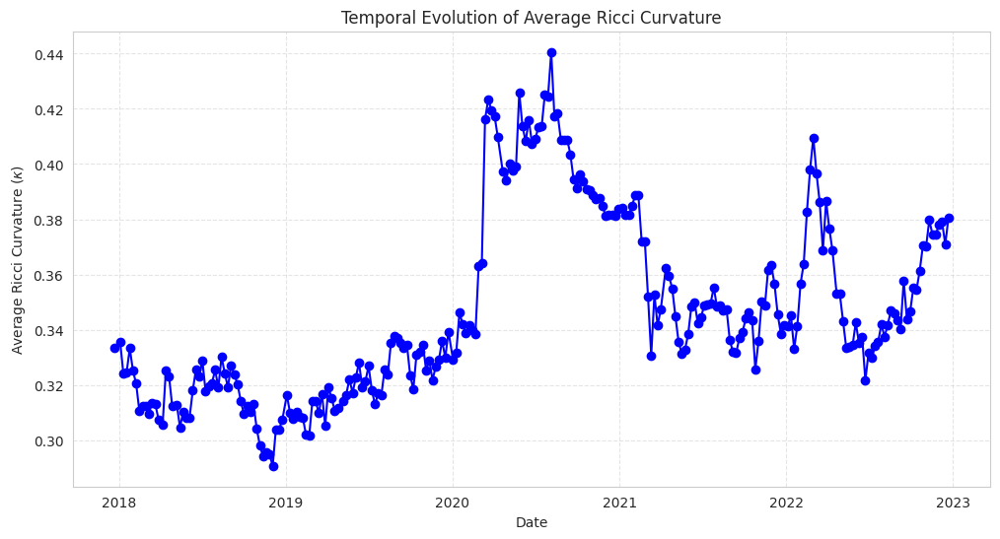

In [ ]:
import pandas as pd
import numpy as np
import networkx as nx
from GraphRicciCurvature.OllivierRicci import OllivierRicci
import matplotlib.pyplot as plt

# Load the log returns data
file_path = '/content/log_returns_global_stock_indices_data.xlsx'
data = pd.read_excel(file_path, index_col=0)  # Ensure the date column is the index
data.index = pd.to_datetime(data.index)

# Parameters for sliding window
window_size = 250  # 22 days (approx. 1 month)
shift = 5        # 5 days (overlapping)
ricci_curvature_results = []
dates = []

# Sliding window over the data
for start in range(0, len(data) - window_size, shift):
    end = start + window_size
    window_data = data.iloc[start:end]
    dates.append(window_data.index[-1])  # Capture the end date for each window

    # Compute the correlation matrix for this window
    correlation_matrix = window_data.corr()

    # Thresholding the correlation matrix at the average correlation in the window
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()
    thresholded_edges = [(i, j, correlation_matrix.iat[i, j])
                         for i in range(len(correlation_matrix))
                         for j in range(i + 1, len(correlation_matrix))
                         if correlation_matrix.iat[i, j] >= avg_correlation]

    # Construct the graph
    graph = nx.Graph()
    for (i, j, weight) in thresholded_edges:
        graph.add_edge(correlation_matrix.index[i], correlation_matrix.index[j], weight=weight)

    # Calculate Ricci curvature using Ollivier-Ricci method
    if graph.number_of_edges() > 0:
        orc = OllivierRicci(graph, alpha=0.5, method="OTD")
        orc.compute_ricci_curvature()

        # Calculate the average Ricci curvature for the window
        avg_ricci_curvature = np.mean([data['ricciCurvature'] for _, _, data in orc.G.edges(data=True)])
        ricci_curvature_results.append(avg_ricci_curvature)
    else:
        ricci_curvature_results.append(np.nan)  # Handle cases with no edges

# Convert results to DataFrame for easy plotting
ricci_df = pd.DataFrame({'Date': dates, 'Average_Ricci_Curvature': ricci_curvature_results})
ricci_df.set_index('Date', inplace=True)

# Plotting the temporal evolution of Ricci curvature
plt.figure(figsize=(12, 6))
plt.plot(ricci_df.index, ricci_df['Average_Ricci_Curvature'], marker='o', color='b')
plt.title("Temporal Evolution of Average Ricci Curvature")
plt.xlabel("Date")
plt.ylabel("Average Ricci Curvature ($\\kappa$)")
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


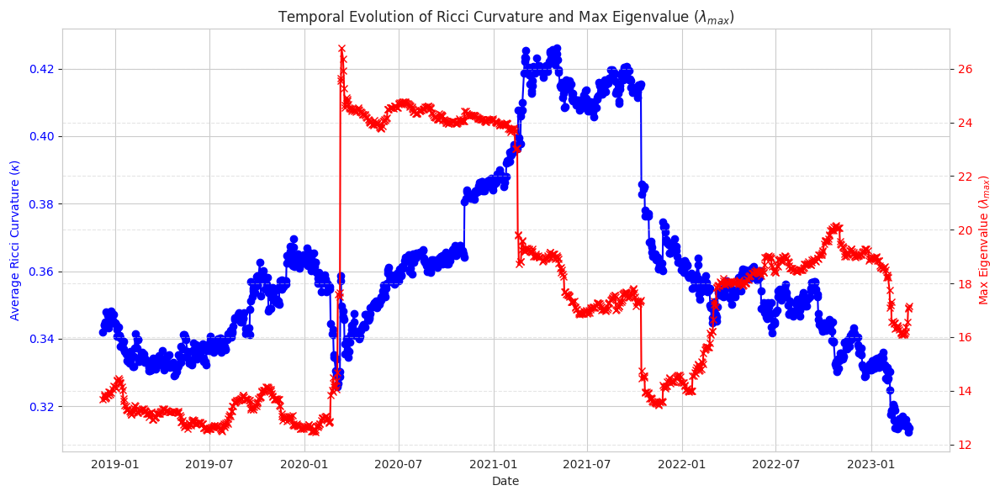

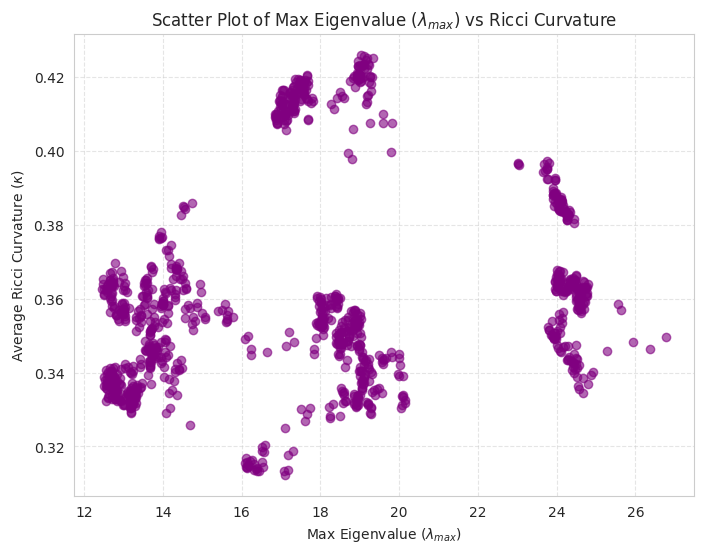

In [ ]:
import pandas as pd
import numpy as np
import networkx as nx
from GraphRicciCurvature.OllivierRicci import OllivierRicci
import matplotlib.pyplot as plt

# Load the log returns data
file_path = '/content/log_ret_stocks_orderticket_spain.xlsx'
data = pd.read_excel(file_path, index_col=0)  # Ensure the date column is the index
data.index = pd.to_datetime(data.index)

# Parameters for sliding window
window_size = 240  # 22 days (approx. 1 month)
shift = 1         # 5 days (overlapping)
ricci_curvature_results = []
max_eigenvalues = []
dates = []

# Sliding window over the data
for start in range(0, len(data) - window_size, shift):
    end = start + window_size
    window_data = data.iloc[start:end]
    dates.append(window_data.index[-1])  # Capture the end date for each window

    # Compute the correlation matrix for this window
    correlation_matrix = window_data.corr()

    # Calculate the maximum eigenvalue of the correlation matrix (Random Matrix Theory)
    eigenvalues = np.linalg.eigvalsh(correlation_matrix)
    lambda_max = np.max(eigenvalues)
    max_eigenvalues.append(lambda_max)

    # Thresholding the correlation matrix at the average correlation in the window
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()
    thresholded_edges = [(i, j, correlation_matrix.iat[i, j])
                         for i in range(len(correlation_matrix))
                         for j in range(i + 1, len(correlation_matrix))
                         if correlation_matrix.iat[i, j] >= avg_correlation]

    # Construct the graph
    graph = nx.Graph()
    for (i, j, weight) in thresholded_edges:
        graph.add_edge(correlation_matrix.index[i], correlation_matrix.index[j], weight=weight)

    # Calculate Ricci curvature using Ollivier-Ricci method
    if graph.number_of_edges() > 0:
        orc = OllivierRicci(graph, alpha=0.5, method="OTD")
        orc.compute_ricci_curvature()

        # Calculate the average Ricci curvature for the window
        avg_ricci_curvature = np.mean([data['ricciCurvature'] for _, _, data in orc.G.edges(data=True)])
        ricci_curvature_results.append(avg_ricci_curvature)
    else:
        ricci_curvature_results.append(np.nan)  # Handle cases with no edges

# Convert results to DataFrame for easy plotting
results_df = pd.DataFrame({
    'Date': dates,
    'Average_Ricci_Curvature': ricci_curvature_results,
    'Max_Eigenvalue': max_eigenvalues
})
results_df.set_index('Date', inplace=True)

# Plotting the temporal evolution of Ricci curvature and maximum eigenvalue
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot Ricci Curvature
ax1.plot(results_df.index, results_df['Average_Ricci_Curvature'], marker='o', color='b', label='Ricci Curvature')
ax1.set_xlabel("Date")
ax1.set_ylabel("Average Ricci Curvature ($\\kappa$)", color='b')
ax1.tick_params(axis='y', labelcolor='b')

# Create a second y-axis for max eigenvalue
ax2 = ax1.twinx()
ax2.plot(results_df.index, results_df['Max_Eigenvalue'], marker='x', color='r', label='Max Eigenvalue ($\\lambda_{max}$)')
ax2.set_ylabel("Max Eigenvalue ($\\lambda_{max}$)", color='r')
ax2.tick_params(axis='y', labelcolor='r')

# Add titles and grid
plt.title("Temporal Evolution of Ricci Curvature and Max Eigenvalue ($\\lambda_{max}$)")
fig.tight_layout()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Scatter Plot: Max Eigenvalue vs Ricci Curvature
plt.figure(figsize=(8, 6))
plt.scatter(results_df['Max_Eigenvalue'], results_df['Average_Ricci_Curvature'], color='purple', alpha=0.6)
plt.title("Scatter Plot of Max Eigenvalue ($\\lambda_{max}$) vs Ricci Curvature")
plt.xlabel("Max Eigenvalue ($\\lambda_{max}$)")
plt.ylabel("Average Ricci Curvature ($\\kappa$)")
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


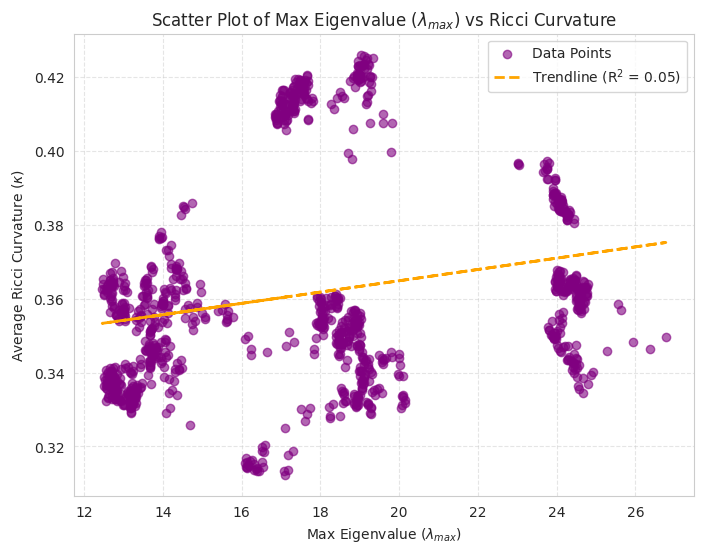

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# Extract max eigenvalue and Ricci curvature for linear regression
x = results_df['Max_Eigenvalue'].values.reshape(-1, 1)
y = results_df['Average_Ricci_Curvature'].values

# Fit linear regression model
model = LinearRegression().fit(x, y)
y_pred = model.predict(x)

# Calculate R^2
r2 = r2_score(y, y_pred)

# Scatter Plot with trendline and R^2
plt.figure(figsize=(8, 6))
plt.scatter(x, y, color='purple', alpha=0.6, label="Data Points")
plt.plot(x, y_pred, linestyle='--',color='orange', linewidth=2, label=f"Trendline (R$^2$ = {r2:.2f})")

# Plot formatting
plt.title("Scatter Plot of Max Eigenvalue ($\\lambda_{max}$) vs Ricci Curvature")
plt.xlabel("Max Eigenvalue ($\\lambda_{max}$)")
plt.ylabel("Average Ricci Curvature ($\\kappa$)")
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


#ANALISIS REDES ANUALES (RICCI+EULER+RMT)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!pip install GraphRicciCurvature
!pip install scikit-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 21.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 897.5/897.5 kB 26.5 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
import networkx as nx
from GraphRicciCurvature.OllivierRicci import OllivierRicci

# 1. Read correlation matrices (one sheet per year) from Excel
file_path = '/content/correlation_matrices_2017_2022-out-averall.xlsx'
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# 2. Define dictionaries to store results for each year
average_correlations_by_year = {}
max_eigenvalues_by_year = {}
euler_characteristics_by_year = {}
ricci_curvatures_by_year = {}

# 3. Define a helper function to convert correlation to distance
def correlation_to_distance(correlation):
    return np.sqrt(2 * (1 - correlation))

# 4. Loop through each year’s correlation matrix
for year, correlation_matrix in correlation_matrices.items():
    # --- (A) Average Correlation ---
    avg_correlation = correlation_matrix.values.mean()
    average_correlations_by_year[year] = avg_correlation

    # --- (B) Maximum Eigenvalue ---
    eigenvalues = np.linalg.eigvalsh(correlation_matrix.values)
    lambda_max = np.max(eigenvalues)
    max_eigenvalues_by_year[year] = lambda_max

    # --- (C) Build Graph for Euler Characteristic & Ricci ---
    #     We add an edge if correlation >= avg_correlation
    #     => distance <= distance_threshold
    distance_threshold = correlation_to_distance(avg_correlation)

    G = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, corr_value in row.items():
            if i != j and corr_value >= avg_correlation:
                distance = correlation_to_distance(corr_value)
                if distance <= distance_threshold:
                    # Add the edge with a 'weight' for Ricci curvature
                    G.add_edge(i, j, weight=distance)

    # --- (D) Euler Characteristic ---
    # V = number_of_nodes, E = number_of_edges, C = connected_components
    V = G.number_of_nodes()
    E = G.number_of_edges()
    C = nx.number_connected_components(G)
    euler_characteristic = V - E + C
    euler_characteristics_by_year[year] = euler_characteristic

    # --- (E) Ricci Curvature ---
    if E == 0:
        # If no edges, skip Ricci
        ricci_curvatures_by_year[year] = np.nan
    else:
        orc = OllivierRicci(G, alpha=0.5, method="OTD", verbose="TRACE")
        orc.compute_ricci_curvature()
        # Average Ricci curvature across all edges
        avg_ricci_curv = np.mean([data['ricciCurvature'] for _, _, data in orc.G.edges(data=True)])
        ricci_curvatures_by_year[year] = avg_ricci_curv

    # --- (F) Print Results for this Year ---
    print(f"=== Año {year} ===")
    print(f"  - Avg Correlation:         {avg_correlation:.4f}")
    print(f"  - Max Eigenvalue (λ_max):  {lambda_max:.4f}")
    print(f"  - Euler Characteristic (χ): {euler_characteristic}")
    if E > 0:
        print(f"  - Avg Ricci Curvature (κ): {avg_ricci_curv:.4f}")
    else:
        print("  - No edges => Ricci Curvature is NaN or undefined.")
    print()

# 5. Final dictionaries with results
print("Average Correlations by Year:", average_correlations_by_year)
print("Max Eigenvalues by Year:", max_eigenvalues_by_year)
print("Euler Characteristics by Year:", euler_characteristics_by_year)
print("Ricci Curvatures by Year:", ricci_curvatures_by_year)


TRACE:GraphRicciCurvature:Number of nodes: 31
TRACE:GraphRicciCurvature:Number of edges: 175
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.001350 secs for all pair by NetworKit.
INFO:GraphRicciCurvature:0.113386 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 181
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.000653 secs for all pair by NetworKit.


=== Año 2017 ===
  - Avg Correlation:         0.2868
  - Max Eigenvalue (λ_max):  10.5843
  - Euler Characteristic (χ): -143
  - Avg Ricci Curvature (κ): 0.3386



INFO:GraphRicciCurvature:0.117720 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 185
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.000917 secs for all pair by NetworKit.


=== Año 2018 ===
  - Avg Correlation:         0.3843
  - Max Eigenvalue (λ_max):  13.2871
  - Euler Characteristic (χ): -149
  - Avg Ricci Curvature (κ): 0.3248



INFO:GraphRicciCurvature:0.116248 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 31
TRACE:GraphRicciCurvature:Number of edges: 217
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.001462 secs for all pair by NetworKit.


=== Año 2019 ===
  - Avg Correlation:         0.3432
  - Max Eigenvalue (λ_max):  12.5245
  - Euler Characteristic (χ): -154
  - Avg Ricci Curvature (κ): 0.3519



INFO:GraphRicciCurvature:0.143960 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 184
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.001509 secs for all pair by NetworKit.


=== Año 2020 ===
  - Avg Correlation:         0.5681
  - Max Eigenvalue (λ_max):  18.7858
  - Euler Characteristic (χ): -185
  - Avg Ricci Curvature (κ): 0.4066



INFO:GraphRicciCurvature:0.126923 secs for Ricci curvature computation.
TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 191
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.002170 secs for all pair by NetworKit.


=== Año 2021 ===
  - Avg Correlation:         0.3460
  - Max Eigenvalue (λ_max):  12.3236
  - Euler Characteristic (χ): -153
  - Avg Ricci Curvature (κ): 0.3549



INFO:GraphRicciCurvature:0.117633 secs for Ricci curvature computation.


=== Año 2022 ===
  - Avg Correlation:         0.3866
  - Max Eigenvalue (λ_max):  13.5760
  - Euler Characteristic (χ): -160
  - Avg Ricci Curvature (κ): 0.3762

Average Correlations by Year: {'2017': 0.28684323522256017, '2018': 0.3842556726579254, '2019': 0.3431718478227247, '2020': 0.5680765883190432, '2021': 0.3459987049829403, '2022': 0.3866380991535033}
Max Eigenvalues by Year: {'2017': 10.584349911232625, '2018': 13.287055767870406, '2019': 12.524544319609106, '2020': 18.78580699245189, '2021': 12.32362193531991, '2022': 13.576003058816987}
Euler Characteristics by Year: {'2017': -143, '2018': -149, '2019': -154, '2020': -185, '2021': -153, '2022': -160}
Ricci Curvatures by Year: {'2017': 0.3386072864008621, '2018': 0.32476770564972846, '2019': 0.3519135828996235, '2020': 0.40656358867527, '2021': 0.3548956089565017, '2022': 0.376163236994532}


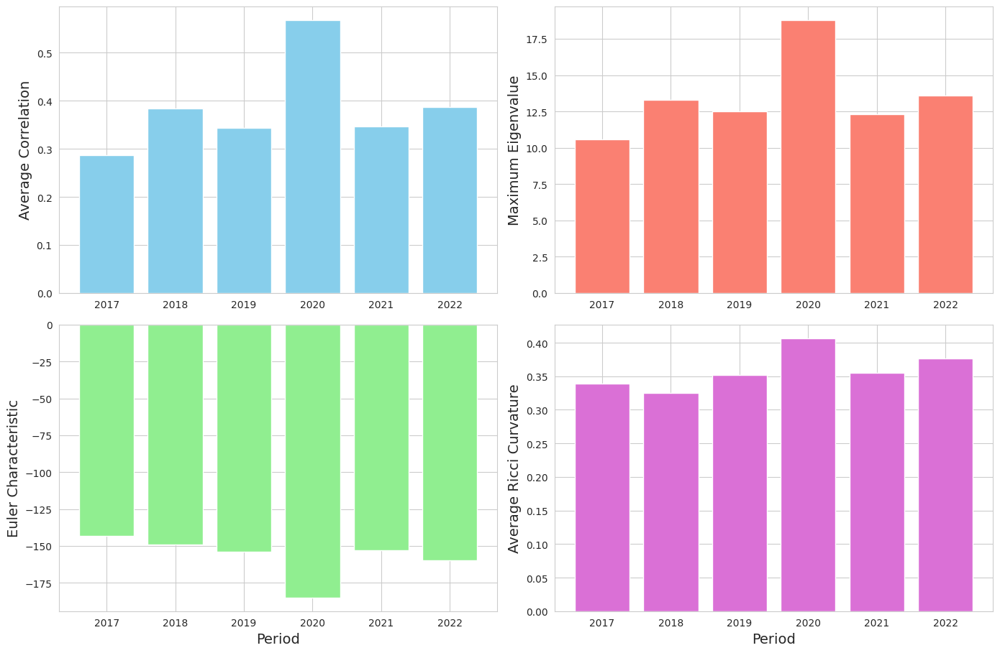

In [ ]:
import matplotlib.pyplot as plt

# Assume that the following dictionaries have been computed:
# average_correlations_by_year, max_eigenvalues_by_year,
# euler_characteristics_by_year, ricci_curvatures_by_year

# Extract sorted list of years and corresponding metric values
years = sorted(average_correlations_by_year.keys())
avg_corr = [average_correlations_by_year[year] for year in years]
max_eig = [max_eigenvalues_by_year[year] for year in years]
euler_char = [euler_characteristics_by_year[year] for year in years]
avg_ricci = [ricci_curvatures_by_year[year] for year in years]

# Create a 2x2 subplot figure
fig, axs = plt.subplots(2, 2, figsize=(14, 10))

# --- Average Correlation ---
axs[0, 0].bar(years, avg_corr, color='skyblue')
#axs[0, 0].set_title("Average Correlation")
#axs[0, 0].set_xlabel("Year")
axs[0, 0].set_ylabel("Average Correlation", fontsize=14)

# --- Maximum Eigenvalue ---
axs[0, 1].bar(years, max_eig, color='salmon')
#axs[0, 1].set_title("Maximum Eigenvalue (λ_max)")
#axs[0, 1].set_xlabel("Year")
axs[0, 1].set_ylabel("Maximum Eigenvalue", fontsize=14)

# --- Euler Characteristic ---
axs[1, 0].bar(years, euler_char, color='lightgreen')
#axs[1, 0].set_title("Euler Characteristic (χ)")
axs[1, 0].set_xlabel("Period",fontsize=14)
axs[1, 0].set_ylabel("Euler Characteristic",fontsize=14)

# --- Average Ricci Curvature ---
axs[1, 1].bar(years, avg_ricci, color='orchid')
#axs[1, 1].set_title("Average Ricci Curvature (κ)")
axs[1, 1].set_xlabel("Period",fontsize=14)
axs[1, 1].set_ylabel("Average Ricci Curvature",fontsize=14)

# Overall figure title and layout adjustments
#plt.suptitle("Annual Metrics Comparison (2017-2022)", fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


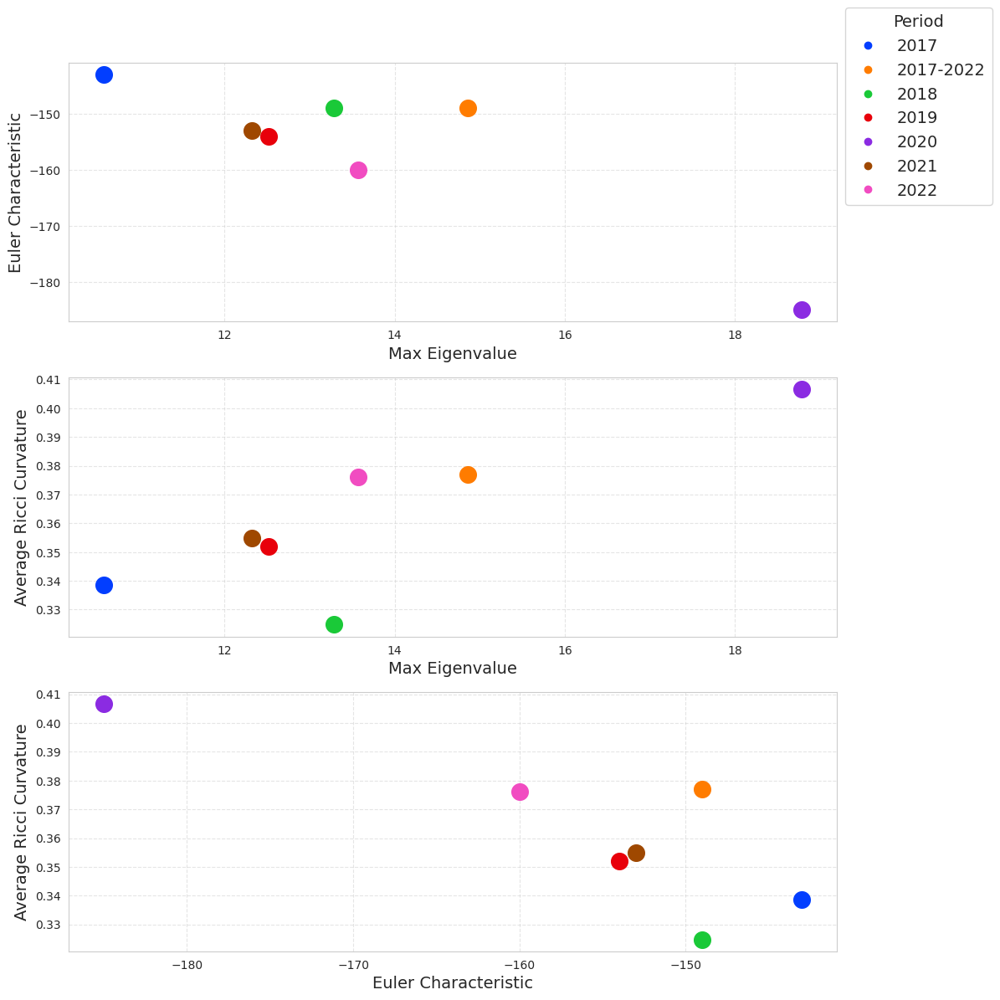

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# --- Suppose these dictionaries have been computed from your analysis ---
# average_correlations_by_year, max_eigenvalues_by_year,
# euler_characteristics_by_year, ricci_curvatures_by_year

# Create a DataFrame with annual metrics. Convert the year to string for categorical coloring.
years = sorted(average_correlations_by_year.keys())
df = pd.DataFrame({
    "Year": [str(year) for year in years],
    "Average Correlation": [average_correlations_by_year[year] for year in years],
    "Max Eigenvalue": [max_eigenvalues_by_year[year] for year in years],
    "Euler Characteristic": [euler_characteristics_by_year[year] for year in years],
    "Average Ricci Curvature": [ricci_curvatures_by_year[year] for year in years]
})

# Define pairs of variables to visualize
pairs = [
    #("Average Correlation", "Max Eigenvalue"),
    #("Average Correlation", "Euler Characteristic"),
    #("Average Correlation", "Average Ricci Curvature"),
    ("Max Eigenvalue", "Euler Characteristic"),
    ("Max Eigenvalue", "Average Ricci Curvature"),
    ("Euler Characteristic", "Average Ricci Curvature")
]

# Create a color dictionary for each year using a bright color palette.
unique_years = df["Year"].unique()
colors = sns.color_palette("bright", len(unique_years))
color_dict = dict(zip(unique_years, colors))

# Create subplots: a grid with 2 rows and 3 columns (one scatter plot per pair)
fig, axs = plt.subplots(3, 1, figsize=(12, 12))
axs = axs.flatten()

for i, (x_var, y_var) in enumerate(pairs):
    ax = axs[i]
    # Plot each year separately so that points are colored by year
    for year, group in df.groupby("Year"):
        ax.scatter(group[x_var], group[y_var],
                   color=color_dict[year],
                   s=200,
                   label=year)
    ax.set_xlabel(x_var, fontsize=14)
    ax.set_ylabel(y_var, fontsize=14)
    #ax.set_title(f"{y_var} vs. {x_var}", fontsize=14)
    ax.grid(True, linestyle="--", alpha=0.5)

# Create a single global legend for clarity.
handles = [plt.Line2D([], [], marker="o", linestyle="", color=color_dict[year], label=year)
           for year in unique_years]
fig.legend(handles=handles, loc="upper right", title="Period", fontsize=14, title_fontsize=14)

#plt.suptitle("Pairwise Scatter Plots of Annual Metrics (2017-2022)", fontsize=18)
plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


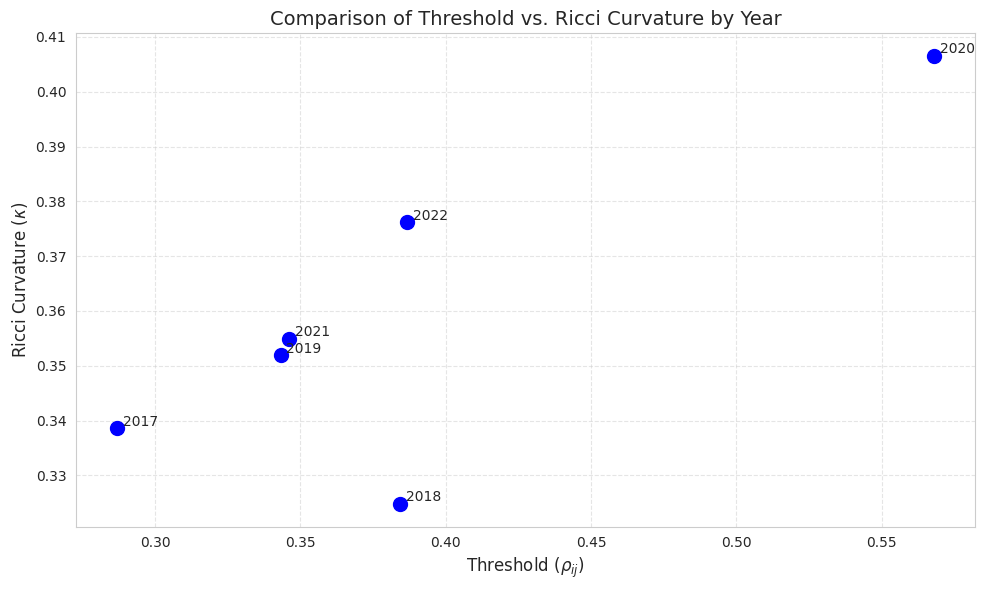

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Dictionaries of results
avg_corr_by_year = {
    '2017': 0.28684323522256017,
    '2018': 0.3842556726579254,
    '2019': 0.3431718478227247,
    '2020': 0.5680765883190432,
    '2021': 0.3459987049829403,
    '2022': 0.3866380991535033
}
ricci_by_year = {
    '2017': 0.3386072864008621,
    '2018': 0.32476770564972846,
    '2019': 0.3519135828996235,
    '2020': 0.40656358867527,
    '2021': 0.3548956089565017,
    '2022': 0.376163236994532
}

# Create a DataFrame for plotting
years = list(avg_corr_by_year.keys())
df = pd.DataFrame({
    "Year": years,
    "Threshold": [avg_corr_by_year[y] for y in years],
    "RicciCurv": [ricci_by_year[y] for y in years]
})

# Create the scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(df["Threshold"], df["RicciCurv"], color="blue", s=100)

# Add text labels (the year) near each point
for i, row in df.iterrows():
    plt.text(
        row["Threshold"] + 0.002,    # shift label slightly to the right
        row["RicciCurv"] + 0.0005,   # shift label slightly upward
        row["Year"],
        fontsize=10
    )

# Set axis labels and title
plt.xlabel("Threshold ($\\rho_{ij}$)", fontsize=12)
plt.ylabel("Ricci Curvature ($\\kappa$)", fontsize=12)
plt.title("Comparison of Threshold vs. Ricci Curvature by Year", fontsize=14)

# Add grid and layout
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


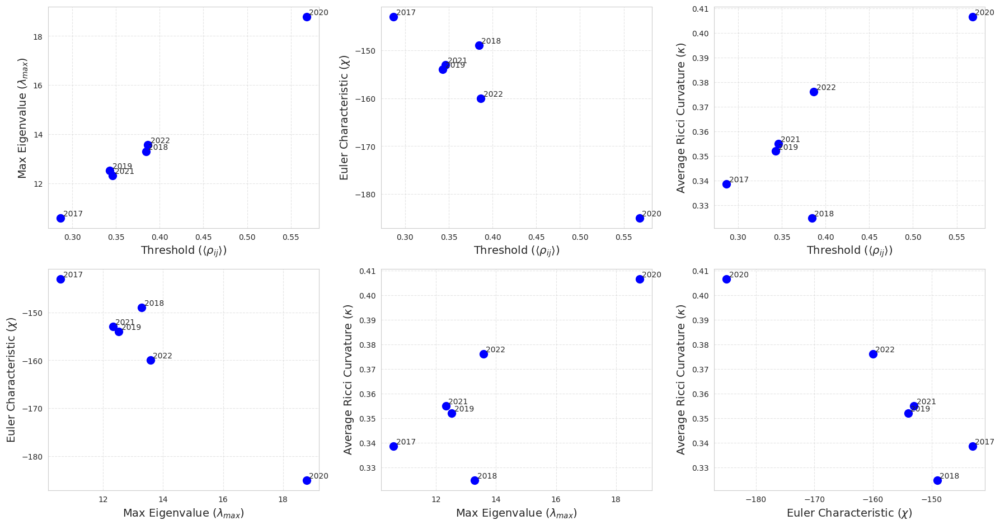

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# --- Your computed dictionaries ---
avg_corr_by_year = {
    '2017': 0.28684323522256017,
    '2018': 0.3842556726579254,
    '2019': 0.3431718478227247,
    '2020': 0.5680765883190432,
    '2021': 0.3459987049829403,
    '2022': 0.3866380991535033
}
max_eig_by_year = {
    '2017': 10.584349911232625,
    '2018': 13.287055767870406,
    '2019': 12.524544319609106,
    '2020': 18.78580699245189,
    '2021': 12.32362193531991,
    '2022': 13.576003058816987
}
euler_by_year = {
    '2017': -143,
    '2018': -149,
    '2019': -154,
    '2020': -185,
    '2021': -153,
    '2022': -160
}
ricci_by_year = {
    '2017': 0.3386072864008621,
    '2018': 0.32476770564972846,
    '2019': 0.3519135828996235,
    '2020': 0.40656358867527,
    '2021': 0.3548956089565017,
    '2022': 0.376163236994532
}

# 1. Create a DataFrame for plotting
years = sorted(avg_corr_by_year.keys(), key=lambda x: int(x))
df = pd.DataFrame({
    "Year": years,
    "Threshold": [avg_corr_by_year[y] for y in years],
    "MaxEigenvalue": [max_eig_by_year[y] for y in years],
    "EulerCharacteristic": [euler_by_year[y] for y in years],
    "RicciCurvature": [ricci_by_year[y] for y in years]
})

# 2. Define axis label mapping using LaTeX symbols
label_dict = {
    "Threshold": "Threshold ($\\langle \\rho_{ij} \\rangle$)",
    "MaxEigenvalue": "Max Eigenvalue ($\\lambda_{max}$)",
    "EulerCharacteristic": "Euler Characteristic ($\\chi$)",
    "RicciCurvature": "Average Ricci Curvature ($\\kappa$)"
}

# 3. Define all pairs of variables for subplots
pairs = [
    ("Threshold", "MaxEigenvalue"),
    ("Threshold", "EulerCharacteristic"),
    ("Threshold", "RicciCurvature"),
    ("MaxEigenvalue", "EulerCharacteristic"),
    ("MaxEigenvalue", "RicciCurvature"),
    ("EulerCharacteristic", "RicciCurvature")
]

# 4. Create a 2 x 3 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
axs = axs.flatten()

for i, (x_var, y_var) in enumerate(pairs):
    ax = axs[i]

    # Plot all points in blue
    ax.scatter(df[x_var], df[y_var], color="blue", s=100)

    # Calculate small offsets for text labels to avoid overlapping markers
    x_range = df[x_var].max() - df[x_var].min()
    y_range = df[y_var].max() - df[y_var].min()
    x_offset = 0.01 * x_range
    y_offset = 0.01 * y_range

    # Label each point with its Year
    for _, row in df.iterrows():
        ax.text(row[x_var] + x_offset, row[y_var] + y_offset, row["Year"], fontsize=10)

    # Set axes labels using our label_dict with LaTeX formatting
    ax.set_xlabel(label_dict[x_var], fontsize=14)
    ax.set_ylabel(label_dict[y_var], fontsize=14)
    ax.grid(True, linestyle='--', alpha=0.5)

# 5. Overall title and layout adjustments
#plt.suptitle("All Pairwise Comparisons of Annual Metrics (2017-2022)", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


Processing year: 2017


INFO:GraphRicciCurvature:0.113117 secs for Ricci curvature computation.


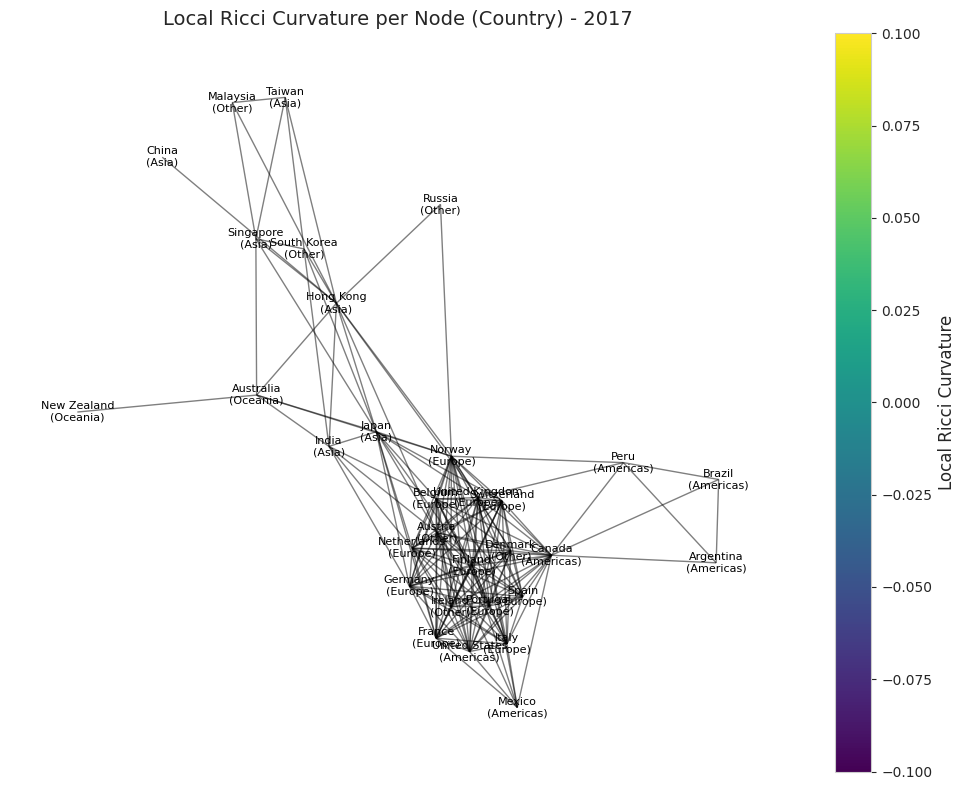

Year 2017 - Node Ricci Curvatures:
  Singapore (Asia): nan
  Japan (Asia): nan
  Malaysia (Other): nan
  South Korea (Other): nan
  Australia (Oceania): nan
  Hong Kong (Asia): nan
  Taiwan (Asia): nan
  United Kingdom (Europe): nan
  Switzerland (Europe): nan
  Germany (Europe): nan
  Finland (Europe): nan
  Netherlands (Europe): nan
  France (Europe): nan
  Belgium (Europe): nan
  Norway (Europe): nan
  Austria (Other): nan
  India (Asia): nan
  Spain (Europe): nan
  Portugal (Europe): nan
  Denmark (Other): nan
  Italy (Europe): nan
  Ireland (Other): nan
  Canada (Americas): nan
  United States (Americas): nan
  Mexico (Americas): nan
  Peru (Americas): nan
  Russia (Other): nan
  Argentina (Americas): nan
  Brazil (Americas): nan
  New Zealand (Oceania): nan
  China (Asia): nan


Processing year: 2018


INFO:GraphRicciCurvature:0.121964 secs for Ricci curvature computation.


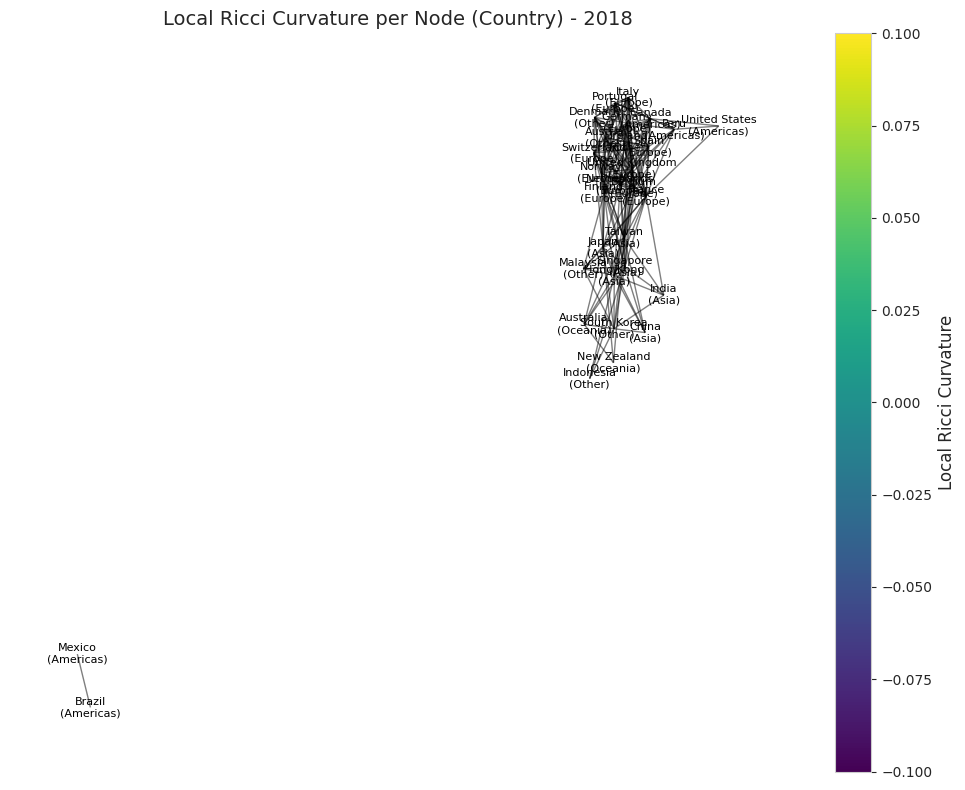

Year 2018 - Node Ricci Curvatures:
  Singapore (Asia): nan
  Japan (Asia): nan
  United Kingdom (Europe): nan
  Malaysia (Other): nan
  Finland (Europe): nan
  Netherlands (Europe): nan
  France (Europe): nan
  Indonesia (Other): nan
  Belgium (Europe): nan
  Norway (Europe): nan
  South Korea (Other): nan
  Australia (Oceania): nan
  China (Asia): nan
  Hong Kong (Asia): nan
  Taiwan (Asia): nan
  India (Asia): nan
  Switzerland (Europe): nan
  Austria (Other): nan
  New Zealand (Oceania): nan
  Spain (Europe): nan
  Germany (Europe): nan
  Portugal (Europe): nan
  Denmark (Other): nan
  Italy (Europe): nan
  Ireland (Other): nan
  Canada (Americas): nan
  Peru (Americas): nan
  United States (Americas): nan
  Brazil (Americas): nan
  Mexico (Americas): nan


Processing year: 2019


INFO:GraphRicciCurvature:0.189792 secs for Ricci curvature computation.


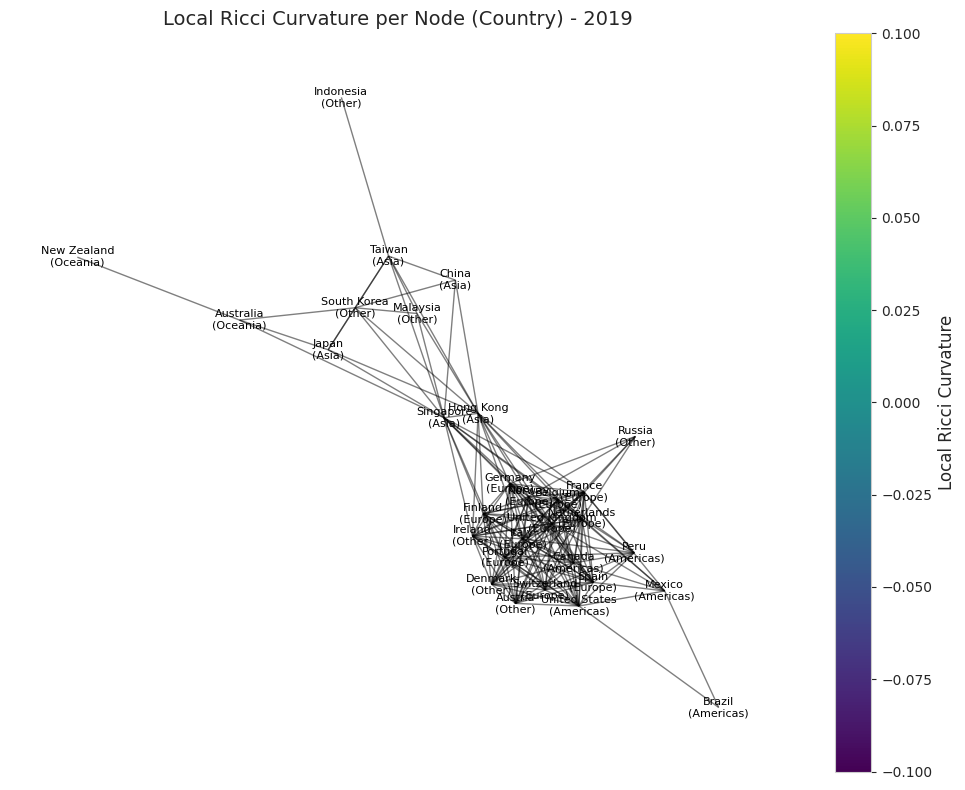

Year 2019 - Node Ricci Curvatures:
  Singapore (Asia): nan
  Japan (Asia): nan
  United Kingdom (Europe): nan
  Malaysia (Other): nan
  Germany (Europe): nan
  Finland (Europe): nan
  Portugal (Europe): nan
  Netherlands (Europe): nan
  France (Europe): nan
  Belgium (Europe): nan
  Ireland (Other): nan
  Norway (Europe): nan
  South Korea (Other): nan
  Australia (Oceania): nan
  China (Asia): nan
  Hong Kong (Asia): nan
  Taiwan (Asia): nan
  Russia (Other): nan
  Switzerland (Europe): nan
  Spain (Europe): nan
  Denmark (Other): nan
  Italy (Europe): nan
  Austria (Other): nan
  Canada (Americas): nan
  United States (Americas): nan
  Mexico (Americas): nan
  Peru (Americas): nan
  Indonesia (Other): nan
  New Zealand (Oceania): nan
  Brazil (Americas): nan


Processing year: 2020


INFO:GraphRicciCurvature:0.244318 secs for Ricci curvature computation.


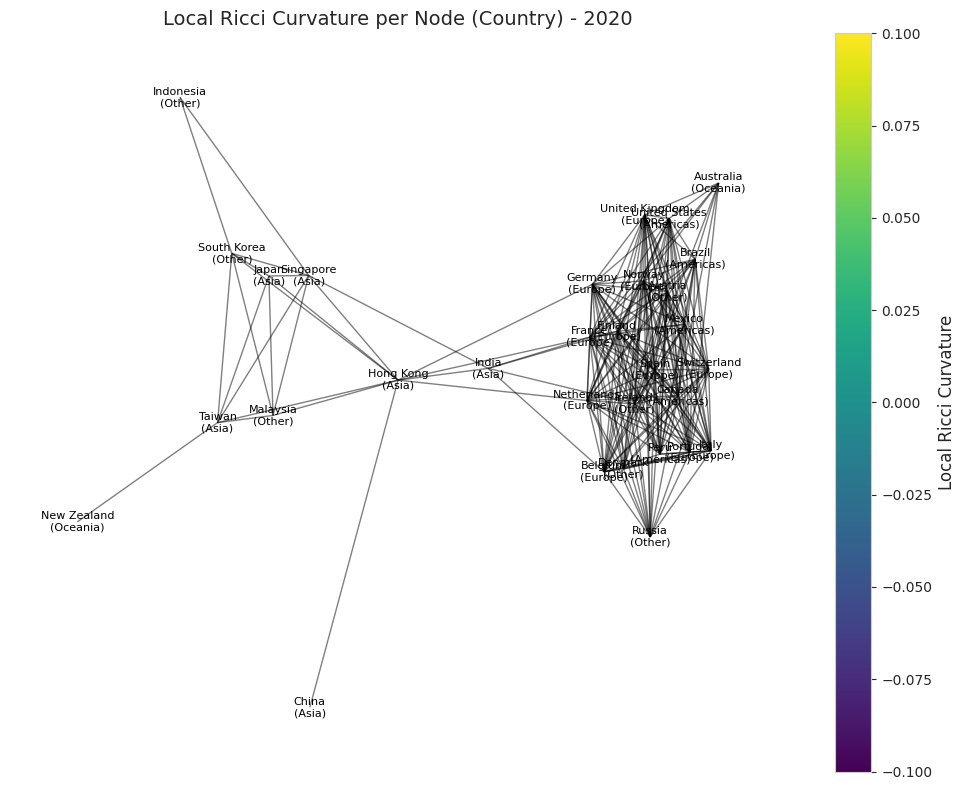

Year 2020 - Node Ricci Curvatures:
  Singapore (Asia): nan
  Japan (Asia): nan
  Malaysia (Other): nan
  Indonesia (Other): nan
  South Korea (Other): nan
  Hong Kong (Asia): nan
  Taiwan (Asia): nan
  India (Asia): nan
  United Kingdom (Europe): nan
  Russia (Other): nan
  Switzerland (Europe): nan
  Spain (Europe): nan
  Germany (Europe): nan
  Finland (Europe): nan
  Portugal (Europe): nan
  Netherlands (Europe): nan
  France (Europe): nan
  Denmark (Other): nan
  Belgium (Europe): nan
  Italy (Europe): nan
  Ireland (Other): nan
  Norway (Europe): nan
  Austria (Other): nan
  Canada (Americas): nan
  Australia (Oceania): nan
  Brazil (Americas): nan
  United States (Americas): nan
  Mexico (Americas): nan
  Peru (Americas): nan
  China (Asia): nan
  New Zealand (Oceania): nan


Processing year: 2021


INFO:GraphRicciCurvature:0.153152 secs for Ricci curvature computation.


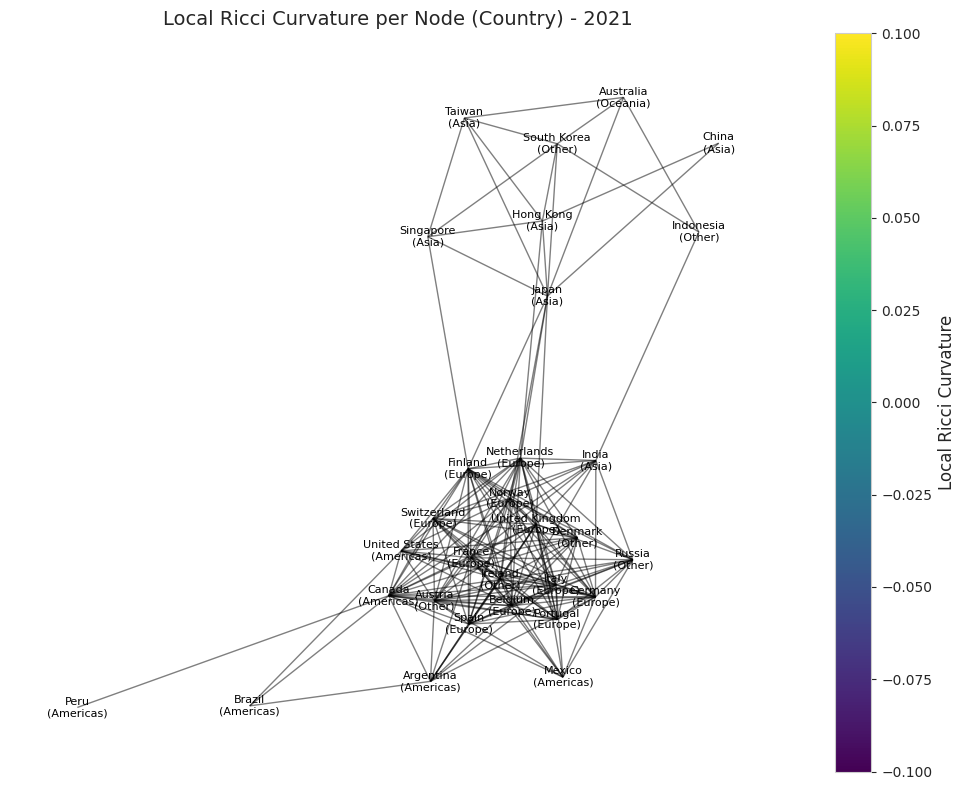

Year 2021 - Node Ricci Curvatures:
  Singapore (Asia): nan
  Japan (Asia): nan
  Finland (Europe): nan
  South Korea (Other): nan
  Hong Kong (Asia): nan
  Taiwan (Asia): nan
  United Kingdom (Europe): nan
  Netherlands (Europe): nan
  Norway (Europe): nan
  Australia (Oceania): nan
  China (Asia): nan
  Russia (Other): nan
  Switzerland (Europe): nan
  Spain (Europe): nan
  Germany (Europe): nan
  Portugal (Europe): nan
  France (Europe): nan
  Denmark (Other): nan
  Belgium (Europe): nan
  Italy (Europe): nan
  Ireland (Other): nan
  Austria (Other): nan
  Canada (Americas): nan
  Argentina (Americas): nan
  Mexico (Americas): nan
  India (Asia): nan
  United States (Americas): nan
  Indonesia (Other): nan
  Brazil (Americas): nan
  Peru (Americas): nan


Processing year: 2022


INFO:GraphRicciCurvature:0.158549 secs for Ricci curvature computation.


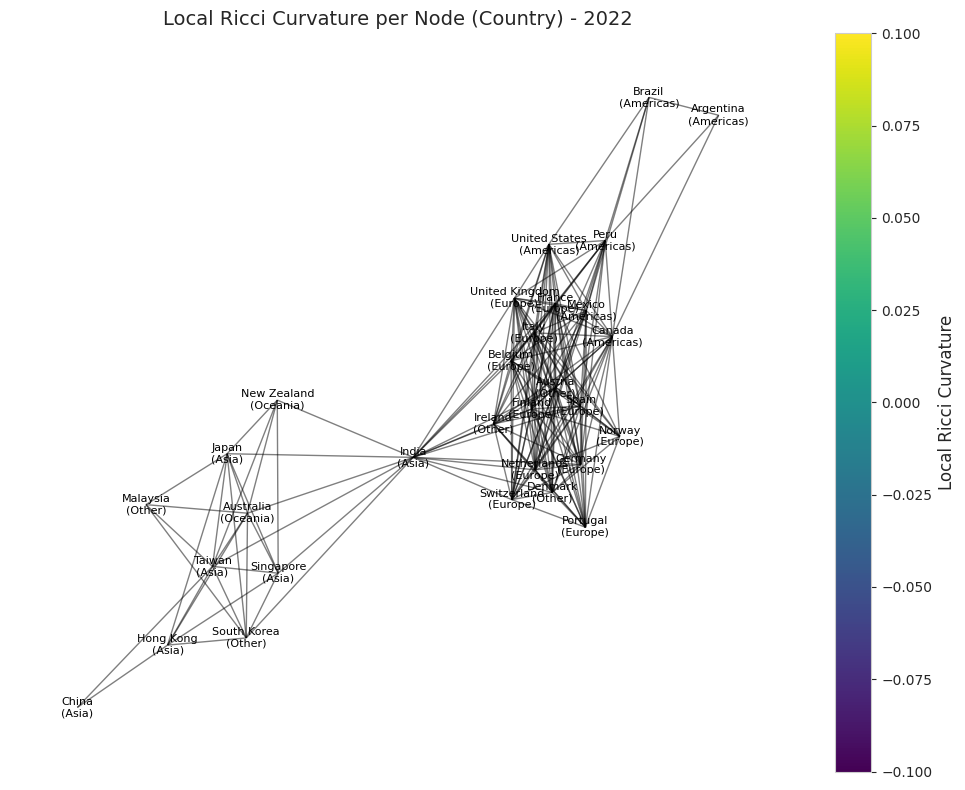

Year 2022 - Node Ricci Curvatures:
  Singapore (Asia): nan
  Japan (Asia): nan
  South Korea (Other): nan
  Australia (Oceania): nan
  Hong Kong (Asia): nan
  New Zealand (Oceania): nan
  Taiwan (Asia): nan
  India (Asia): nan
  Malaysia (Other): nan
  United Kingdom (Europe): nan
  Switzerland (Europe): nan
  Spain (Europe): nan
  Germany (Europe): nan
  Finland (Europe): nan
  Portugal (Europe): nan
  Netherlands (Europe): nan
  France (Europe): nan
  Denmark (Other): nan
  Belgium (Europe): nan
  Italy (Europe): nan
  Ireland (Other): nan
  Norway (Europe): nan
  Austria (Other): nan
  Canada (Americas): nan
  United States (Americas): nan
  Mexico (Americas): nan
  Peru (Americas): nan
  Argentina (Americas): nan
  Brazil (Americas): nan
  China (Asia): nan




In [ ]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from GraphRicciCurvature.OllivierRicci import OllivierRicci

# --- Define regions by geographic groups ---
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# --- 1. Read correlation matrices from Excel ---
file_path = '/content/correlation_matrices_2017_2022-out-averall.xlsx'
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# --- 2. Define a helper function to convert correlation to distance ---
def correlation_to_distance(correlation):
    return np.sqrt(2 * (1 - correlation))

# --- 3. Function to assign a region to a country ---
def assign_region(country):
    for region, countries in regions.items():
        if country in countries:
            return region
    return "Other"

# --- 4. Loop over each year's correlation matrix to build graph and perform local analysis ---
for year, correlation_matrix in correlation_matrices.items():
    print(f"Processing year: {year}")

    # (A) Compute average correlation and corresponding distance threshold
    avg_correlation = correlation_matrix.values.mean()
    distance_threshold = correlation_to_distance(avg_correlation)

    # (B) Build graph G: add an edge if correlation >= avg_correlation and distance <= threshold
    G = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, corr_value in row.items():
            if i != j and corr_value >= avg_correlation:
                d = correlation_to_distance(corr_value)
                if d <= distance_threshold:
                    G.add_edge(i, j, weight=d)

    if G.number_of_edges() == 0:
        print(f"Year {year}: No edges after thresholding. Skipping local Ricci computation.")
        continue

    # (C) Compute Ricci curvature for the graph edges using Ollivier-Ricci method
    orc = OllivierRicci(G, alpha=0.5, method="OTD", verbose="INFO")
    orc.compute_ricci_curvature()

    # (D) Compute node-level (local) Ricci curvature as the average of incident edge curvatures.
    node_ricci = {}
    for node in G.nodes():
        edge_curvatures = []
        for neighbor in G[node]:
            if 'ricciCurvature' in G[node][neighbor]:
                edge_curvatures.append(G[node][neighbor]['ricciCurvature'])
        if edge_curvatures:
            node_ricci[node] = np.mean(edge_curvatures)
        else:
            node_ricci[node] = np.nan
    nx.set_node_attributes(G, node_ricci, 'nodeRicciCurvature')

    # (E) Assign region attribute to each node
    for node in G.nodes():
        G.nodes[node]['region'] = assign_region(node)

    # --- 5. Visualization: plot the network with node colors reflecting local Ricci curvature ---
    plt.figure(figsize=(10, 8))
    pos = nx.spring_layout(G, seed=42)  # using a spring layout for positioning

    # Extract node curvature values for color mapping (using viridis colormap)
    node_colors = [G.nodes[node]['nodeRicciCurvature'] for node in G.nodes()]
    nodes = nx.draw_networkx_nodes(G, pos, node_color=node_colors, cmap=plt.cm.viridis,
                                   node_size=500)
    nx.draw_networkx_edges(G, pos, alpha=0.5)

    # Prepare labels: Country name and region in parentheses
    labels = {node: f"{node}\n({G.nodes[node]['region']})" for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)

    plt.title(f"Local Ricci Curvature per Node (Country) - {year}", fontsize=14)
    cbar = plt.colorbar(nodes)
    cbar.set_label("Local Ricci Curvature", fontsize=12)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Optionally, you can print a summary of node curvatures
    print(f"Year {year} - Node Ricci Curvatures:")
    for node, curv in node_ricci.items():
        print(f"  {node} ({G.nodes[node]['region']}): {curv:.4f}")
    print("\n" + "="*50 + "\n")


TRACE:GraphRicciCurvature:Number of nodes: 31
TRACE:GraphRicciCurvature:Number of edges: 175
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.001113 secs for all pair by NetworKit.


Processing year: 2017


INFO:GraphRicciCurvature:0.172352 secs for Ricci curvature computation.


Year 2017 - Node Ricci Curvatures:
  Singapore (Asia): 0.2222
  Japan (Asia): 0.1064
  Malaysia (Other): 0.3033
  South Korea (Other): 0.1997
  Australia (Oceania): 0.0457
  Hong Kong (Asia): 0.0213
  Taiwan (Asia): 0.3124
  United Kingdom (Europe): 0.3367
  Switzerland (Europe): 0.4369
  Germany (Europe): 0.4030
  Finland (Europe): 0.4250
  Netherlands (Europe): 0.4039
  France (Europe): 0.4186
  Belgium (Europe): 0.4013
  Norway (Europe): 0.2480
  Austria (Other): 0.3503
  India (Asia): 0.1056
  Spain (Europe): 0.4507
  Portugal (Europe): 0.4580
  Denmark (Other): 0.4567
  Italy (Europe): 0.4371
  Ireland (Other): 0.4562
  Canada (Americas): 0.2778
  United States (Americas): 0.4367
  Mexico (Americas): 0.2925
  Peru (Americas): 0.1093
  Russia (Other): 0.0371
  Argentina (Americas): 0.2963
  Brazil (Americas): 0.2965
  New Zealand (Oceania): 0.1675
  China (Asia): 0.0750




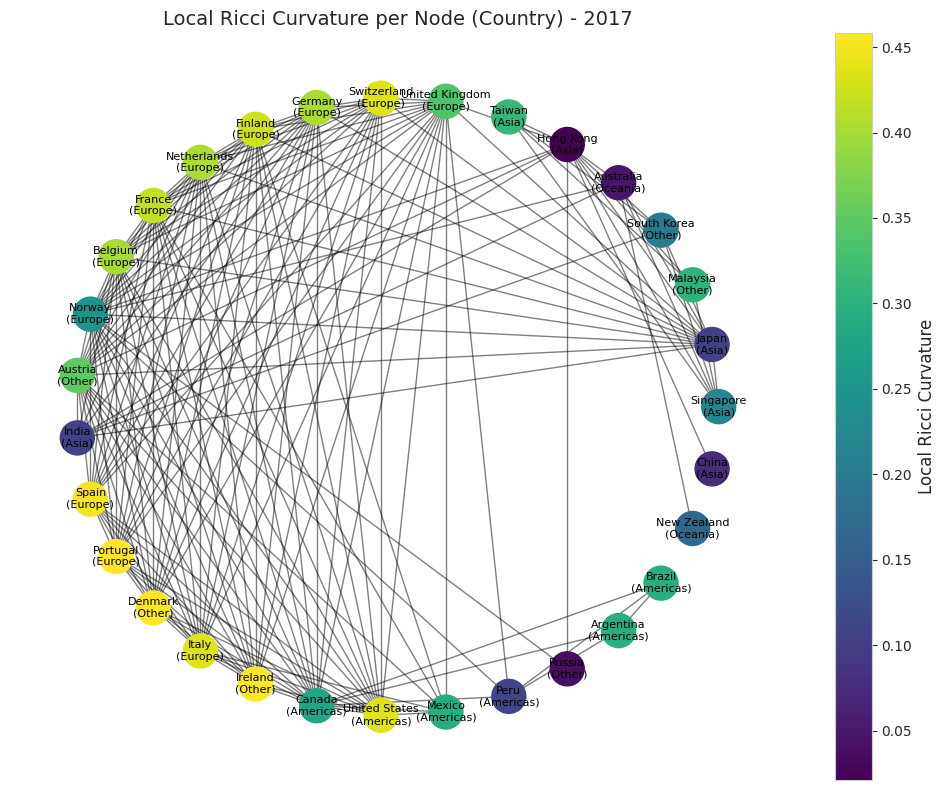

TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 181
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.020730 secs for all pair by NetworKit.


Processing year: 2018


INFO:GraphRicciCurvature:0.312306 secs for Ricci curvature computation.


Year 2018 - Node Ricci Curvatures:
  Singapore (Asia): 0.1950
  Japan (Asia): 0.1651
  United Kingdom (Europe): 0.3635
  Malaysia (Other): 0.2547
  Finland (Europe): 0.3277
  Netherlands (Europe): 0.3370
  France (Europe): 0.2648
  Indonesia (Other): 0.2166
  Belgium (Europe): 0.3396
  Norway (Europe): 0.3724
  South Korea (Other): 0.2688
  Australia (Oceania): 0.2121
  China (Asia): 0.2372
  Hong Kong (Asia): 0.1847
  Taiwan (Asia): 0.1584
  India (Asia): 0.2328
  Switzerland (Europe): 0.3971
  Austria (Other): 0.4184
  New Zealand (Oceania): 0.1903
  Spain (Europe): 0.4066
  Germany (Europe): 0.4068
  Portugal (Europe): 0.4286
  Denmark (Other): 0.4421
  Italy (Europe): 0.4415
  Ireland (Other): 0.4264
  Canada (Americas): 0.3308
  Peru (Americas): 0.2959
  United States (Americas): 0.1407
  Brazil (Americas): 1.0000
  Mexico (Americas): 1.0000




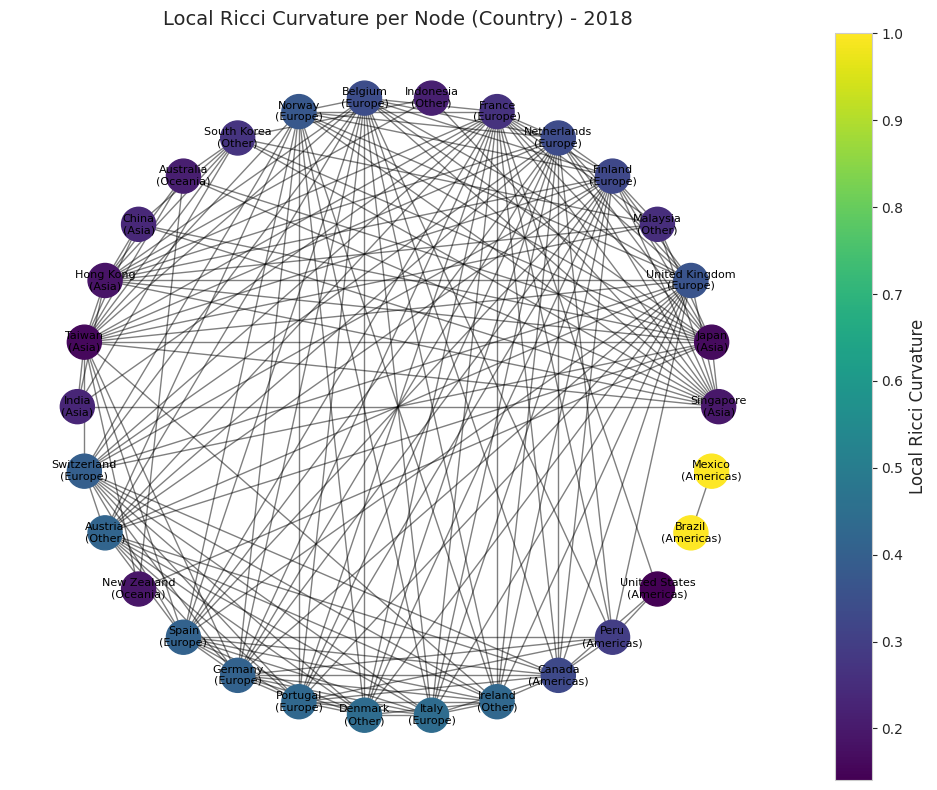

TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 185
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.006240 secs for all pair by NetworKit.


Processing year: 2019


INFO:GraphRicciCurvature:0.273311 secs for Ricci curvature computation.


Year 2019 - Node Ricci Curvatures:
  Singapore (Asia): 0.0321
  Japan (Asia): 0.1898
  United Kingdom (Europe): 0.3760
  Malaysia (Other): 0.2562
  Germany (Europe): 0.3855
  Finland (Europe): 0.4044
  Portugal (Europe): 0.4315
  Netherlands (Europe): 0.3735
  France (Europe): 0.3735
  Belgium (Europe): 0.3881
  Ireland (Other): 0.3994
  Norway (Europe): 0.3840
  South Korea (Other): 0.2430
  Australia (Oceania): 0.0816
  China (Asia): 0.2521
  Hong Kong (Asia): 0.0380
  Taiwan (Asia): 0.2172
  Russia (Other): 0.2591
  Switzerland (Europe): 0.4555
  Spain (Europe): 0.4362
  Denmark (Other): 0.4613
  Italy (Europe): 0.4309
  Austria (Other): 0.4594
  Canada (Americas): 0.4336
  United States (Americas): 0.3833
  Mexico (Americas): 0.2548
  Peru (Americas): 0.3674
  Indonesia (Other): 0.1703
  New Zealand (Oceania): 0.2519
  Brazil (Americas): 0.1861




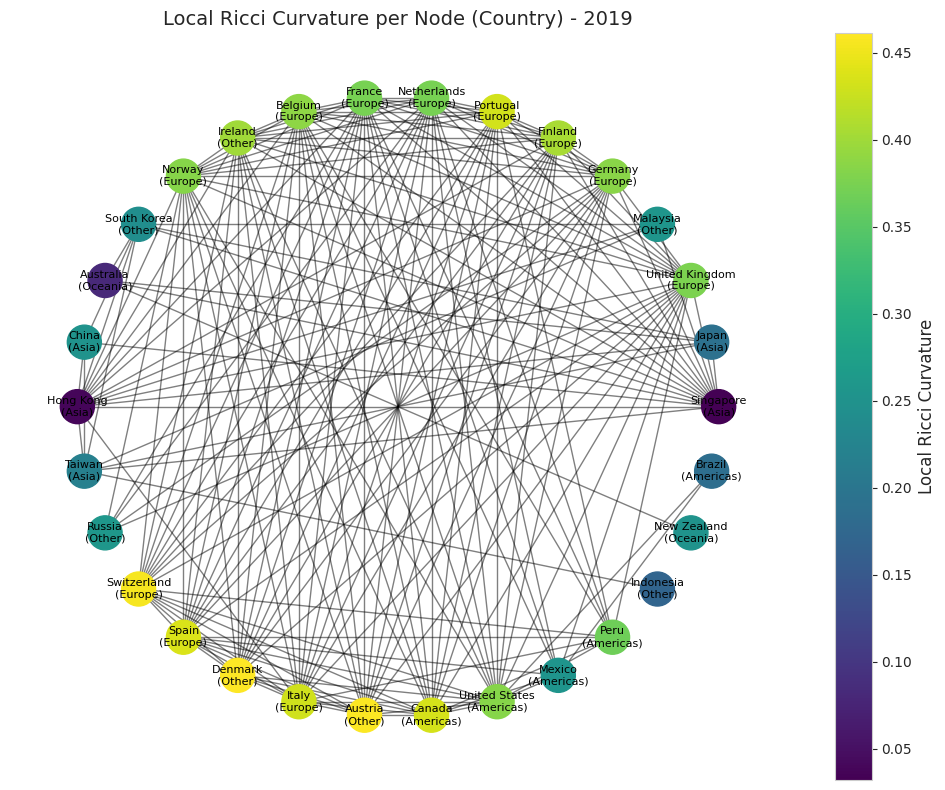

TRACE:GraphRicciCurvature:Number of nodes: 31
TRACE:GraphRicciCurvature:Number of edges: 217
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.020459 secs for all pair by NetworKit.


Processing year: 2020


INFO:GraphRicciCurvature:0.276287 secs for Ricci curvature computation.


Year 2020 - Node Ricci Curvatures:
  Singapore (Asia): 0.2202
  Japan (Asia): 0.4147
  Malaysia (Other): 0.4239
  Indonesia (Other): 0.2694
  South Korea (Other): 0.3410
  Hong Kong (Asia): -0.0331
  Taiwan (Asia): 0.2912
  India (Asia): -0.0130
  United Kingdom (Europe): 0.4496
  Russia (Other): 0.4211
  Switzerland (Europe): 0.4614
  Spain (Europe): 0.4624
  Germany (Europe): 0.4077
  Finland (Europe): 0.4350
  Portugal (Europe): 0.4573
  Netherlands (Europe): 0.4057
  France (Europe): 0.3603
  Denmark (Other): 0.4267
  Belgium (Europe): 0.4241
  Italy (Europe): 0.4629
  Ireland (Other): 0.4248
  Norway (Europe): 0.4547
  Austria (Other): 0.4675
  Canada (Americas): 0.4360
  Australia (Oceania): 0.3194
  Brazil (Americas): 0.4223
  United States (Americas): 0.4301
  Mexico (Americas): 0.4473
  Peru (Americas): 0.4492
  China (Asia): 0.1098
  New Zealand (Oceania): 0.1937




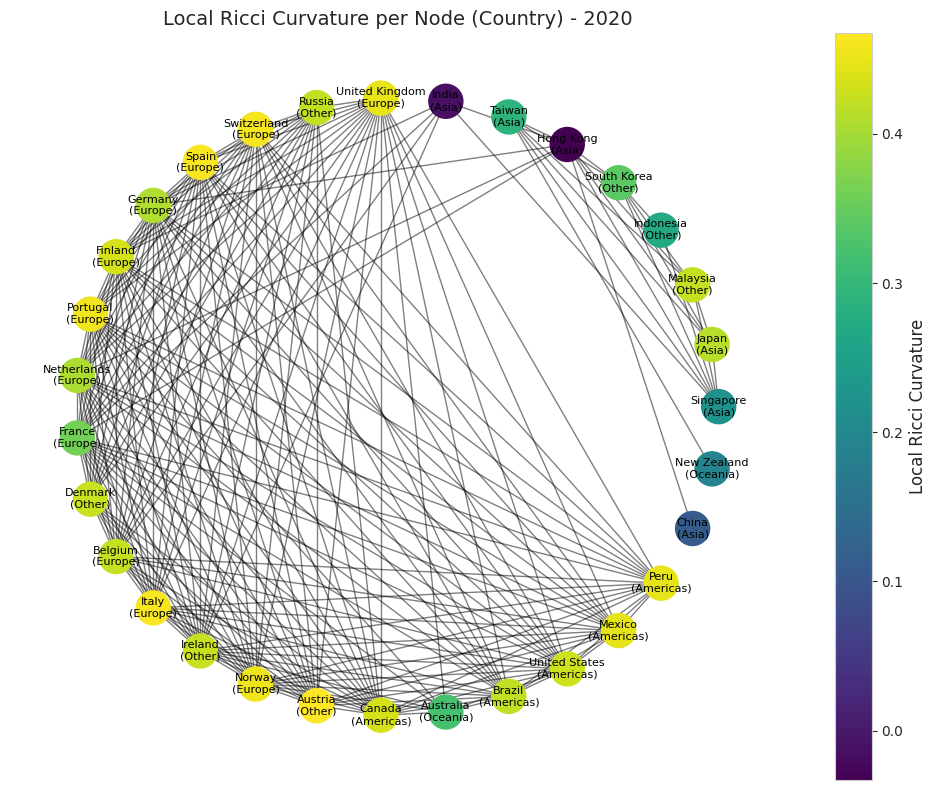

TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 184
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.028590 secs for all pair by NetworKit.


Processing year: 2021


INFO:GraphRicciCurvature:0.267059 secs for Ricci curvature computation.


Year 2021 - Node Ricci Curvatures:
  Singapore (Asia): 0.2328
  Japan (Asia): 0.0280
  Finland (Europe): 0.3235
  South Korea (Other): 0.2774
  Hong Kong (Asia): 0.1756
  Taiwan (Asia): 0.3453
  United Kingdom (Europe): 0.3691
  Netherlands (Europe): 0.3109
  Norway (Europe): 0.3763
  Australia (Oceania): 0.2374
  China (Asia): 0.1992
  Russia (Other): 0.4002
  Switzerland (Europe): 0.4206
  Spain (Europe): 0.4226
  Germany (Europe): 0.4154
  Portugal (Europe): 0.4383
  France (Europe): 0.4149
  Denmark (Other): 0.4162
  Belgium (Europe): 0.4224
  Italy (Europe): 0.4221
  Ireland (Other): 0.4311
  Austria (Other): 0.4126
  Canada (Americas): 0.3143
  Argentina (Americas): 0.3000
  Mexico (Americas): 0.3387
  India (Asia): 0.2317
  United States (Americas): 0.3407
  Indonesia (Other): 0.0029
  Brazil (Americas): 0.1475
  Peru (Americas): 0.0914




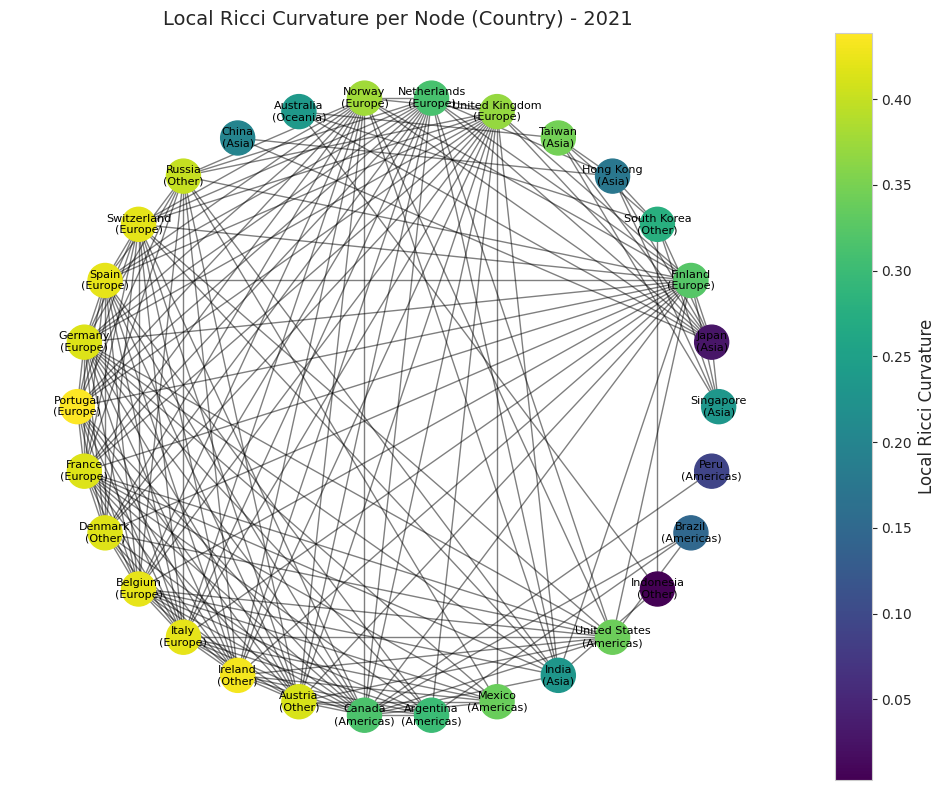

TRACE:GraphRicciCurvature:Number of nodes: 30
TRACE:GraphRicciCurvature:Number of edges: 191
TRACE:GraphRicciCurvature:Start to compute all pair shortest path.
TRACE:GraphRicciCurvature:0.016704 secs for all pair by NetworKit.


Processing year: 2022


INFO:GraphRicciCurvature:0.317474 secs for Ricci curvature computation.


Year 2022 - Node Ricci Curvatures:
  Singapore (Asia): 0.3348
  Japan (Asia): 0.3473
  South Korea (Other): 0.3213
  Australia (Oceania): 0.3456
  Hong Kong (Asia): 0.2931
  New Zealand (Oceania): 0.2961
  Taiwan (Asia): 0.2982
  India (Asia): 0.0033
  Malaysia (Other): 0.3528
  United Kingdom (Europe): 0.4353
  Switzerland (Europe): 0.4323
  Spain (Europe): 0.4376
  Germany (Europe): 0.4265
  Finland (Europe): 0.4377
  Portugal (Europe): 0.4425
  Netherlands (Europe): 0.4320
  France (Europe): 0.4323
  Denmark (Other): 0.4333
  Belgium (Europe): 0.4392
  Italy (Europe): 0.4368
  Ireland (Other): 0.4308
  Norway (Europe): 0.4008
  Austria (Other): 0.4372
  Canada (Americas): 0.3191
  United States (Americas): 0.3728
  Mexico (Americas): 0.3796
  Peru (Americas): 0.3062
  Argentina (Americas): 0.2019
  Brazil (Americas): 0.1855
  China (Asia): 0.2102




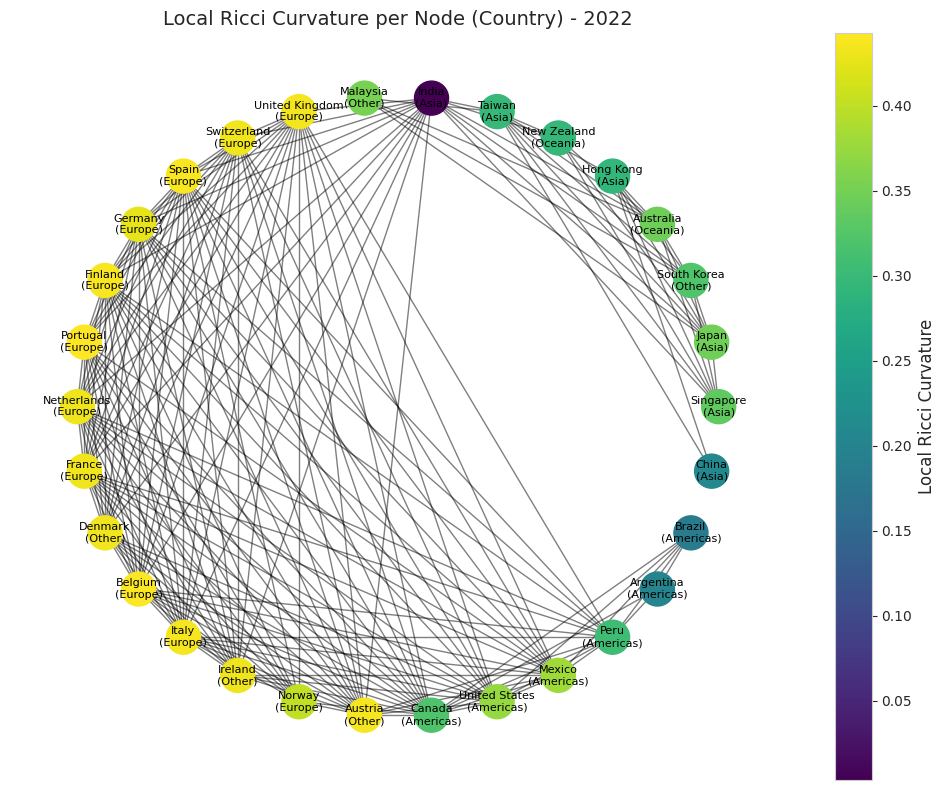

In [ ]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from GraphRicciCurvature.OllivierRicci import OllivierRicci

# --- Define regions by geographic groups ---
regions = {
    'Asia': ['Japan', 'Hong Kong', 'China', 'Taiwan', 'India', 'Singapore'],
    'Europe': ['United Kingdom', 'Switzerland', 'Spain', 'Germany', 'Finland', 'Portugal',
               'France', 'Italy', 'Netherlands', 'Belgium', 'Norway', 'Sweden', 'Greece'],
    'Americas': ['United States', 'Brazil', 'Mexico', 'Argentina', 'Canada', 'Chile', 'Peru'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': ['South Africa', 'Egypt', 'Israel', 'Qatar', 'UAE', 'Saudi Arabia']
}

# --- Function to assign a region to a country ---
def assign_region(country):
    for region, countries in regions.items():
        if country in countries:
            return region
    return "Other"

# --- Helper function: Convert correlation to distance ---
def correlation_to_distance(correlation):
    return np.sqrt(2 * (1 - correlation))

# --- Read correlation matrices (one sheet per year) from Excel ---
file_path = '/content/correlation_matrices_2017_2022-out-averall.xlsx'
correlation_matrices = pd.read_excel(file_path, sheet_name=None, index_col=0)

# --- Process each year's correlation matrix ---
for year, correlation_matrix in correlation_matrices.items():
    print(f"Processing year: {year}")

    # (A) Compute average correlation and derive a distance threshold
    avg_correlation = correlation_matrix.values.mean()
    distance_threshold = correlation_to_distance(avg_correlation)

    # (B) Build the graph: add an edge if correlation >= avg_correlation and its distance is within threshold
    G = nx.Graph()
    for i, row in correlation_matrix.iterrows():
        for j, corr_value in row.items():
            if i != j and corr_value >= avg_correlation:
                d = correlation_to_distance(corr_value)
                if d <= distance_threshold:
                    G.add_edge(i, j, weight=d)

    if G.number_of_edges() == 0:
        print(f"Year {year}: No edges after thresholding. Skipping local Ricci computation.\n")
        continue

    # (C) Compute Ricci curvature on the graph using the Ollivier-Ricci method
    orc = OllivierRicci(G, alpha=0.5, method="OTD", verbose="TRACE")
    orc.compute_ricci_curvature()

    # IMPORTANT: Use the updated graph (orc.G) which now has the 'ricciCurvature' attributes on edges
    G = orc.G

    # (D) Compute node-level (local) Ricci curvature as the average curvature of all incident edges
    node_ricci = {}
    for node in G.nodes():
        edge_curvatures = []
        for neighbor in G[node]:
            # Check if the edge has the key 'ricciCurvature'
            if 'ricciCurvature' in G[node][neighbor]:
                edge_curvatures.append(G[node][neighbor]['ricciCurvature'])
        if edge_curvatures:
            node_ricci[node] = np.mean(edge_curvatures)
        else:
            node_ricci[node] = np.nan
    nx.set_node_attributes(G, node_ricci, 'nodeRicciCurvature')

    # (E) Print the local Ricci curvature for each node (with region assignment)
    print(f"Year {year} - Node Ricci Curvatures:")
    for node, curv in node_ricci.items():
        reg = assign_region(node)
        # Only print a numeric value if not nan
        if np.isnan(curv):
            print(f"  {node} ({reg}): nan")
        else:
            print(f"  {node} ({reg}): {curv:.4f}")
    print("\n" + "="*50 + "\n")

    # (F) Visualize the network: nodes colored by local Ricci curvature, with labels
    plt.figure(figsize=(10, 8))
    #pos = nx.spring_layout(G, seed=42)
    pos = nx.circular_layout(G)

    # Get node curvature values for color mapping
    node_colors = [G.nodes[node]['nodeRicciCurvature'] for node in G.nodes()]
    nodes = nx.draw_networkx_nodes(G, pos, node_color=node_colors, cmap=plt.cm.viridis,
                                   node_size=600)
    nx.draw_networkx_edges(G, pos, alpha=0.5)

    # Create labels: Country name and its region
    labels = {node: f"{node}\n({assign_region(node)})" for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)

    plt.title(f"Local Ricci Curvature per Node (Country) - {year}", fontsize=14)
    cbar = plt.colorbar(nodes)
    cbar.set_label("Local Ricci Curvature", fontsize=12)
    plt.axis('off')
    plt.tight_layout()
    plt.show()


In [ ]:
import pandas as pd
import plotly.express as px

# Example: node-level Ricci curvature for a given year (replace with your actual results)
node_ricci = {
    'Singapore': 0.35,
    'Japan': 0.36,
    'Malaysia': 0.34,
    'South Korea': 0.37,
    'Australia': 0.33,
    'Hong Kong': 0.38,
    'Taiwan': 0.36,
    'United Kingdom': 0.32,
    'Switzerland': 0.31,
    'Germany': 0.34,
    'Finland': 0.33,
    'Netherlands': 0.35,
    'France': 0.36,
    'Belgium': 0.34,
    'Norway': 0.33,
    'Austria': 0.32,
    'India': 0.35,
    'Spain': 0.34,
    'Portugal': 0.33,
    'Denmark': 0.31,
    'Italy': 0.34,
    'Ireland': 0.32,
    'Canada': 0.36,
    'United States': 0.37,
    'Mexico': 0.35,
    'Peru': 0.33,
    'Russia': 0.34,
    'Argentina': 0.32,
    'Brazil': 0.35,
    'New Zealand': 0.33,
    'China': 0.36
}

# Convert the dictionary to a DataFrame
df = pd.DataFrame({
    "Country": list(node_ricci.keys()),
    "RicciCurvature": list(node_ricci.values())
})

# Create a choropleth map with Plotly Express
fig = px.choropleth(df,
                    locations="Country",
                    locationmode="country names",
                    color="RicciCurvature",
                    color_continuous_scale="Viridis",
                    title="Local Ricci Curvature by Country",
                    projection="natural earth")

fig.update_layout(geo=dict(showcountries=True))
fig.show()


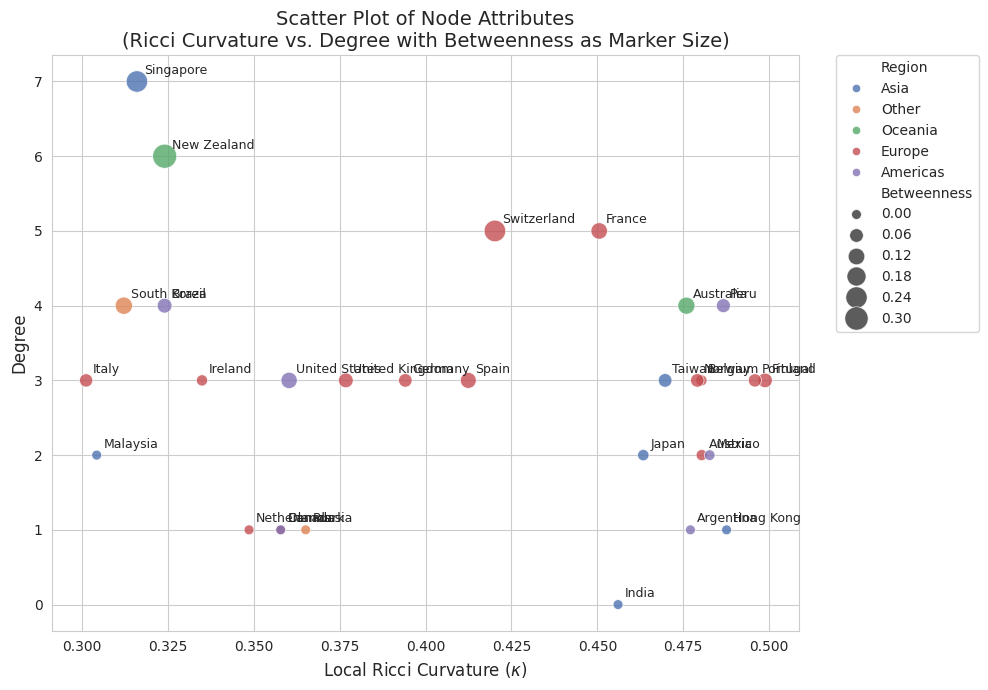

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import random

# --- For demonstration purposes, let's create a sample graph.
# In your actual use case, G is the graph resulting from your Ricci curvature analysis.
G = nx.erdos_renyi_graph(30, 0.1, seed=42)
# Assign a random local Ricci curvature and a region for each node (country)
sample_countries = ['Singapore', 'Japan', 'Malaysia', 'South Korea', 'Australia',
                    'Hong Kong', 'Taiwan', 'United Kingdom', 'Switzerland', 'Germany',
                    'Finland', 'Netherlands', 'France', 'Belgium', 'Norway', 'Austria',
                    'India', 'Spain', 'Portugal', 'Denmark', 'Italy', 'Ireland', 'Canada',
                    'United States', 'Mexico', 'Peru', 'Russia', 'Argentina', 'Brazil', 'New Zealand', 'China']
regions = {
    'Asia': ['Singapore', 'Japan', 'Hong Kong', 'Taiwan', 'India', 'Malaysia'],
    'Europe': ['United Kingdom', 'Switzerland', 'Germany', 'Finland', 'Netherlands', 'France', 'Belgium', 'Norway', 'Austria', 'Spain', 'Portugal', 'Denmark', 'Italy', 'Ireland'],
    'Americas': ['Canada', 'United States', 'Mexico', 'Peru', 'Argentina', 'Brazil'],
    'Oceania': ['Australia', 'New Zealand'],
    'Middle East & Africa': []  # not used in this sample
}
# For demonstration, assign countries cyclically if there are fewer nodes than country names.
for i, node in enumerate(G.nodes()):
    country = sample_countries[i % len(sample_countries)]
    # Random Ricci curvature between 0.3 and 0.5
    G.nodes[node]['nodeRicciCurvature'] = random.uniform(0.3, 0.5)
    # Assign region using our mapping function
    assigned_region = "Other"
    for reg, countries in regions.items():
        if country in countries:
            assigned_region = reg
            break
    G.nodes[node]['region'] = assigned_region
    G.nodes[node]['country'] = country

# --- Compute additional node metrics: degree and betweenness centrality
degree_dict = dict(G.degree())
nx.set_node_attributes(G, degree_dict, 'degree')

betweenness_dict = nx.betweenness_centrality(G)
nx.set_node_attributes(G, betweenness_dict, 'betweenness')

# --- Build a DataFrame of node attributes for plotting
data = []
for node, attr in G.nodes(data=True):
    data.append({
        "Country": attr.get('country', str(node)),
        "Ricci": attr.get('nodeRicciCurvature'),
        "Degree": attr.get('degree'),
        "Betweenness": attr.get('betweenness'),
        "Region": attr.get('region', 'Other')
    })
df = pd.DataFrame(data)

# --- Create the scatter plot using Seaborn
plt.figure(figsize=(10, 7))
scatter = sns.scatterplot(data=df,
                          x="Ricci",
                          y="Degree",
                          hue="Region",
                          size="Betweenness",
                          sizes=(50, 300),
                          alpha=0.8,
                          palette="deep")

# Annotate each point with the country name
for i, row in df.iterrows():
    plt.text(row["Ricci"] + 0.002, row["Degree"] + 0.1, row["Country"], fontsize=9)

plt.xlabel("Local Ricci Curvature ($\\kappa$)", fontsize=12)
plt.ylabel("Degree", fontsize=12)
plt.title("Scatter Plot of Node Attributes\n(Ricci Curvature vs. Degree with Betweenness as Marker Size)", fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.tight_layout()
plt.show()


In [ ]:
!pip install adjustText


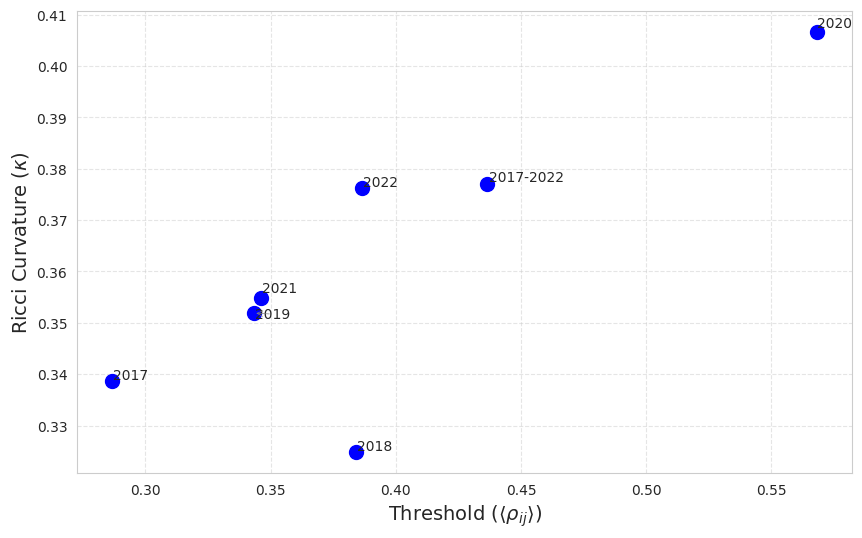

In [ ]:
import matplotlib.pyplot as plt
from adjustText import adjust_text

# Datos de características de Euler y correlaciones promedio
ricci_values = {2017: 0.3386, 2018: 0.3248, 2019: 0.3519, 2020: 0.4066, 2021: 0.3549, 2022: 0.3762, '2017-2022': 0.3770
}
average_correlations = {2017: 0.2868, 2018: 0.3843, 2019: 0.3432, 2020: 0.5681, 2021: 0.3460, 2022: 0.3866, '2017-2022': 0.4363}

# Preparar los datos
years = list(average_correlations.keys())
ricci_values = list(ricci_values.values())
correlation_means = list(average_correlations.values())

# Crear el scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(correlation_means, ricci_values, color='blue', s=100)

# Agregar las etiquetas a cada punto y almacenarlas en una lista para ajustar
texts = []
for i, year in enumerate(years):
    texts.append(plt.text(correlation_means[i], ricci_values[i], year, fontsize=10))

# Ajustar las etiquetas para evitar la superposición
adjust_text(texts, expand_points=(2.5, 1.5), arrowprops=dict(arrowstyle="->", color='gray', lw=0.5))

# Configuración del gráfico
plt.xlabel("Threshold ($\\langle \\rho_{ij} \\rangle$)", size=14)
plt.ylabel("Ricci Curvature ($\kappa$)",size=14)
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()



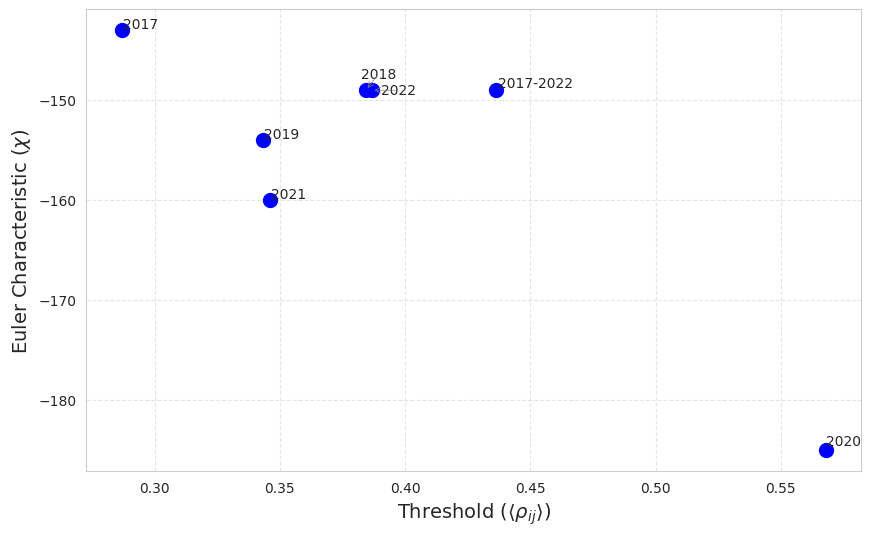

In [ ]:
import matplotlib.pyplot as plt
from adjustText import adjust_text

# Datos de características de Euler y correlaciones promedio
euler_characteristics = {2017: -143, 2018: -149, 2019: -154, 2020: -185, 2021: -160, 2022: -149, '2017-2022': -149}
average_correlations = {2017: 0.2868, 2018: 0.3843, 2019: 0.3432, 2020: 0.5681, 2021: 0.3460, 2022: 0.3866, '2017-2022': 0.4363}

# Preparar los datos
years = list(average_correlations.keys())
euler_values = list(euler_characteristics.values())
correlation_means = list(average_correlations.values())

# Crear el scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(correlation_means, euler_values, color='blue', s=100)

# Agregar las etiquetas a cada punto y almacenarlas en una lista para ajustar
texts = []
for i, year in enumerate(years):
    texts.append(plt.text(correlation_means[i], euler_values[i], year, fontsize=10))

# Ajustar las etiquetas para evitar la superposición
adjust_text(texts, expand_points=(2.5, 1.5), arrowprops=dict(arrowstyle="->", color='gray', lw=0.5))

# Configuración del gráfico
plt.xlabel("Threshold ($\\langle \\rho_{ij} \\rangle$)", size=14)
plt.ylabel("Euler Characteristic ($\\chi$)", size=14)
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()



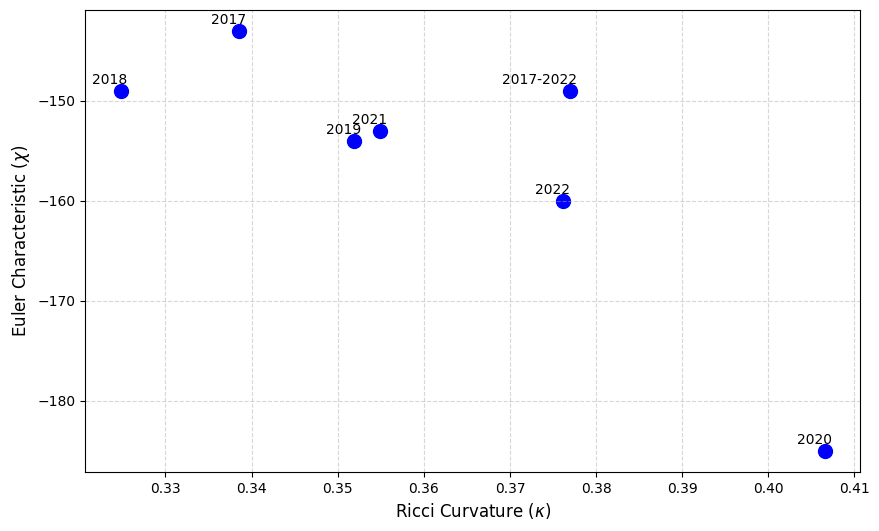

In [ ]:
import matplotlib.pyplot as plt

# Datos de características de Euler y curvatura de Ricci promedio
euler_characteristics = {
    2017: -143, 2018: -149, 2019: -154, 2020: -185, 2021: -153, 2022: -160, '2017-2022': -149
}
ricci_values = {
    2017: 0.3386, 2018: 0.3248, 2019: 0.3519, 2020: 0.4066, 2021: 0.3549, 2022: 0.3762, '2017-2022': 0.3770
}

# Convertir datos en listas para graficar
years = list(euler_characteristics.keys())
euler_values = list(euler_characteristics.values())
ricci_curvature = list(ricci_values.values())

# Crear el scatter plot
plt.figure(figsize=(10, 6))
plt.scatter( ricci_curvature,euler_values, color='blue', s=100)

# Etiquetar cada punto con el año correspondiente
for i, year in enumerate(years):
    plt.annotate(year, (ricci_curvature[i], euler_values[i]), textcoords="offset points", xytext=(5,5), ha='right',size=10)

# Configuración del gráfico
#plt.title("Scatter Plot of Ricci Curvature vs Euler Characteristic by Year")
plt.xlabel("Ricci Curvature ($\kappa$)",size=12)
plt.ylabel("Euler Characteristic ($\\chi$)",size=12)
plt.grid(True,linestyle='--',alpha=0.5)
# Guardar la figura en formato EPS y PDF
plt.savefig("scatter-euler-ricci.eps", format="eps", bbox_inches="tight")
plt.savefig("scatter-euler-ricci.pdf", format="pdf", bbox_inches="tight")

plt.show()


#EULER CARACTERISTIC + RICCI CURVATURE + RMT

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# # colab setting
!pip install GraphRicciCurvature
!pip install scikit-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.0/11.0 MB 66.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 59.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.2/38.2 MB 21.5 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.16.3
    Uninstalling scipy-1.16.3:
      Successfully uninstalled scipy-1.16.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tsfresh 0.21.1 requires scipy>=1.14.0; python_version >= "3.10", but you have scipy 1.13.1 which is incompatible.
access 1.1.10.post3 requires scipy>=1.14.1, but you have scipy 1.13.1 which is incompatible.


Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/cli/base_command.py", line 179, in exc_logging_wrapper
    status = run_func(*args)
             ^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/cli/req_command.py", line 67, in wrapper
    return func(self, options, args)
           ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/commands/install.py", line 447, in run
    conflicts = self._determine_conflicts(to_install)
                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/commands/install.py", line 578, in _determine_conflicts
    return check_install_conflicts(to_install)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/operations/check.py", line 101, in check_install_conflicts
    package_set, _ = create_package_set_from_installed()
              

In [1]:

import networkx as nx
import numpy as np
import math
import importlib

# matplotlib setting
%matplotlib inline
import matplotlib.pyplot as plt

# to print logs in jupyter notebook
import logging
logging.basicConfig(format='%(levelname)s:%(message)s', level=logging.ERROR)

# load GraphRicciCuravture package
from GraphRicciCurvature.OllivierRicci import OllivierRicci

# load python-louvain for modularity computation
import community as community_louvain

# for ARI computation
from sklearn import preprocessing, metrics


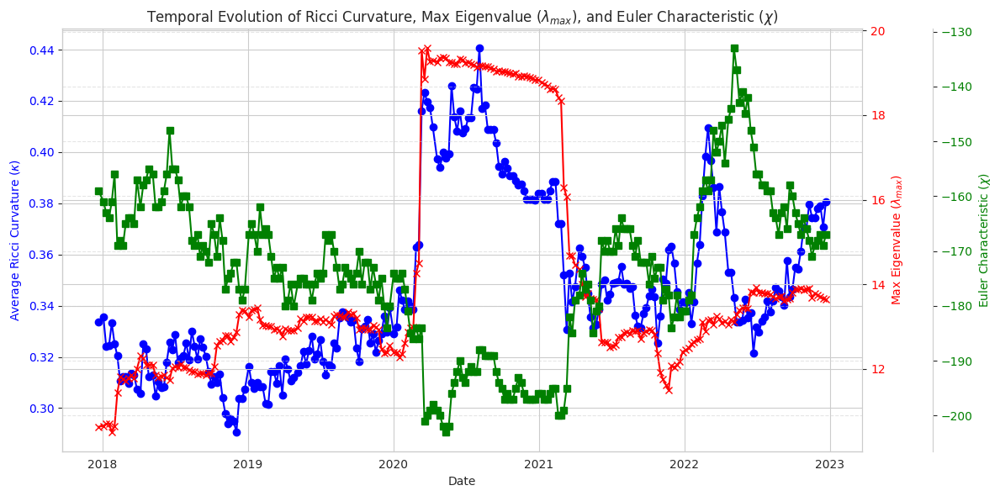

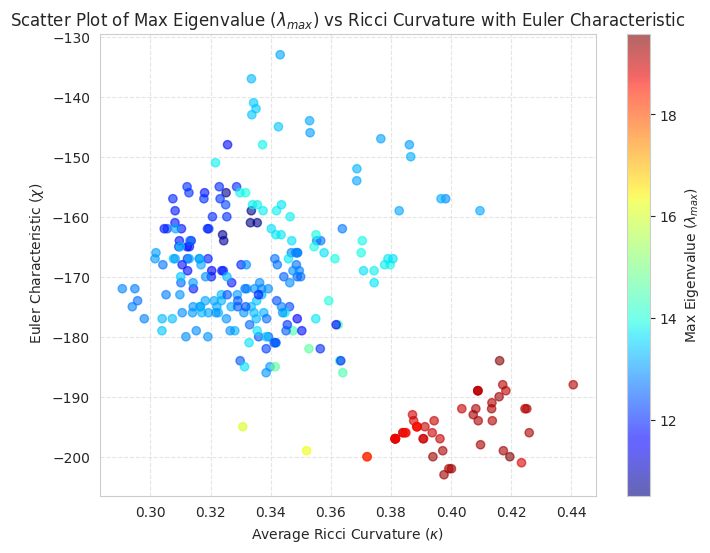

In [2]:
import pandas as pd
import numpy as np
import networkx as nx
from GraphRicciCurvature.OllivierRicci import OllivierRicci
import matplotlib.pyplot as plt

# Load the log returns data
file_path = '/content/drive/MyDrive/Paper-TDA-GlobalStockMarket/log_returns_global_stock_indices_data.xlsx'
data = pd.read_excel(file_path, index_col=0)  # Ensure the date column is the index
data.index = pd.to_datetime(data.index)

# Parameters for sliding window
window_size = 250  # 22 days (approx. 1 month)
shift = 5         # 5 days (overlapping)
ricci_curvature_results = []
max_eigenvalues = []
euler_characteristics = []
dates = []

# Sliding window over the data
for start in range(0, len(data) - window_size, shift):
    end = start + window_size
    window_data = data.iloc[start:end]
    dates.append(window_data.index[-1])  # Capture the end date for each window

    # Compute the correlation matrix for this window
    correlation_matrix = window_data.corr()

    # Calculate the maximum eigenvalue of the correlation matrix (Random Matrix Theory)
    eigenvalues = np.linalg.eigvalsh(correlation_matrix)
    lambda_max = np.max(eigenvalues)
    max_eigenvalues.append(lambda_max)

    # Thresholding the correlation matrix at the average correlation in the window
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()
    thresholded_edges = [(i, j, correlation_matrix.iat[i, j])
                         for i in range(len(correlation_matrix))
                         for j in range(i + 1, len(correlation_matrix))
                         if correlation_matrix.iat[i, j] >= avg_correlation]

    # Construct the graph
    graph = nx.Graph()
    for (i, j, weight) in thresholded_edges:
        graph.add_edge(correlation_matrix.index[i], correlation_matrix.index[j], weight=weight)

    # Calculate the Euler characteristic
    euler_characteristic = graph.number_of_nodes() - graph.number_of_edges()
    euler_characteristics.append(euler_characteristic)

    # Calculate Ricci curvature using Ollivier-Ricci method
    if graph.number_of_edges() > 0:
        orc = OllivierRicci(graph, alpha=0.5, method="OTD")
        orc.compute_ricci_curvature()

        # Calculate the average Ricci curvature for the window
        avg_ricci_curvature = np.mean([data['ricciCurvature'] for _, _, data in orc.G.edges(data=True)])
        ricci_curvature_results.append(avg_ricci_curvature)
    else:
        ricci_curvature_results.append(np.nan)  # Handle cases with no edges

# Convert results to DataFrame for easy plotting
results_df = pd.DataFrame({
    'Date': dates,
    'Average_Ricci_Curvature': ricci_curvature_results,
    'Max_Eigenvalue': max_eigenvalues,
    'Euler_Characteristic': euler_characteristics
})
results_df.set_index('Date', inplace=True)

# Plotting the temporal evolution of Ricci curvature, maximum eigenvalue, and Euler characteristic
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot Ricci Curvature
ax1.plot(results_df.index, results_df['Average_Ricci_Curvature'], marker='o', color='b', label='Ricci Curvature')
ax1.set_xlabel("Date")
ax1.set_ylabel("Average Ricci Curvature ($\\kappa$)", color='b')
ax1.tick_params(axis='y', labelcolor='b')

# Create a second y-axis for max eigenvalue
ax2 = ax1.twinx()
ax2.plot(results_df.index, results_df['Max_Eigenvalue'], marker='x', color='r', label='Max Eigenvalue ($\\lambda_{max}$)')
ax2.set_ylabel("Max Eigenvalue ($\\lambda_{max}$)", color='r')
ax2.tick_params(axis='y', labelcolor='r')

# Plot Euler Characteristic on a third axis
ax3 = ax1.twinx()
ax3.spines['right'].set_position(('outward', 60))
ax3.plot(results_df.index, results_df['Euler_Characteristic'], marker='s', color='g', label='Euler Characteristic ($\\chi$)')
ax3.set_ylabel("Euler Characteristic ($\\chi$)", color='g')
ax3.tick_params(axis='y', labelcolor='g')

# Add titles and grid
plt.title("Temporal Evolution of Ricci Curvature, Max Eigenvalue ($\\lambda_{max}$), and Euler Characteristic ($\\chi$)")
fig.tight_layout()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Scatter Plot: Max Eigenvalue vs Ricci Curvature vs Euler Characteristic
plt.figure(figsize=(8, 6))
plt.scatter(results_df['Average_Ricci_Curvature'],results_df['Euler_Characteristic'],  c= results_df['Max_Eigenvalue'], cmap='jet', alpha=0.6)
plt.colorbar(label="Max Eigenvalue ($\\lambda_{max}$)")
plt.title("Scatter Plot of Max Eigenvalue ($\\lambda_{max}$) vs Ricci Curvature with Euler Characteristic")
plt.xlabel("Average Ricci Curvature ($\\kappa$)")
plt.ylabel(" Euler Characteristic ($\\chi$)")
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


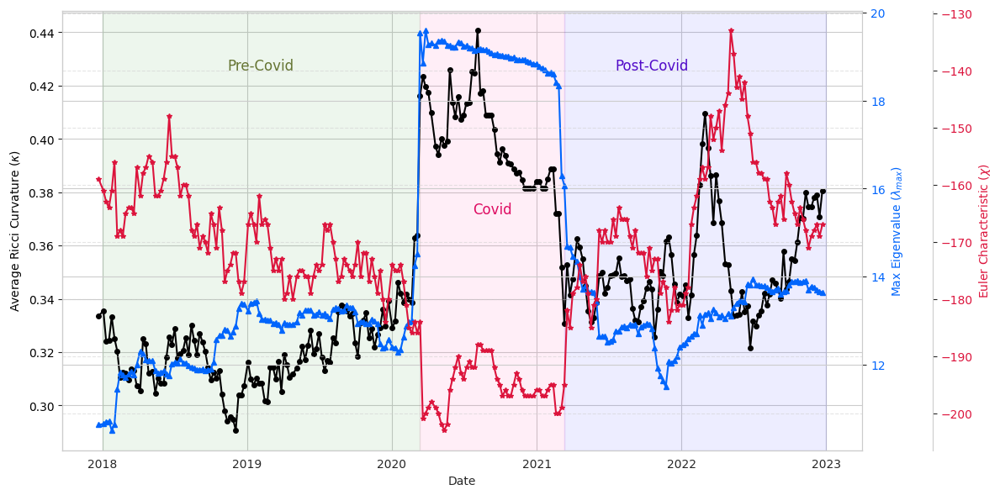

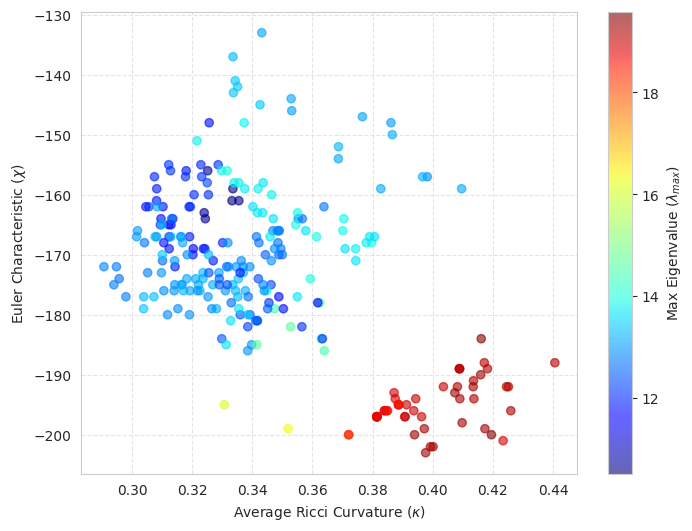

In [3]:
# Plotting the temporal evolution of Ricci curvature, maximum eigenvalue, and Euler characteristic
fig, ax1 = plt.subplots(figsize=(12, 6))

# Define the time boundaries for the periods
pre_covid_start = pd.Timestamp("2018-01-01")
pre_covid_end   = pd.Timestamp("2020-03-10")
covid_start     = pd.Timestamp("2020-03-11")
covid_end       = pd.Timestamp ("2021-03-11")#("2021-03-31")
post_covid_start= pd.Timestamp("2021-03-12")#("2021-04-01")
post_covid_end  = pd.Timestamp("2022-12-31")  # adjust if needed



# Plot Ricci Curvature
ax1.plot(results_df.index, results_df['Average_Ricci_Curvature'], marker='o', color='black', label='Ricci Curvature',markersize=4)
ax1.set_xlabel("Date")
ax1.set_ylabel("Average Ricci Curvature ($\\kappa$)", color='black')
ax1.tick_params(axis='y', labelcolor='black')


# Create a second y-axis for max eigenvalue
ax2 = ax1.twinx()
ax2.plot(results_df.index, results_df['Max_Eigenvalue'], marker='^', color='#0165fc', label='Max Eigenvalue ($\\lambda_{max}$)',markersize=4)
ax2.set_ylabel("Max Eigenvalue ($\\lambda_{max}$)", color='#0165fc')  ##5539cc
ax2.tick_params(axis='y', labelcolor='#0165fc')

# Plot Euler Characteristic on a third axis
ax3 = ax1.twinx()
ax3.spines['right'].set_position(('outward', 60))
ax3.plot(results_df.index, results_df['Euler_Characteristic'], marker='*', color='crimson', label='Euler Characteristic ($\\chi$)',markersize=4)
ax3.set_ylabel("Euler Characteristic ($\\chi$)", color='crimson')
ax3.tick_params(axis='y', labelcolor= 'crimson')#'#ff5b00')

# Add vertical lines at the period boundaries
#ax1.axvline(pre_covid_end, color='k', linestyle='--', linewidth=1)
#ax1.axvline(covid_end, color='k', linestyle='--', linewidth=1)

# Annotate the periods directly on the plot

# Add shaded regions to the existing ax1 plot
ax1.axvspan(pre_covid_start, pre_covid_end, color='green', alpha=0.07, label='Pre-Covid')
ax1.axvspan(covid_start, covid_end, color='deeppink', alpha=0.07, label='Covid')
ax1.axvspan(post_covid_start, post_covid_end, color='blue', alpha=0.07, label='Post-Covid')

ax1.text(pre_covid_start + (pre_covid_end - pre_covid_start)/2, ax1.get_ylim()[1]*0.95, 'Pre-Covid',
         horizontalalignment='center', fontsize=12, color='#657432')
ax1.text(covid_start + (covid_end - covid_start)/2, ax1.get_ylim()[1]*0.83, 'Covid',
         horizontalalignment='center', fontsize=12, color='#de0c62')
ax1.text(post_covid_start + (post_covid_end - post_covid_start)/3, ax1.get_ylim()[1]*0.95, 'Post-Covid',
         horizontalalignment='center', fontsize=12, color='#510ac9')




# Add titles and grid
#plt.title("Temporal Evolution of Ricci Curvature, Max Eigenvalue ($\\lambda_{max}$), and Euler Characteristic ($\\chi$)")
fig.tight_layout()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


# Scatter Plot: Max Eigenvalue vs Ricci Curvature vs Euler Characteristic
plt.figure(figsize=(8, 6))
plt.scatter(results_df['Average_Ricci_Curvature'],results_df['Euler_Characteristic'],  c= results_df['Max_Eigenvalue'], cmap='jet', alpha=0.6)
plt.colorbar(label="Max Eigenvalue ($\\lambda_{max}$)")
#plt.title("Scatter Plot of Max Eigenvalue ($\\lambda_{max}$) vs Ricci Curvature with Euler Characteristic")
plt.xlabel("Average Ricci Curvature ($\\kappa$)")
plt.ylabel("Euler Characteristic ($\\chi$)")
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()



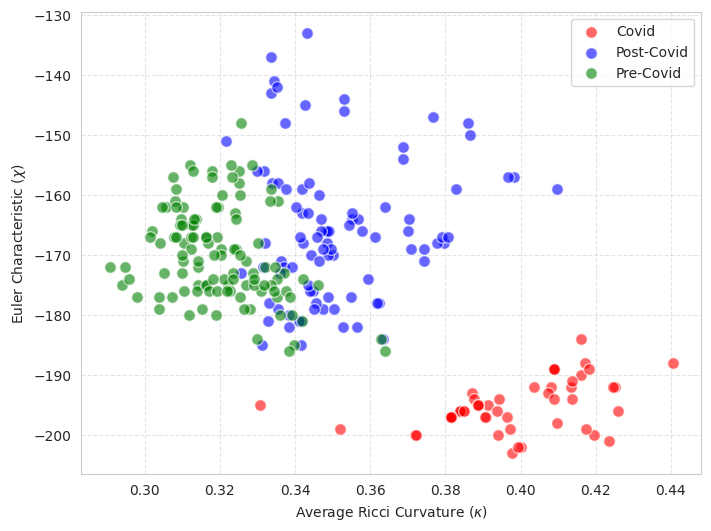

In [4]:
# Define a function to assign periods based on the date
def assign_period(date):
    if date <= pre_covid_end:
        return 'Pre-Covid'
    elif date <= covid_end:
        return 'Covid'
    else:
        return 'Post-Covid'
# Convert results to DataFrame for easy plotting
results_df = pd.DataFrame({
    'Date': dates,
    'Average_Ricci_Curvature': ricci_curvature_results,
    'Max_Eigenvalue': max_eigenvalues,
    'Euler_Characteristic': euler_characteristics
})
# Define the time boundaries for the periods
pre_covid_start = pd.Timestamp("2018-01-01")
pre_covid_end   = pd.Timestamp("2020-03-10")
covid_start     = pd.Timestamp("2020-03-11")
covid_end       = pd.Timestamp ("2021-03-11")#("2021-03-31")
post_covid_start= pd.Timestamp("2021-03-12")#("2021-04-01")
post_covid_end  = pd.Timestamp("2022-12-31")  # adjust if needed
results_df.set_index('Date', inplace=True)
# Apply the function to the DataFrame index
results_df['Period'] = results_df.index.map(assign_period)

# Define a color mapping for each period
color_map = {'Pre-Covid': 'green', 'Covid': 'red', 'Post-Covid': 'blue'}

# Create the scatter plot with color coding by period
plt.figure(figsize=(8, 6))
for period, group in results_df.groupby('Period'):
    plt.scatter(group['Average_Ricci_Curvature'], group['Euler_Characteristic'],
                c=color_map[period], label=period, alpha=0.6, edgecolors='w', s= 70)
#plt.title("Scatter Plot of Ricci Curvature vs Euler Characteristic")
plt.xlabel("Average Ricci Curvature ($\\kappa$)")
plt.ylabel("Euler Characteristic ($\\chi$)")
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


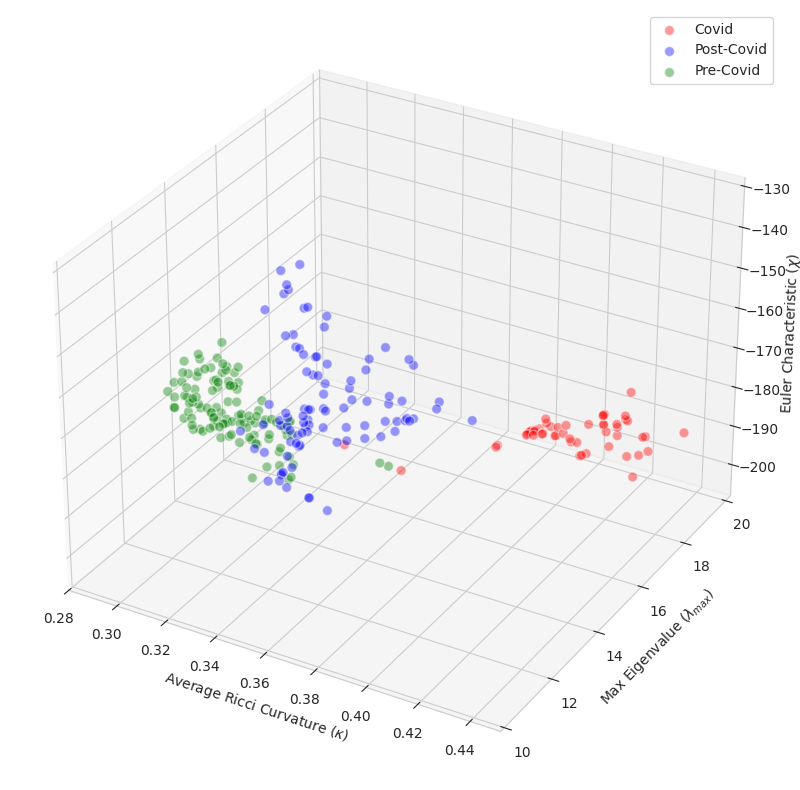

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # needed for 3D plotting in older Matplotlib versions

# Suppose your DataFrame is called results_df with the following columns:
# ['Average_Ricci_Curvature', 'Max_Eigenvalue', 'Euler_Characteristic', 'Period']

# Example Period assignment (adjust if you haven’t done so):
def assign_period(date):
    pre_covid_end   = pd.Timestamp("2020-03-11")
    covid_end       = pd.Timestamp("2021-03-11")
    if date <= pre_covid_end:
        return 'Pre-Covid'
    elif date <= covid_end:
        return 'Covid'
    else:
        return 'Post-Covid'

results_df['Period'] = results_df.index.map(assign_period)

# 3D scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Define color map for each period
color_map = {
    'Pre-Covid': 'green',
    'Covid': 'red',
    'Post-Covid': 'blue'
}

# Plot each period in a loop
for period, group in results_df.groupby('Period'):
    ax.scatter(
        group['Average_Ricci_Curvature'],
        group['Max_Eigenvalue'],
        group['Euler_Characteristic'],
        color=color_map[period],
        label=period,
        alpha=0.4,
        edgecolors='white',s=50
    )

# Set labels and title
ax.set_xlabel("Average Ricci Curvature ($\\kappa$)")
ax.set_ylabel("Max Eigenvalue ($\\lambda_{max}$)")
ax.set_zlabel("Euler Characteristic ($\\chi$)", labelpad =2.5)
#ax.set_title("3D Visualization of Global Stock Network Metrics")

# Add legend
ax.legend()

plt.tight_layout()
plt.show()

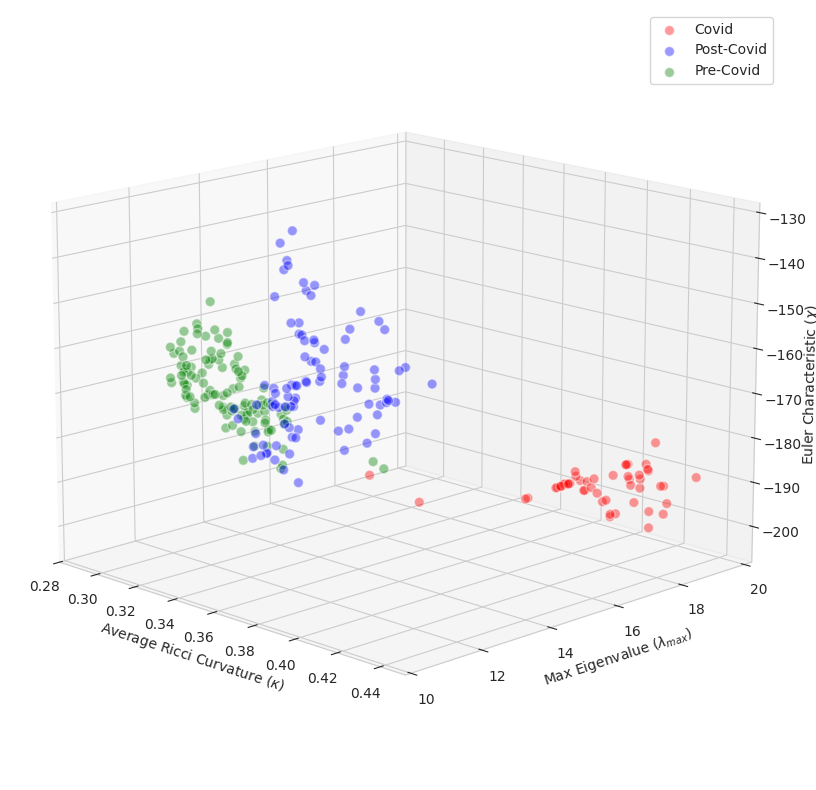

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # needed for 3D plotting in older Matplotlib versions

# Suppose your DataFrame is called results_df with the following columns:
# ['Average_Ricci_Curvature', 'Max_Eigenvalue', 'Euler_Characteristic', 'Period']

# Example Period assignment (adjust if you haven’t done so):
def assign_period(date):
    pre_covid_end   = pd.Timestamp("2020-03-11")
    covid_end       = pd.Timestamp("2021-03-11")
    if date <= pre_covid_end:
        return 'Pre-Covid'
    elif date <= covid_end:
        return 'Covid'
    else:
        return 'Post-Covid'

results_df['Period'] = results_df.index.map(assign_period)

# 3D scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Define color map for each period
color_map = {
    'Pre-Covid': 'green',
    'Covid': 'red',
    'Post-Covid': 'blue'
}

# Plot each period in a loop
for period, group in results_df.groupby('Period'):
    ax.scatter(
         group['Average_Ricci_Curvature'],
        group['Max_Eigenvalue'],
        group['Euler_Characteristic'],
        color=color_map[period],
        label=period,
        alpha=0.4,
        edgecolors='white',s=50
    )

# Set labels and title
ax.set_xlabel("Average Ricci Curvature ($\\kappa$)")
ax.set_ylabel("Max Eigenvalue ($\\lambda_{max}$)")
ax.set_zlabel("Euler Characteristic ($\\chi$)", labelpad =1.5)
#ax.view_init(elev=30, azim=45)
#ax.view_init(elev=20., azim=-45, roll=0)
ax.view_init(elev=15., azim=-45, roll=0)

#ax.set_title("3D Visualization of Global Stock Network Metrics")

# Add legend
ax.legend()

plt.tight_layout()
plt.show()






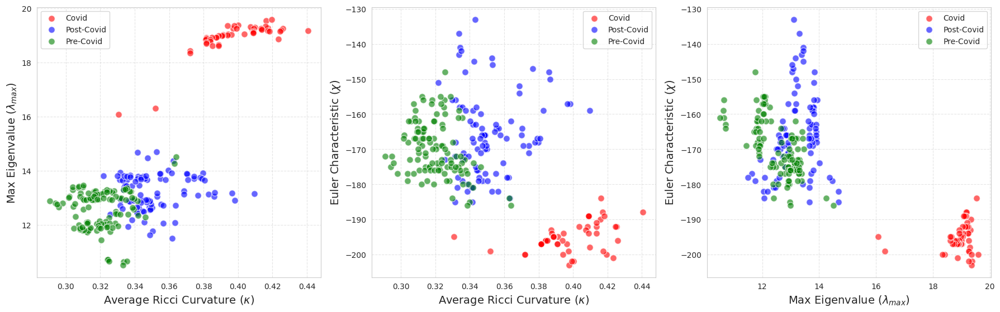

In [7]:

import pandas as pd
import matplotlib.pyplot as plt

# --- Define time boundaries for the periods ---
pre_covid_start = pd.Timestamp("2018-01-01")
pre_covid_end   = pd.Timestamp("2020-03-10")
covid_start     = pd.Timestamp("2020-03-11")
covid_end       = pd.Timestamp("2021-03-11")
post_covid_start= pd.Timestamp("2021-03-12")
post_covid_end  = pd.Timestamp("2022-12-31")  # adjust if needed

# --- Suppose these lists have been computed in your analysis ---
# For example, "dates", "ricci_curvature_results", "max_eigenvalues", "euler_characteristics"
# They must have the same length.
# (Replace these example lists with your actual computed lists.)

# --- Create DataFrame from results ---
results_df = pd.DataFrame({
    'Date': dates,
    'Average_Ricci_Curvature': ricci_curvature_results,
    'Max_Eigenvalue': max_eigenvalues,
    'Euler_Characteristic': euler_characteristics
})
results_df.set_index('Date', inplace=True)

# --- Define a function to assign periods based on the date ---
def assign_period(date):
    if date <= pre_covid_end:
        return 'Pre-Covid'
    elif date <= covid_end:
        return 'Covid'
    else:
        return 'Post-Covid'

# Apply the function to create a new column 'Period'
results_df['Period'] = results_df.index.map(assign_period)

# --- Define a color mapping for each period ---
color_map = {'Pre-Covid': 'green', 'Covid': 'red', 'Post-Covid': 'blue'}

# --- Define axis labels with LaTeX symbols ---
label_dict = {
    'Average_Ricci_Curvature': "Average Ricci Curvature ($\\kappa$)",
    'Max_Eigenvalue': "Max Eigenvalue ($\\lambda_{max}$)",
    'Euler_Characteristic': "Euler Characteristic ($\\chi$)"
}

# --- Define pairs of metrics for the scatter plots ---
pairs = [
    ('Average_Ricci_Curvature', 'Max_Eigenvalue'),
    ('Average_Ricci_Curvature', 'Euler_Characteristic'),
    ('Max_Eigenvalue', 'Euler_Characteristic')
]

# --- Create a figure with subplots (1 row x 3 columns) ---
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

for ax, (x_metric, y_metric) in zip(axs, pairs):
    # For each period, plot its data points in the current subplot
    for period, group in results_df.groupby('Period'):
        ax.scatter(group[x_metric], group[y_metric],
                   color=color_map[period],
                   label=period,
                   alpha=0.6,
                   edgecolors='w',
                   s=70)
    ax.set_xlabel(label_dict[x_metric], fontsize=14)
    ax.set_ylabel(label_dict[y_metric], fontsize=14)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.legend()

#plt.suptitle("Pairwise Scatter Plots of Annual Metrics", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()



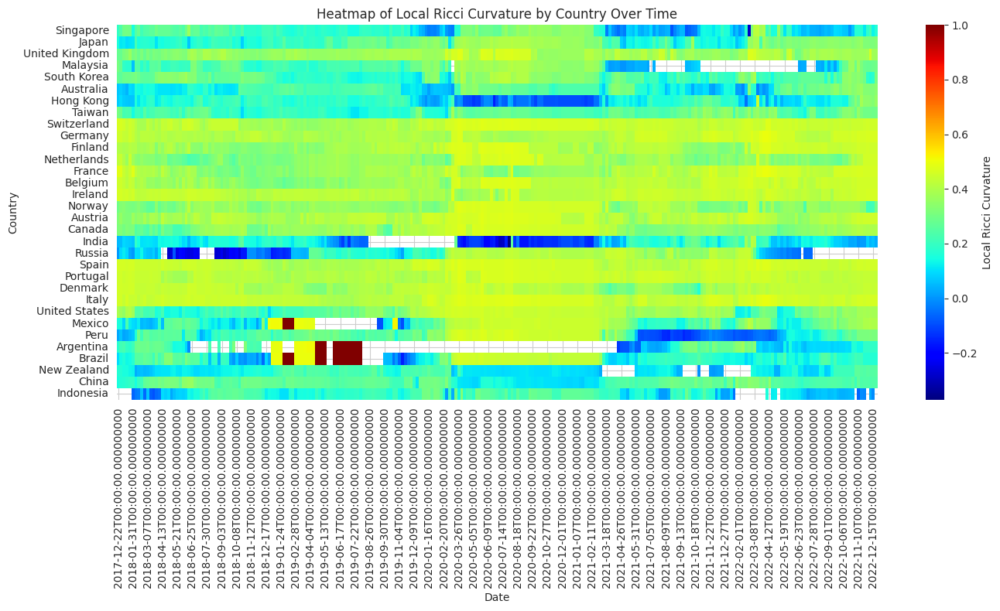

In [9]:
import pandas as pd
import numpy as np
import networkx as nx
from GraphRicciCurvature.OllivierRicci import OllivierRicci
import matplotlib.pyplot as plt
import seaborn as sns

# Load the log returns data (each column is a country)
file_path = '/content/drive/MyDrive/Paper-TDA-GlobalStockMarket/log_returns_global_stock_indices_data.xlsx'
data = pd.read_excel(file_path, index_col=0)
data.index = pd.to_datetime(data.index)

# Parameters for the sliding window
window_size = 250  # e.g., approx. 1 month if 22 trading days/month (adjust as needed)
shift = 5         # days (overlapping windows)

# We'll store a dictionary for each window: key = window end date, value = dict {country: local Ricci curvature}
local_ricci_by_window = {}

# Sliding window over the data
for start in range(0, len(data) - window_size, shift):
    end = start + window_size
    window_data = data.iloc[start:end]
    window_end_date = window_data.index[-1]

    # Compute the correlation matrix for the window
    correlation_matrix = window_data.corr()

    # Compute the average correlation (only upper triangle, excluding diagonal)
    avg_correlation = correlation_matrix.values[np.triu_indices_from(correlation_matrix, 1)].mean()

    # Build the graph: add an edge if correlation >= average correlation
    G = nx.Graph()
    for i in range(len(correlation_matrix)):
        for j in range(i + 1, len(correlation_matrix)):
            if correlation_matrix.iat[i, j] >= avg_correlation:
                # Here we add the edge; you can add weight if desired.
                G.add_edge(correlation_matrix.index[i], correlation_matrix.index[j],
                           weight=correlation_matrix.iat[i, j])

    # Initialize dictionary for local curvature in this window
    local_ricci = {}

    # Only compute Ricci curvature if the graph has edges
    if G.number_of_edges() > 0:
        orc = OllivierRicci(G, alpha=0.5, method="OTD")
        orc.compute_ricci_curvature()
        # Use the updated graph with computed edge curvatures
        G = orc.G

        # Compute local (node-level) Ricci curvature as the average of incident edge curvatures
        for node in G.nodes():
            edge_curvatures = [G[node][nbr].get('ricciCurvature', np.nan) for nbr in G[node]]
            if edge_curvatures:
                local_ricci[node] = np.nanmean(edge_curvatures)
            else:
                local_ricci[node] = np.nan
    else:
        # If no edges, assign NaN for all countries (or leave empty)
        local_ricci = {}

    # Store results for this window using the window end date as key
    local_ricci_by_window[window_end_date] = local_ricci

# Create a DataFrame from the dictionary:
# Rows: window end dates (time), Columns: countries, Values: local Ricci curvature
local_curvature_df = pd.DataFrame.from_dict(local_ricci_by_window, orient='index')
local_curvature_df.sort_index(inplace=True)

# Plot a heatmap: rows = countries, columns = time windows
plt.figure(figsize=(14, 8))
sns.heatmap(local_curvature_df.T, cmap='jet', cbar_kws={'label': 'Local Ricci Curvature'})
plt.title("Heatmap of Local Ricci Curvature by Country Over Time")
plt.xlabel("Date")
plt.ylabel("Country")
plt.tight_layout()
plt.show()
